In [1]:
import numpy as np
import logging
import sys
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['axes.formatter.useoffset'] = False
import scipy.signal as sps
from pprint import pprint

sys.path.insert(1, '/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/')
sys.path.insert(1, '/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src')
import importlib
import simulation_strategies, collapse, plotting, utils, analtyic_formulas
importlib.reload(simulation_strategies)
importlib.reload(collapse)
importlib.reload(plotting)
importlib.reload(utils)
importlib.reload(analtyic_formulas)
from simulation_strategies import *
from collapse import *
from plotting import *
from utils import *
from analtyic_formulas import *
import cProfile
import pstats

import warnings
warnings.filterwarnings('ignore', category=np.VisibleDeprecationWarning)

In [2]:
# Default plotting settings
def my_mpl():
    plt.rc('font', family='serif', size=20)
    plt.rc('axes', grid=True)
    plt.rc('lines', lw=3)
    ts = 8
    plt.rc('xtick.minor', size=ts-2)
    plt.rc('ytick.minor', size=ts-2)
    plt.rc('xtick.major', size=ts)
    plt.rc('ytick.major', size=ts)
    plt.rc('figure', figsize=[9, 5])
my_mpl()
logging.basicConfig(level=logging.DEBUG,
                    format='%(asctime)s - %(levelname)s - %(message)s')
logger = logging.getLogger(__name__)
logging.getLogger('matplotlib').setLevel(logging.ERROR)

In [3]:
t_i = 1
G = 1
rho_H = 1/(6*np.pi*G*t_i**2)
H0 = 2/(3*t_i)

def compute_r0_min(r_min, r_max, N):
    """
    Compute r0_min such that the spacing dR in np.linspace(r0_min, r_max, N)
    satisfies dR = r0_min - r_min. That is, the inner edge of the innermost shell is at r_min.
    
    Parameters:
    - r_min (float): The minimum radius.
    - r_max (float): The maximum radius.
    - N (int): Number of points.
    
    Returns:
    - float: The computed r0_min.
    """
    return (r_max + r_min * (N - 1)) / N

def make_config(no_pm=False, **kwargs):
    # Set defaults directly in kwargs
    kwargs.setdefault('r_min', 0)
    kwargs.setdefault('r_max', 1)
    kwargs.setdefault('N', 1)
    kwargs.setdefault('H', 0)
    kwargs.setdefault('rho_bar', rho_H)
    kwargs.setdefault('delta', 0)
    kwargs.setdefault('j_coef', 0)
    kwargs.setdefault('r_min_strategy', 'nothing')
    kwargs.setdefault('t_max', 5000)
    kwargs.setdefault('dt_min', 0)
    kwargs.setdefault('stepper_strategy', 'leapfrog_kdk')
    kwargs.setdefault('timescale_strategy', 'dyn')
    kwargs.setdefault('save_strategy', 'vflip')
    kwargs.setdefault('safety_factor', 1e-2)
    kwargs.setdefault('save_dt', 1e-2)
    kwargs.setdefault('initial_radius_strategy', 'r0min_start_equal')
    kwargs.setdefault('m_enc_strategy', 'inclusive')
    kwargs.setdefault('density_strategy', 'background_plus_tophat2')
    kwargs.setdefault('timestep_strategy', 'simple_adaptive')
    kwargs.setdefault('problematic_shell_strategy', 'energy')
    kwargs.setdefault('energy_strategy', 'kin_grav_rot_absorbed')
    
    # Set r_th default after r_max is set
    kwargs.setdefault('tophat_radius', kwargs['r_max'])

    # Extract values for computation
    r_min = kwargs['r_min']
    r_max = kwargs['r_max']
    N = kwargs['N']
    rho_bar = kwargs['rho_bar']
    delta_i = kwargs['delta']
    r_th = kwargs['tophat_radius']
    j_coeff = kwargs['j_coef']
    reflect_bool = kwargs['r_min_strategy'] == 'reflect'

    # m_pert = rho_bar * delta_i * 4/3 * np.pi * min(r_max, r_th)**3
    # if no_pm:
    #     point_mass = 0
    #     shell_volume_strategy = 'keep_edges'
    # else:
    #     point_mass = 4/3 * np.pi * r_min**3 * rho_bar * (1+delta_i)
    #     shell_volume_strategy = 'inner_not_zero'

    r0_min = compute_r0_min(r_min=r_min, r_max=r_max, N=N)
    r_min_strategy = 'reflect' if reflect_bool else 'nothing'
    t_ta_strategy = 't_ta_cycloid'
    r_ta_strategy = 'r_ta_cycloid'
    #ang_mom_strategy = 'const' if j_coeff > 0 else 'zero'

    # Start with all user-supplied kwargs (now with defaults), then update/override with computed values
    config = dict(kwargs)
    config.update({
        'r0_min': r0_min,
        'r_min_strategy': r_min_strategy,
        't_ta_strategy': t_ta_strategy,
        'r_ta_strategy': r_ta_strategy,
    })
    return config

def run_sc(config, profile=False, plot=True):
    sc = SphericalCollapse(config)
    if profile:
        # Profile the run method
        profiler = cProfile.Profile()
        profiler.enable()
        results = sc.run()
        profiler.disable()
        # Print the profiling results
        stats = pstats.Stats(profiler).sort_stats('cumulative')
        stats.print_stats(50)  # Print top 50 time-consuming functions
    else:
        results = sc.run()
    if not plot:
        return sc, results, None
    plotter = SimulationPlotter(results, sc)
    plotter.plot_radius_analysis()
    plotter.plot_mass_density_timescales()
    return sc, results, plotter

In [4]:
def find_turnaround_indices(results):
    r_data = results['r']
    
    # Find turnaround indices for each shell
    ta_indices = []
    for i in range(r_data.shape[1]):
        # Find indices of local maxima for this shell
        maxima_indices = argrelmax(r_data[:, i])[0]
        # If maxima found, use the first one; otherwise use None
        ta_idx = maxima_indices[0] if len(maxima_indices) > 0 else None
        ta_indices.append(ta_idx)
    
    # Process shells that have turnaround points
    valid_shells = [i for i in range(r_data.shape[1]) if ta_indices[i] is not None]
    
    if valid_shells:
        # Calculate r_ta and t_ta only for shells with turnaround points
        r_ta = np.zeros(r_data.shape[1])
        t_ta = np.zeros(r_data.shape[1])
        
        for i in valid_shells:
            r_ta[i] = r_data[ta_indices[i], i]
            t_ta[i] = results['t'][ta_indices[i]]
        r_normalized = np.zeros_like(r_data)
        for i in valid_shells:
            r_normalized[:, i] = r_data[:, i] / r_ta[i]
    return r_ta, t_ta, r_normalized

def plot_results(results, sc, params=None):
    r_ta, t_ta, r_normalized = find_turnaround_indices(results)

    tvals = results['t']
    rvals = results['r']
    mvals = results['m'][0,:]
    mvals_w_point_mass = mvals.copy()
    if sc is not None:
        N = sc.N
        mvals_w_point_mass[0] += sc.point_mass
    else:
        N = params['N']
        mvals_w_point_mass += params['point_mass']
    mencvals = results['m_enc']
    #volvals = 4/3 * np.pi * np.array([np.diff(np.array([0, *rvals[i,:]]))**3 for i in range(len(rvals))])
    rhovals = results['rho_r']

    rho0 = results['rho_r'][0,:]
    #vol0 = volvals[0,:]
    rvals0 = rvals[0,:]
    menc0 = mencvals[0,:]

    upper_bounds = rvals0
    if sc is not None:
        lower_bounds = np.array([sc.r_min, *rvals0[:-1]])
    else:
        lower_bounds = np.array([params['r_min'], *rvals0[:-1]])
    volumes = 4/3 * np.pi * (upper_bounds**3 - lower_bounds**3)

    cmap = plt.cm.viridis
    norm = mpl.colors.Normalize(vmin=0, vmax=N-1)  # assuming i goes from 0 to 999

    #plt.plot(rvals0, rho0/rho_H, label='initial profile')
    #plt.plot(rvals0, 1/rho_H * mvals_w_point_mass/vol0, label='initial mass density')
    plt.plot(rvals0, mvals/(rho_H * volumes), label='initial mass density')
    plt.xlabel('r')
    plt.ylabel(r'$\rho/\rho_H$')
    plt.yscale('log')
    plt.xscale('log')
    plt.legend()

    plt.figure()
    plt.plot(rvals0, menc0, label='initial enclosed mass')
    plt.xlabel('r')
    plt.ylabel(r'$M_{enc}$')
    plt.yscale('log')
    plt.xscale('log')
    plt.legend()

    plt.figure()
    for i in range(N):
        color = cmap(norm(i))
        plt.plot(tvals, rvals[:,i], alpha=0.2, color=color, lw=1)

    plt.figure()
    for i in range(N):
        color = cmap(norm(i))
        plt.semilogy(tvals, rvals[:,i], alpha=0.2, color=color, lw=1)

    plt.figure()
    print(tvals.shape, t_ta.shape)
    for i in range(N):
        color = cmap(norm(i))
        plt.plot((tvals+1)/t_ta[i], r_normalized[:,i], alpha=0.2, color=color, lw=1)

    # 1. Create a grid of normalized time values
    max_ta = (tvals[-1]+1)/np.min(t_ta)
    n_points = int(20*(tvals[-1]+1)/np.min(t_ta))
    norm_time_grid = np.linspace(
        0, 
        max_ta, 
        n_points
    )

    mean_r = np.empty(n_points)
    std_r = np.empty(n_points)
    median_r = np.empty(n_points)

    for j, norm_time in enumerate(norm_time_grid):
        r_values_at_time = []
        for i in range(r_normalized.shape[1]):
            shell_norm_time = (tvals + 1) / t_ta[i]
            # Only interpolate if norm_time is within the shell's time range
            if norm_time >= shell_norm_time[0] and norm_time <= shell_norm_time[-1]:
                r_val = np.interp(norm_time, shell_norm_time, r_normalized[:, i])
                r_values_at_time.append(r_val)
        if r_values_at_time:
            mean_r[j] = np.mean(r_values_at_time)
            std_r[j] = np.std(r_values_at_time)
            median_r[j] = np.median(r_values_at_time)
        else:
            mean_r[j] = np.nan
            std_r[j] = np.nan

    # 2. Plot, skipping nan values
    valid = ~np.isnan(mean_r)
    plt.plot(norm_time_grid[valid], mean_r[valid], color='black', label='Mean', ls='--', lw=2)
    plt.plot(norm_time_grid[valid], median_r[valid], color='black', label='Median', ls=':', lw=2)
    plt.plot(norm_time_grid[valid], mean_r[valid] - std_r[valid], color='red', label='1$\sigma$ band', ls=':')
    plt.plot(norm_time_grid[valid], mean_r[valid] + std_r[valid], color='red', ls=':')
    plt.legend()
    plt.ylim(0, 1.2)
    custom_yticks = [0, 0.2, 0.4, 0.6, 0.8, 1, 1.2]
    plt.yticks(custom_yticks)
    #plt.xlim(0, 40)

    plt.figure()
    plt.plot(norm_time_grid[valid], std_r[valid]/mean_r[valid], color='black', label=r'$\sigma$/mean', ls='-', lw=2)
    plt.yscale('log')
    plt.legend()

    num_divisions = 5
    for i in range(num_divisions):
        tval = tvals[-1]/num_divisions * (i+1)
        idx = np.argmin(np.abs(tvals - tval))
        rho = results['rho_r'][idx,:]
        rval = rvals[idx,:]
        menc = mencvals[idx,:]


        sorted_indices = np.argsort(rval)
        rval = rval[sorted_indices]
        rho = rho[sorted_indices]
        menc = menc[sorted_indices]
        mvals = mvals[sorted_indices]
        upper_bounds = rval
        lower_bounds = np.array([1, *rval[:-1]])
        vol = 4/3 * np.pi * (upper_bounds**3 - lower_bounds**3)
        
        plt.figure()
        
        plt.plot(rval[1:], mvals[1:]/(rho_H * (tval+1)**-2 * vol[1:]), label=f't={int(tval)}')
        plt.xlabel('r')
        plt.ylabel(r'$\rho/\rho_H$')
        plt.yscale('log')
        plt.xscale('log')
        plt.legend()

        plt.figure()
        plt.plot(rval, menc, label=f't={int(tval)}')
        plt.xlabel('r')
        plt.ylabel(r'$M_{enc}$')
        plt.yscale('log')
        plt.xscale('log')
        plt.legend()

In [9]:
r_max = 1
j_coef = 1e-2
N = 1
t_max = 100
safety_factor = 1e-2
save_dt = 1
delta = 1e-2
irs = 'equal_mass'#'r0min_start_equal'
ivs = 'hubble'
density_strategy = 'background_plus_power_law'
accel_strategy = 'soft_all' #'grant_gmr_j_at_r_ta_soft'
softlen = 0
ang_mom_strategy = 'const'
problematic_shell_strategy = 'nothing'

tss = 'dyn'
# mes = 'const_inclusive'
r_min = 1
gamma = -2.5

In [ ]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='levi_civita_leapfrog',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='runs/729-1.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy)
sc, results, plotter = run_sc(config, profile=False, plot=True)

/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src/simulation_strategies.py:519: RuntimeWarning: invalid value encountered in true_divide
  return sim.m / volumes
2025-07-29 19:40:05,983 - collapse - INFO - Simulation setup complete


{'G': 1,
 'H': 0.6666666666666666,
 'N': 1,
 'accel_strategy': 'soft_all',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.0,
 'r_max': 1,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.1,
 'save_dt': 1,
 'save_filename': 'runs/729-1.h5',
 'save_strategy

In [ ]:
plt.plot(rvals, )

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:31: RuntimeWarning: overflow encountered in double_scalars
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:16: RuntimeWarning: overflow encountered in power
  app.launch_new_instance()
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:16: RuntimeWarning: invalid value encountered in add
  app.launch_new_instance()
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:25: RuntimeWarning: invalid value encountered in multiply
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: invalid value encountered in multiply
  if sys.path[0] == '':
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:16: RuntimeWarning: overflow encountered in multiply
  app.launch_new_instance()


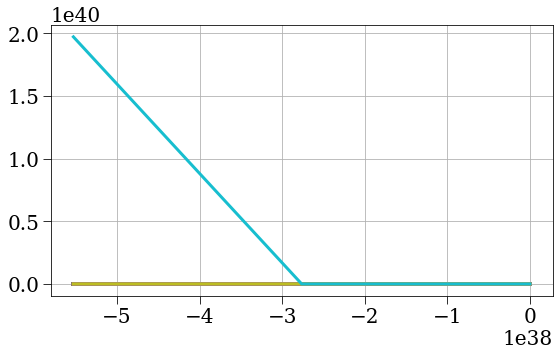

In [23]:
import numpy as np

def step_leapfrog_many(r, v, m, ℓ, Δs):
    N = len(r)
    # 1. find interior masses for old radii
    order = np.argsort(r)
    cum_mass = np.cumsum(m[order])
    M_int = np.zeros(N)
    M_int[order] = np.concatenate(([0.], cum_mass[:-1]))

    # 2. half‐kick
    a_half = -G * M_int * r + ℓ**2
    v_half = v + 0.5 * a_half * Δs

    # 3. drift
    r_new = r + v_half * r**3 * Δs

    # 4. interior masses for new radii
    order_new = np.argsort(r_new)
    cum_mass_new = np.cumsum(m[order_new])
    M_int_new = np.zeros(N)
    M_int_new[order_new] = np.concatenate(([0.], cum_mass_new[:-1]))

    # 5. second half‐kick
    a_half_new = -G * M_int_new * r_new + ℓ**2
    v_new = v_half + 0.5 * a_half_new * Δs

    # 6. update physical time via the innermost shell
    rmin_old = r.min()
    rmin_new = r_new.min()
    Δt = 0.5*(rmin_old**3 + rmin_new**3) * Δs

    return r_new, v_new, Δt

# -- usage --
G = 1.0
N = 100
m = np.ones(N)/N            # equal‐mass shells
ℓ = 0.01
r = np.linspace(1, 2, N)    # initial radii
v = 2/3 * r
t = 0.0
Δs = 1e-4

rvals = []
vvals = []
tvals = []
for step in range(100_000):
    r, v, dt = step_leapfrog_many(r, v, m, ℓ, Δs)
    t += dt
    rvals.append(r)
    vvals.append(v)
    tvals.append(t)

plt.plot(tvals, rvals);


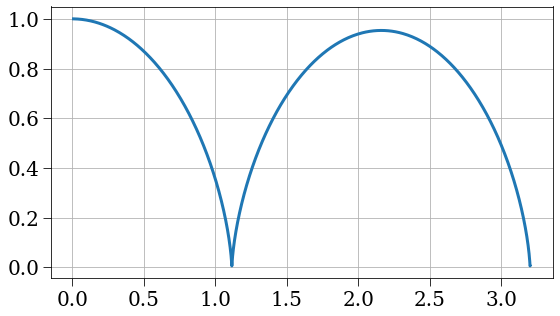

In [18]:
import numpy as np

def step_leapfrog_s(r, v, Δs, GM, ℓ):
    # Half‐kick in v
    dv_ds = -GM*r + ℓ**2
    v_half = v + 0.5 * dv_ds * Δs

    # Drift in r
    r_new = r + v_half * r**3 * Δs

    # Another half‐kick in v (at r_new)
    dv_ds_new = -GM*r_new + ℓ**2
    v_new = v_half + 0.5 * dv_ds_new * Δs

    # Update physical time t via trapezoid rule
    Δt = 0.5*(r**3 + r_new**3) * Δs

    return r_new, v_new, Δt

# ---- main integration loop ----
GM = 1.0      # units where GM=1
ℓ  = 0.1      # your chosen shell angular momentum
Δs = 1e-2     # small fixed step in s

# initial conditions
r = 1.0
v = 0.0
t = 0.0

rvals = []
vvals = []
tvals = []
for i in range(1_000_000):
    r, v, dt = step_leapfrog_s(r, v, Δs, GM, ℓ)
    t += dt
    rvals.append(r)
    vvals.append(v)
    tvals.append(t)

# trajectory now holds (t, r, v) sampled in physical time
plt.plot(tvals, rvals)

In [12]:
trajectory.

AttributeError: 'list' object has no attribute 'shape'

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_all',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.0005,
 'r_max': 1.5,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': 'runs/727-1.h5',
 'save

2025-07-27 19:45:53,686 - collapse - INFO - Simulation setup complete


2025-07-27 20:27:14,466 - DEBUG - Saved dataset t with shape (970,)
2025-07-27 20:27:14,468 - DEBUG - Saved dataset dt with shape (970,)
2025-07-27 20:27:14,515 - DEBUG - Saved dataset r with shape (970, 1000)
2025-07-27 20:27:14,531 - DEBUG - Saved dataset v with shape (970, 1000)
2025-07-27 20:27:14,559 - DEBUG - Saved dataset a with shape (970, 1000)
2025-07-27 20:27:14,585 - DEBUG - Saved dataset m_enc with shape (970, 1000)
2025-07-27 20:27:14,610 - DEBUG - Saved dataset rho_r with shape (970, 1000)
2025-07-27 20:27:14,611 - WARNING - Skipping pressure because all values are None
2025-07-27 20:27:14,612 - WARNING - Skipping dpressure_drho because all values are None
2025-07-27 20:27:14,613 - WARNING - Skipping rho_prime because all values are None


2025-07-27 20:27:14,635 - DEBUG - Saved dataset e_tot with shape (970, 1000)
2025-07-27 20:27:14,658 - DEBUG - Saved dataset e_g with shape (970, 1000)
2025-07-27 20:27:14,684 - DEBUG - Saved dataset e_k with shape (970, 1000)
2025-07-27 20:27:14,704 - DEBUG - Saved dataset e_r with shape (970, 1000)
2025-07-27 20:27:14,705 - WARNING - Skipping e_p because all values are None
2025-07-27 20:27:14,706 - WARNING - Skipping e_q because all values are None
2025-07-27 20:27:14,708 - DEBUG - Saved dataset t_dyn with shape (970,)
2025-07-27 20:27:14,717 - DEBUG - Saved dataset t_vel with shape (970,)
2025-07-27 20:27:14,719 - DEBUG - Saved dataset t_acc with shape (970,)
2025-07-27 20:27:14,720 - WARNING - Skipping t_cross because all values are None
2025-07-27 20:27:14,721 - WARNING - Skipping t_crossa because all values are None
2025-07-27 20:27:14,722 - WARNING - Skipping t_cross2 because all values are None
2025-07-27 20:27:14,723 - WARNING - Skipping t_zero because all values are None
202

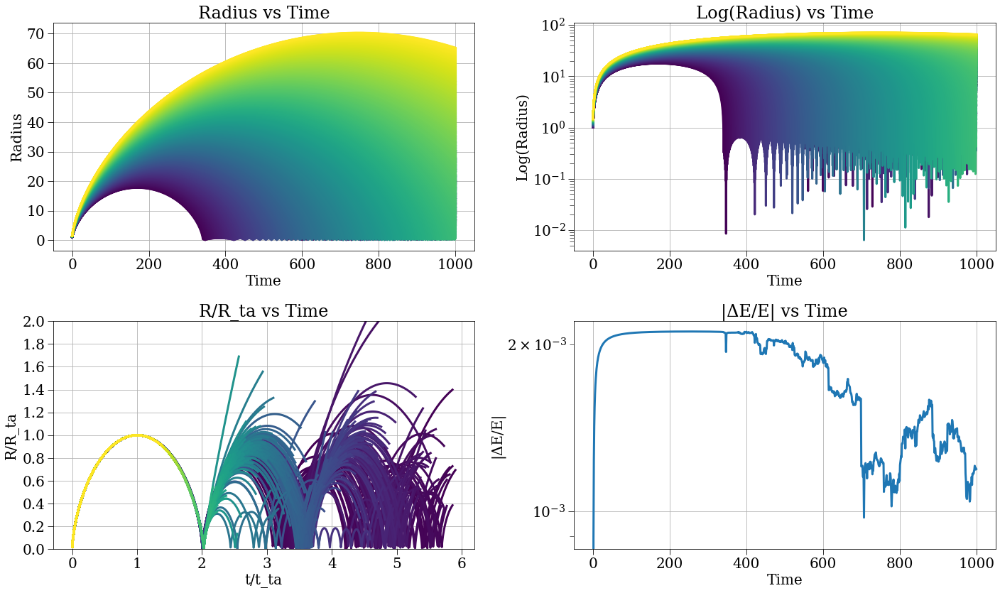

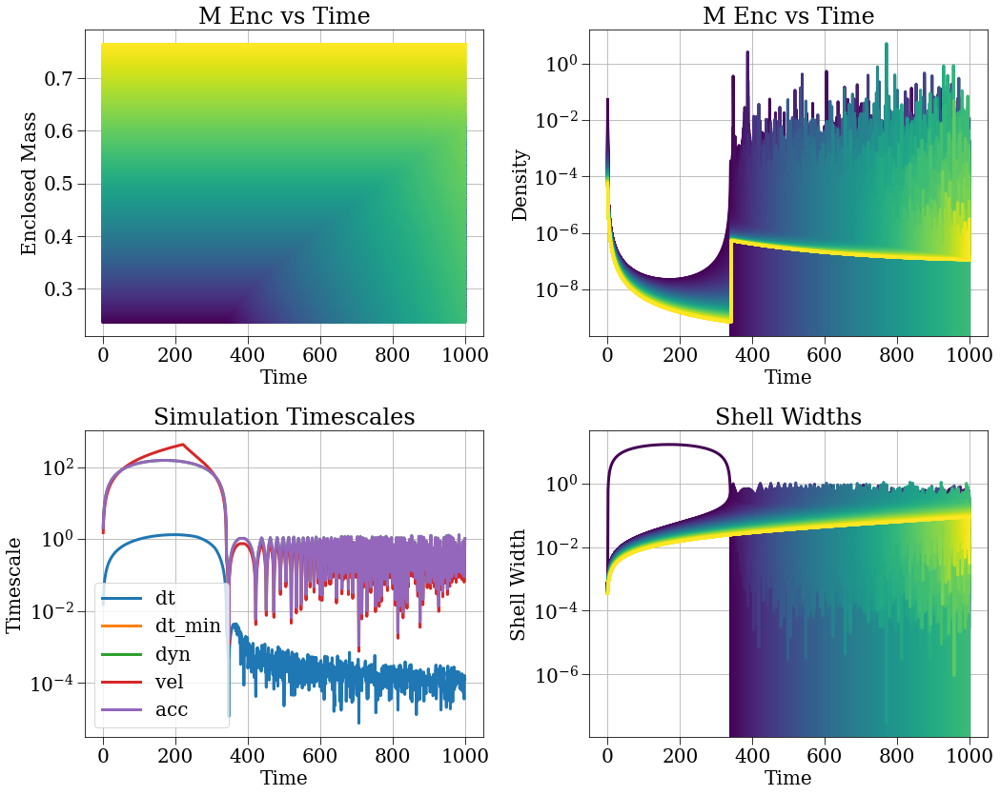

In [16]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='runs/727-1.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -1,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.7,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'nothing',
 'r0_min': 1.006,
 'r_max': 7,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': 'runs/725-1.h5

2025-07-25 17:11:55,279 - collapse - INFO - Simulation setup complete


2025-07-25 17:12:00,245 - DEBUG - Saved dataset t with shape (8405,)
2025-07-25 17:12:00,247 - DEBUG - Saved dataset dt with shape (8405,)
2025-07-25 17:12:00,346 - DEBUG - Saved dataset r with shape (8405, 1000)


2025-07-25 17:12:00,519 - DEBUG - Saved dataset v with shape (8405, 1000)
2025-07-25 17:12:00,993 - DEBUG - Saved dataset a with shape (8405, 1000)
2025-07-25 17:12:01,183 - DEBUG - Saved dataset m_enc with shape (8405, 1000)
2025-07-25 17:12:01,383 - DEBUG - Saved dataset rho_r with shape (8405, 1000)
2025-07-25 17:12:01,385 - WARNING - Skipping pressure because all values are None
2025-07-25 17:12:01,386 - WARNING - Skipping dpressure_drho because all values are None
2025-07-25 17:12:01,388 - WARNING - Skipping rho_prime because all values are None
2025-07-25 17:12:01,539 - DEBUG - Saved dataset e_tot with shape (8405, 1000)
2025-07-25 17:12:01,746 - DEBUG - Saved dataset e_g with shape (8405, 1000)
2025-07-25 17:12:01,942 - DEBUG - Saved dataset e_k with shape (8405, 1000)
2025-07-25 17:12:02,101 - DEBUG - Saved dataset e_r with shape (8405, 1000)
2025-07-25 17:12:02,102 - WARNING - Skipping e_p because all values are None
2025-07-25 17:12:02,103 - WARNING - Skipping e_q because all

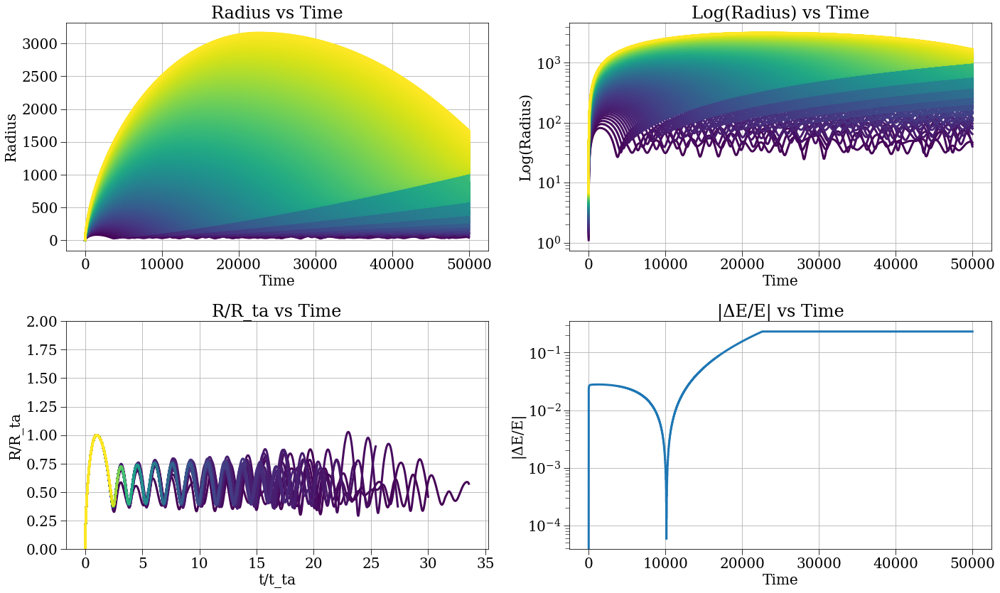

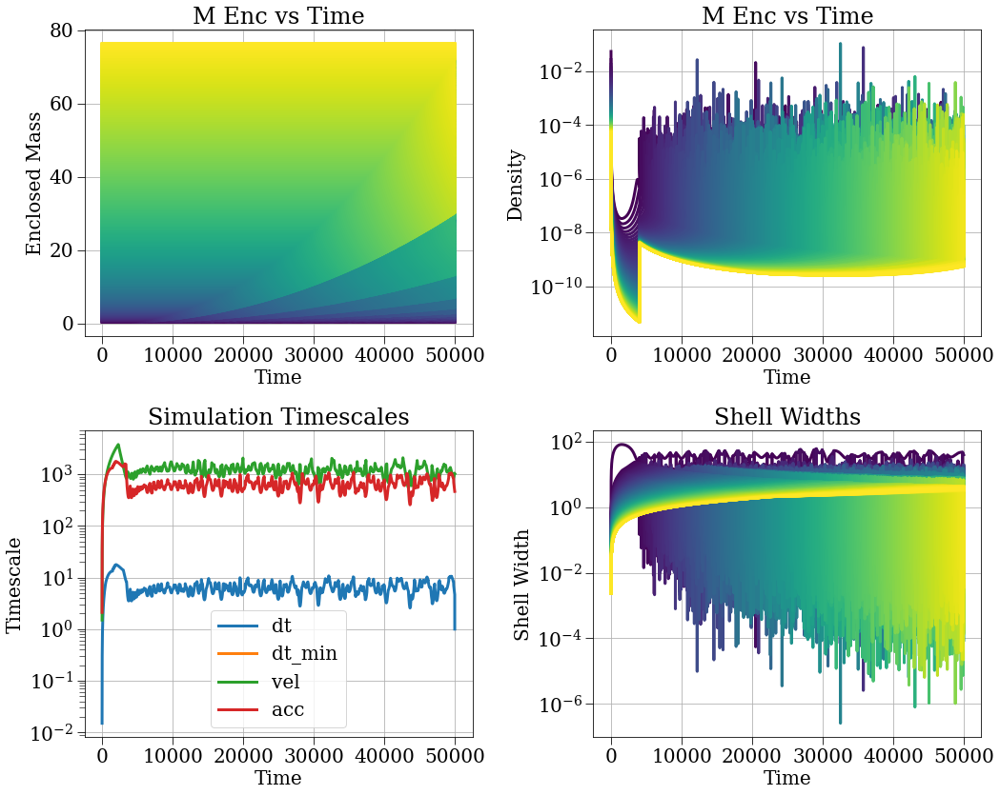

In [28]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='runs/725-1.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy)
sc, results, plotter = run_sc(config, profile=False, plot=True)

In [ ]:
plot_results(results, sc)

(8405,) (1000,)


In [ ]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='runs/724-3.h5', r_small=1, softlen=softlen, problematic_shell_strategy=problematic_shell_strategy)
sc, results, plotter = run_sc(config, profile=False, plot=True)

2025-07-24 16:44:45,592 - collapse - INFO - Simulation setup complete


{'G': 1,
 'H': 0.6666666666666666,
 'N': 1,
 'accel_strategy': 'soft_new',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.0,
 'r_max': 1,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': 'runs/724-3.h5',
 'save_strategy'

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft_all',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.7,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 0.1019,
 'r_max': 2,
 'r_min': 0.1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 0.1,
 'save_filename': 'run

2025-07-24 12:49:41,303 - collapse - INFO - Simulation setup complete


2025-07-24 12:57:13,983 - DEBUG - Saved dataset t with shape (40001,)
2025-07-24 12:57:13,987 - DEBUG - Saved dataset dt with shape (40001,)
2025-07-24 12:57:14,538 - DEBUG - Saved dataset r with shape (40001, 1000)
2025-07-24 12:57:15,448 - DEBUG - Saved dataset v with shape (40001, 1000)
2025-07-24 12:57:16,349 - DEBUG - Saved dataset a with shape (40001, 1000)
2025-07-24 12:57:17,235 - DEBUG - Saved dataset m_enc with shape (40001, 1000)
2025-07-24 12:57:18,130 - DEBUG - Saved dataset rho_r with shape (40001, 1000)
2025-07-24 12:57:18,133 - WARNING - Skipping pressure because all values are None
2025-07-24 12:57:18,136 - WARNING - Skipping dpressure_drho because all values are None
2025-07-24 12:57:18,139 - WARNING - Skipping rho_prime because all values are None
2025-07-24 12:57:19,025 - DEBUG - Saved dataset e_tot with shape (40001, 1000)
2025-07-24 12:57:19,926 - DEBUG - Saved dataset e_g with shape (40001, 1000)
2025-07-24 12:57:20,833 - DEBUG - Saved dataset e_k with shape (400

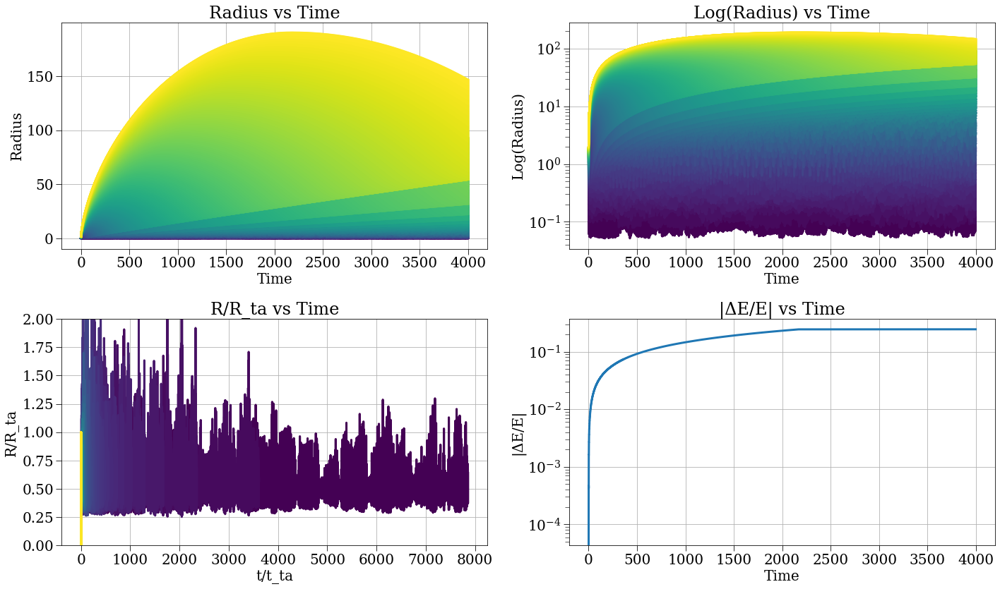

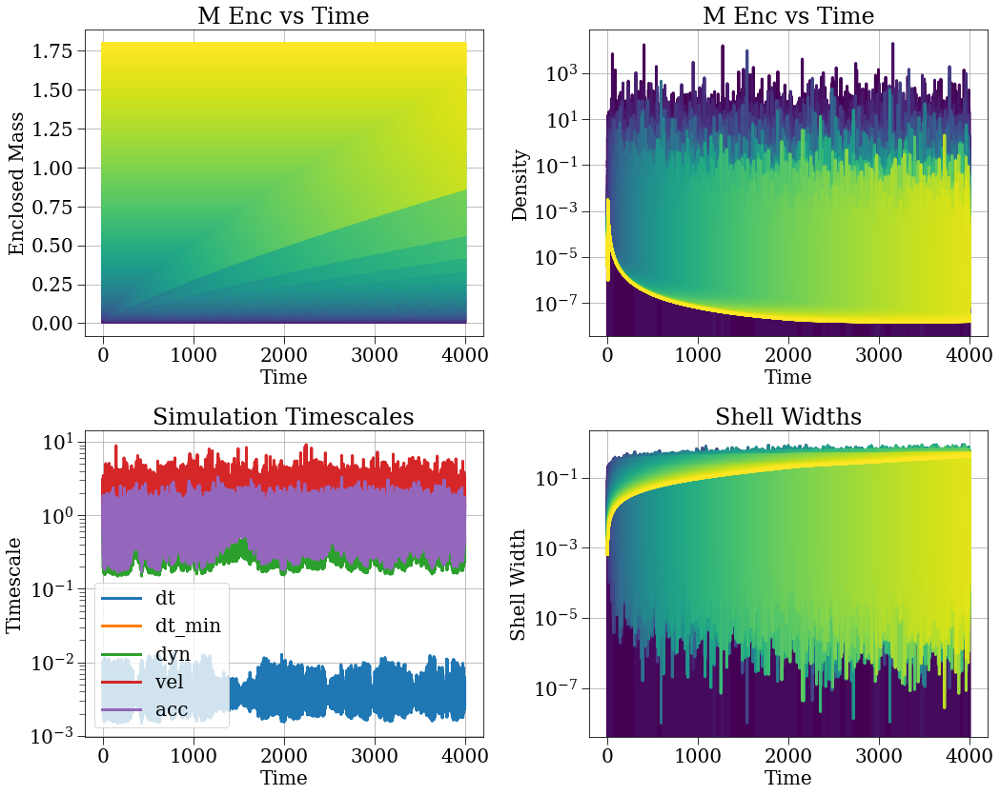

In [25]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='runs/724-2.h5', r_small=1)
sc, results, plotter = run_sc(config, profile=False, plot=True)

In [23]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='runs/724-1.h5', r_small=1)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 10000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft_all',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.7,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.0001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': 'runs/7

2025-07-24 12:35:16,837 - collapse - INFO - Simulation setup complete


2025-07-24 12:35:52,702 - DEBUG - Saved dataset t with shape (3939,)
2025-07-24 12:35:52,704 - DEBUG - Saved dataset dt with shape (3939,)


2025-07-24 12:35:53,701 - DEBUG - Saved dataset r with shape (3939, 10000)
2025-07-24 12:35:54,125 - DEBUG - Saved dataset v with shape (3939, 10000)
2025-07-24 12:35:55,056 - DEBUG - Saved dataset a with shape (3939, 10000)
2025-07-24 12:35:56,079 - DEBUG - Saved dataset m_enc with shape (3939, 10000)
2025-07-24 12:35:57,005 - DEBUG - Saved dataset rho_r with shape (3939, 10000)
2025-07-24 12:35:57,007 - WARNING - Skipping pressure because all values are None
2025-07-24 12:35:57,008 - WARNING - Skipping dpressure_drho because all values are None
2025-07-24 12:35:57,009 - WARNING - Skipping rho_prime because all values are None
2025-07-24 12:35:58,029 - DEBUG - Saved dataset e_tot with shape (3939, 10000)
2025-07-24 12:35:59,076 - DEBUG - Saved dataset e_g with shape (3939, 10000)
2025-07-24 12:36:00,081 - DEBUG - Saved dataset e_k with shape (3939, 10000)
2025-07-24 12:36:01,005 - DEBUG - Saved dataset e_r with shape (3939, 10000)
2025-07-24 12:36:01,007 - WARNING - Skipping e_p becau

KeyboardInterrupt: 

(40001,) (1000,)


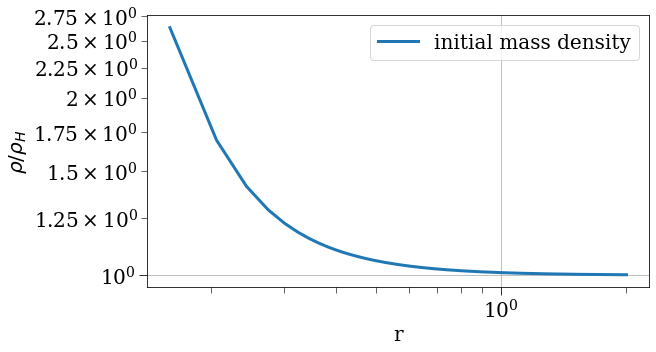

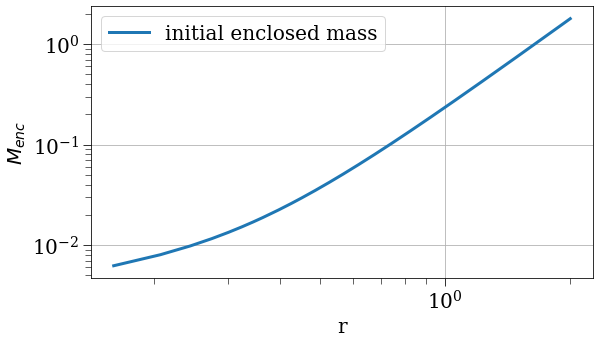

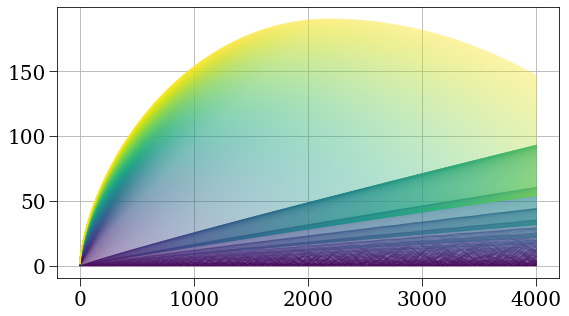

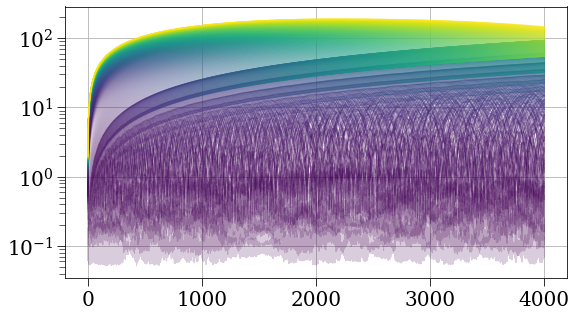

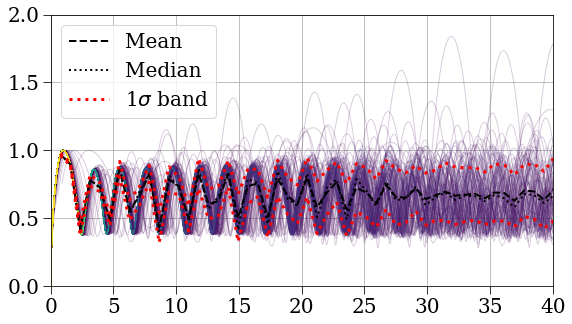

...

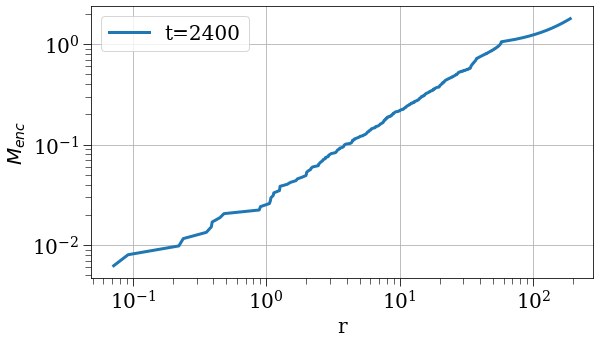

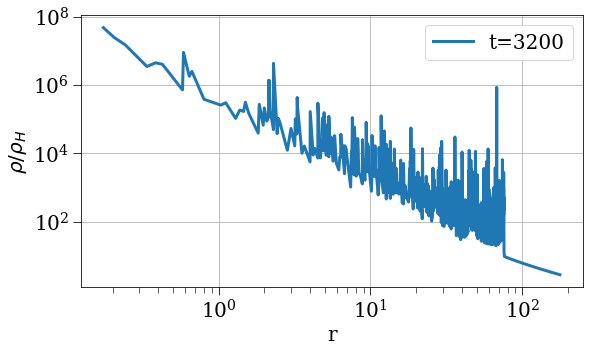

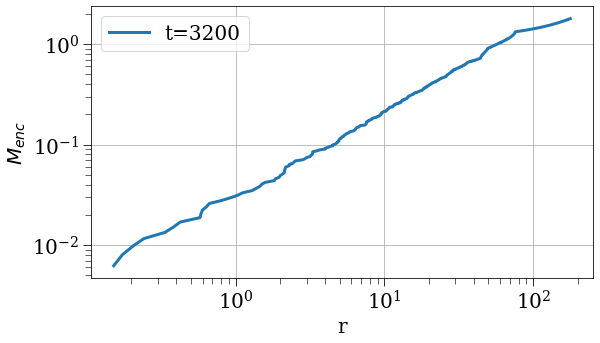

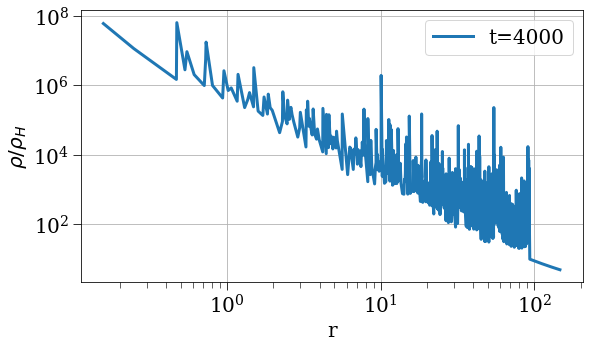

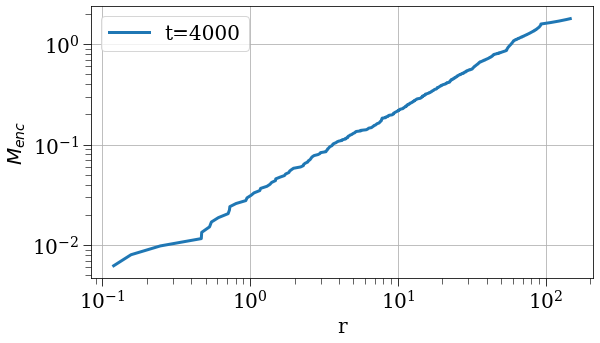

In [28]:
plot_results(results, sc=sc)

(39999,) (100,)


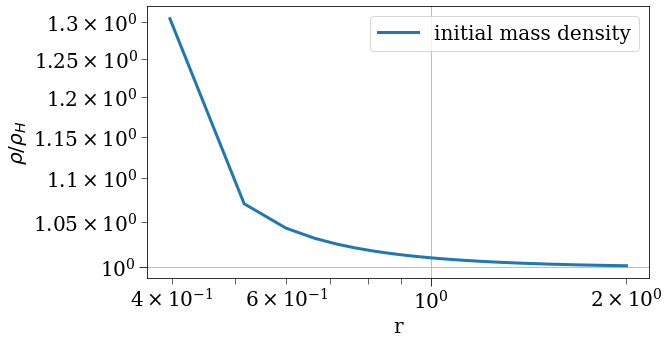

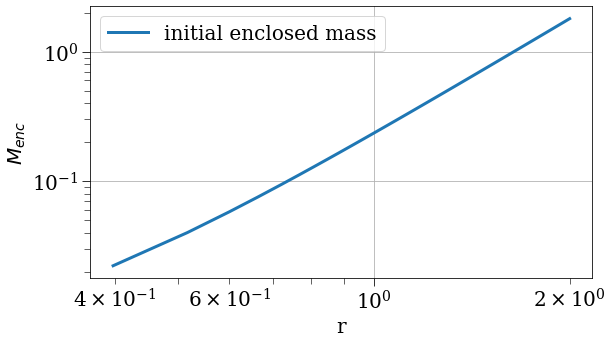

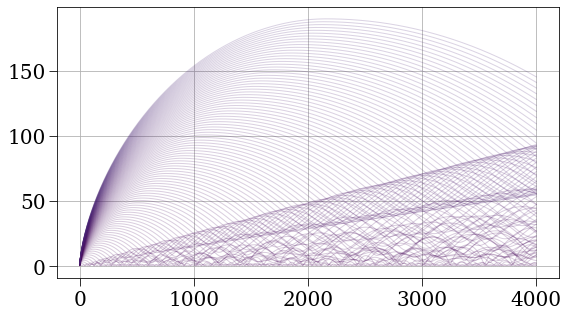

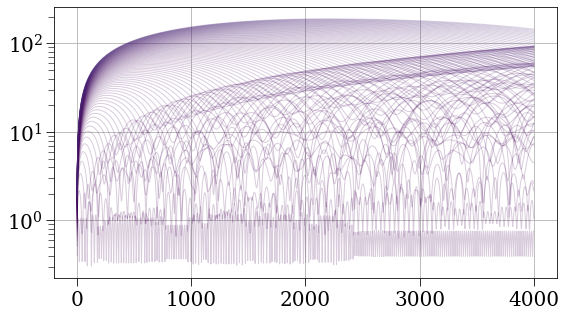

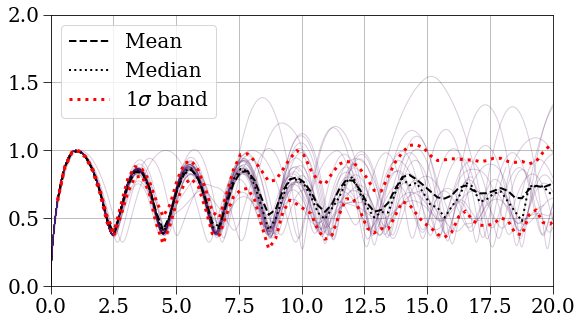

...

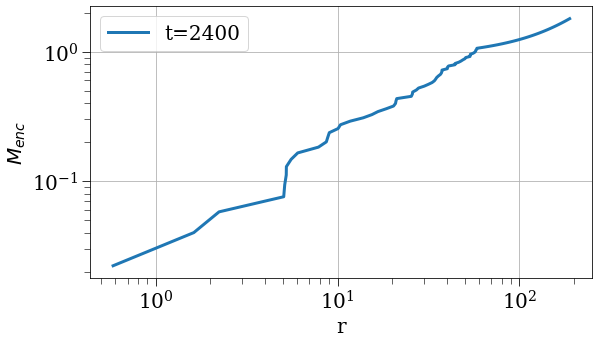

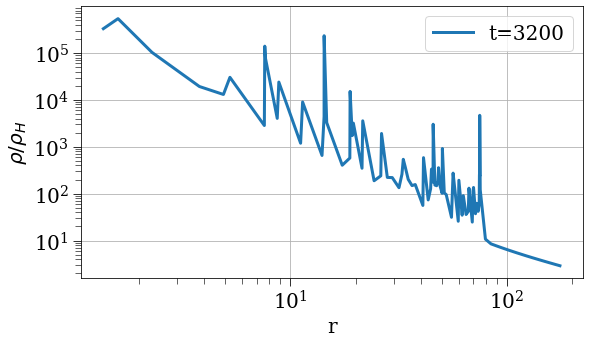

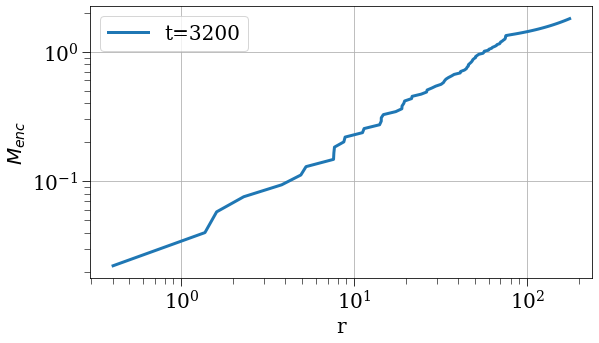

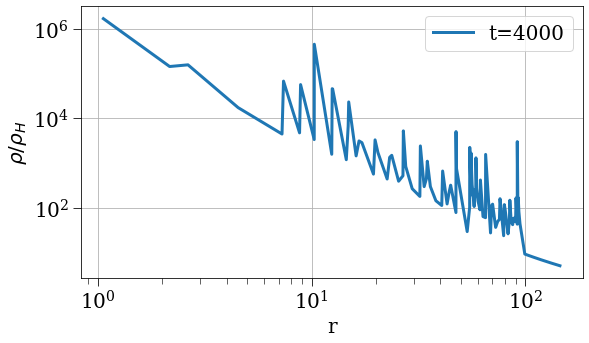

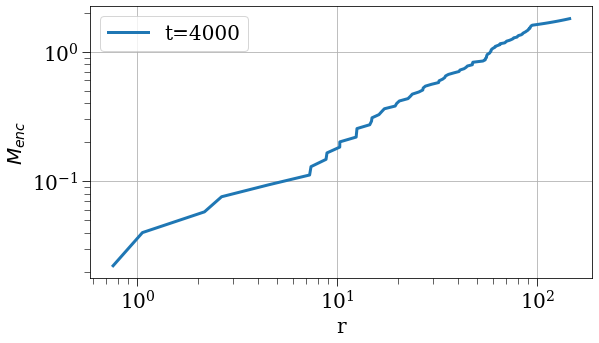

In [23]:
plot_results(results, sc=sc)

(32597,) (100,)


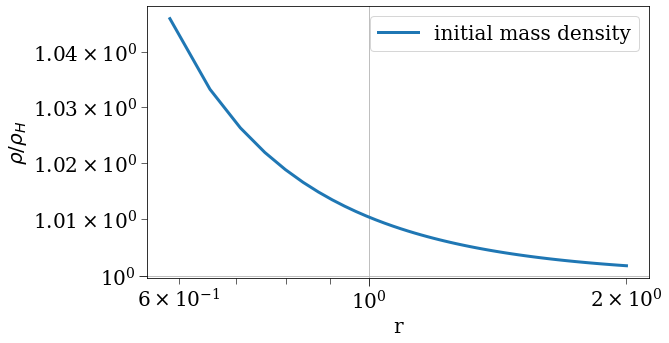

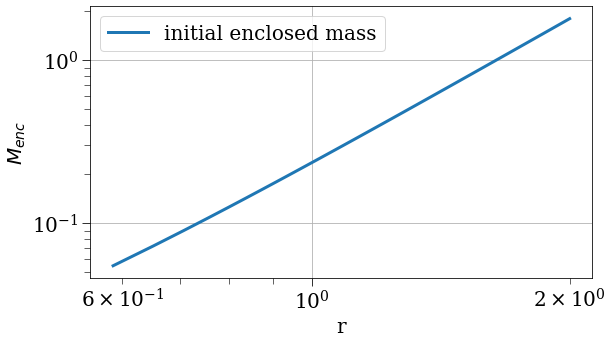

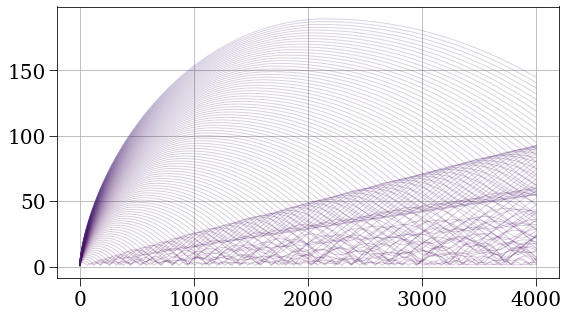

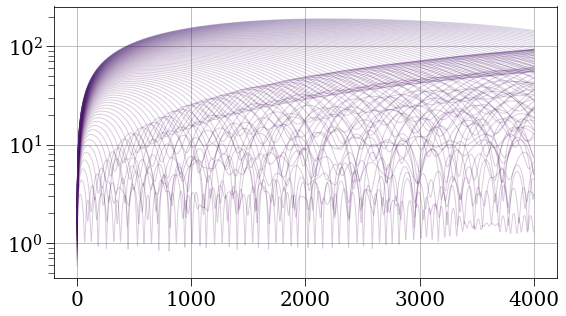

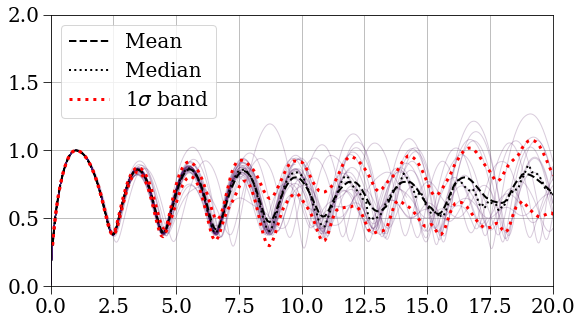

...

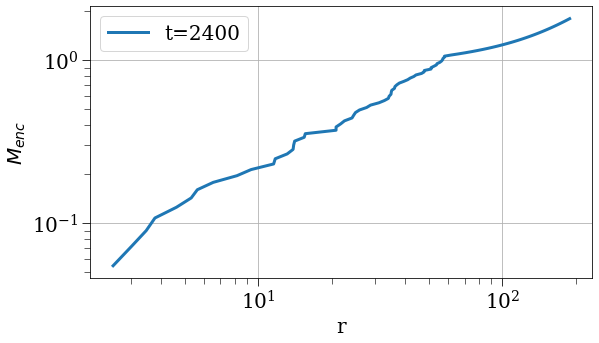

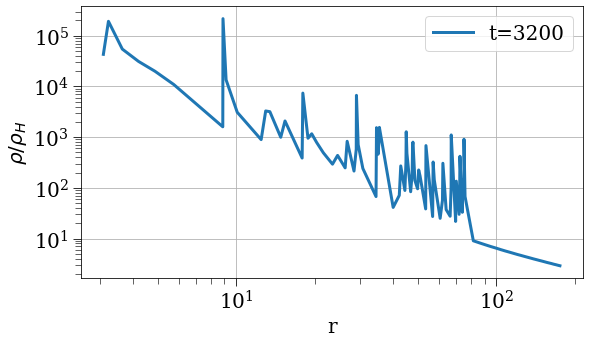

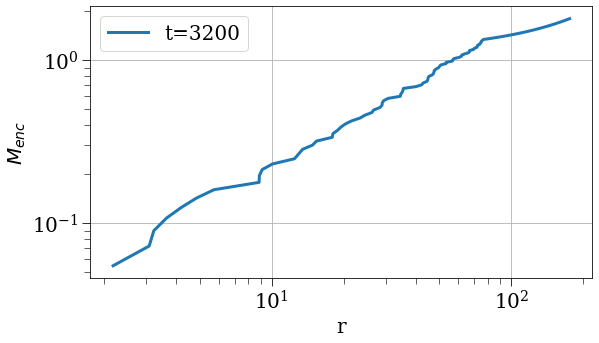

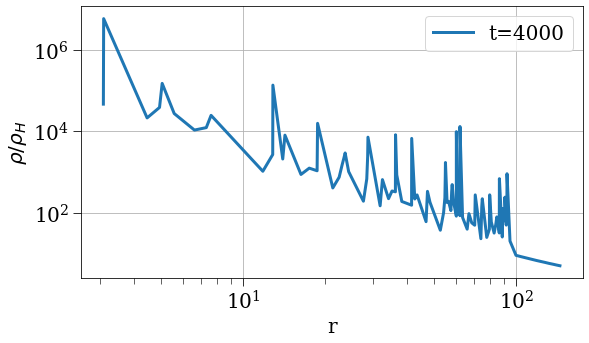

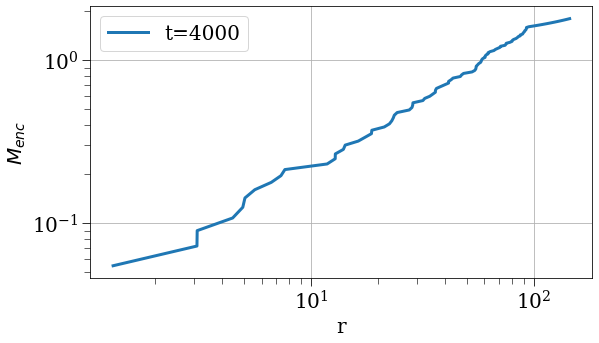

In [20]:
plot_results(results, sc=sc)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft_all',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.5,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.001,
 'save_dt': 1,
 'save_filename': 'runs/72

2025-07-24 01:15:12,328 - collapse - INFO - Simulation setup complete


2025-07-24 01:17:43,982 - DEBUG - Saved dataset t with shape (4001,)
2025-07-24 01:17:43,984 - DEBUG - Saved dataset dt with shape (4001,)
2025-07-24 01:17:44,098 - DEBUG - Saved dataset r with shape (4001, 1000)


2025-07-24 01:17:44,147 - DEBUG - Saved dataset v with shape (4001, 1000)
2025-07-24 01:17:44,240 - DEBUG - Saved dataset a with shape (4001, 1000)
2025-07-24 01:17:44,326 - DEBUG - Saved dataset m_enc with shape (4001, 1000)
2025-07-24 01:17:44,410 - DEBUG - Saved dataset rho_r with shape (4001, 1000)
2025-07-24 01:17:44,412 - WARNING - Skipping pressure because all values are None
2025-07-24 01:17:44,413 - WARNING - Skipping dpressure_drho because all values are None
2025-07-24 01:17:44,414 - WARNING - Skipping rho_prime because all values are None
2025-07-24 01:17:44,485 - DEBUG - Saved dataset e_tot with shape (4001, 1000)
2025-07-24 01:17:44,571 - DEBUG - Saved dataset e_g with shape (4001, 1000)
2025-07-24 01:17:44,665 - DEBUG - Saved dataset e_k with shape (4001, 1000)
2025-07-24 01:17:44,756 - DEBUG - Saved dataset e_r with shape (4001, 1000)
2025-07-24 01:17:44,758 - WARNING - Skipping e_p because all values are None
2025-07-24 01:17:44,759 - WARNING - Skipping e_q because all

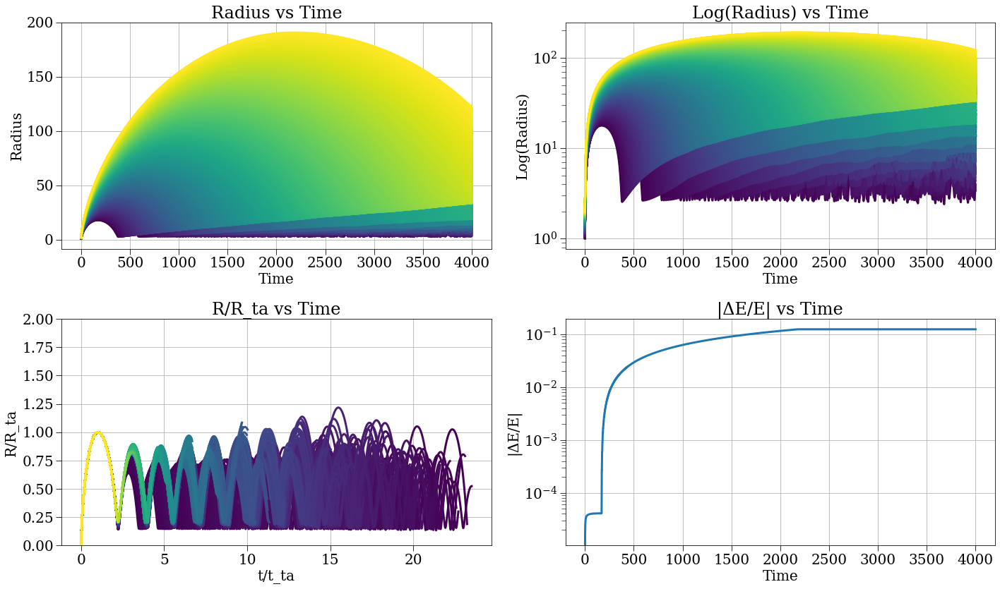

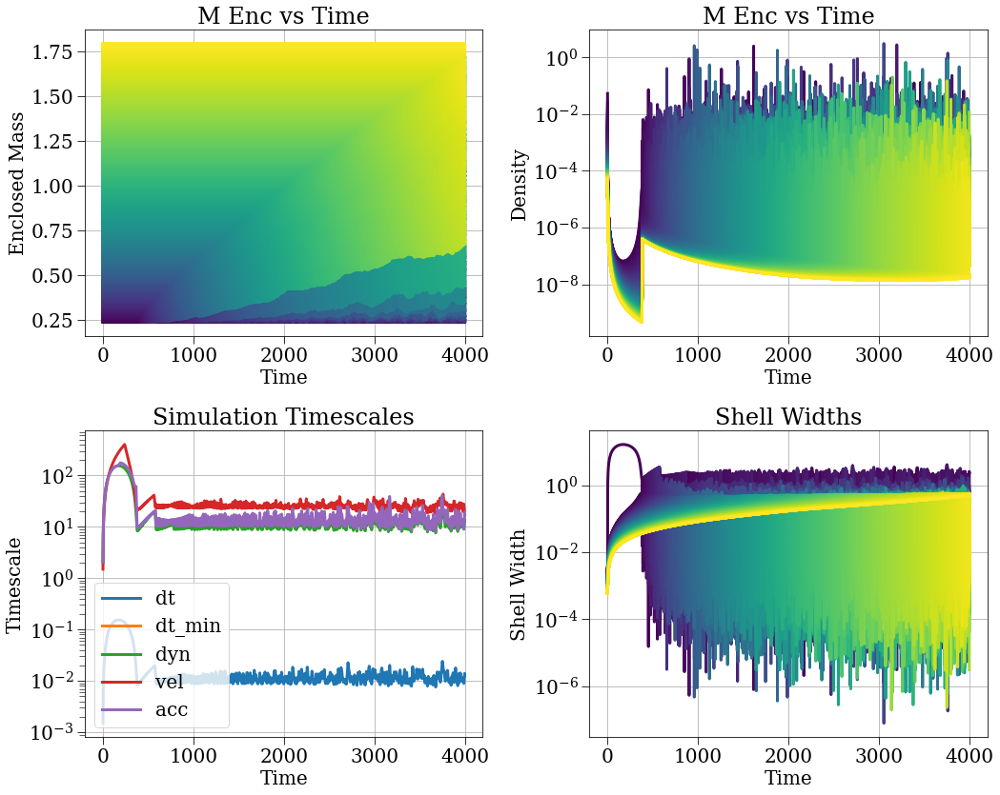

In [59]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='runs/723-8.h5', r_small=1)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft_all',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.1,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.001,
 'save_dt': 1,
 'save_filename': 'runs/72

2025-07-24 01:19:23,929 - collapse - INFO - Simulation setup complete


2025-07-24 02:16:40,058 - DEBUG - Saved dataset t with shape (4001,)
2025-07-24 02:16:40,061 - DEBUG - Saved dataset dt with shape (4001,)
2025-07-24 02:16:40,188 - DEBUG - Saved dataset r with shape (4001, 1000)


2025-07-24 02:16:40,244 - DEBUG - Saved dataset v with shape (4001, 1000)
2025-07-24 02:16:40,329 - DEBUG - Saved dataset a with shape (4001, 1000)
2025-07-24 02:16:40,414 - DEBUG - Saved dataset m_enc with shape (4001, 1000)
2025-07-24 02:16:40,501 - DEBUG - Saved dataset rho_r with shape (4001, 1000)
2025-07-24 02:16:40,502 - WARNING - Skipping pressure because all values are None
2025-07-24 02:16:40,503 - WARNING - Skipping dpressure_drho because all values are None
2025-07-24 02:16:40,505 - WARNING - Skipping rho_prime because all values are None
2025-07-24 02:16:40,584 - DEBUG - Saved dataset e_tot with shape (4001, 1000)
2025-07-24 02:16:40,666 - DEBUG - Saved dataset e_g with shape (4001, 1000)
2025-07-24 02:16:40,762 - DEBUG - Saved dataset e_k with shape (4001, 1000)
2025-07-24 02:16:40,851 - DEBUG - Saved dataset e_r with shape (4001, 1000)
2025-07-24 02:16:40,853 - WARNING - Skipping e_p because all values are None
2025-07-24 02:16:40,854 - WARNING - Skipping e_q because all

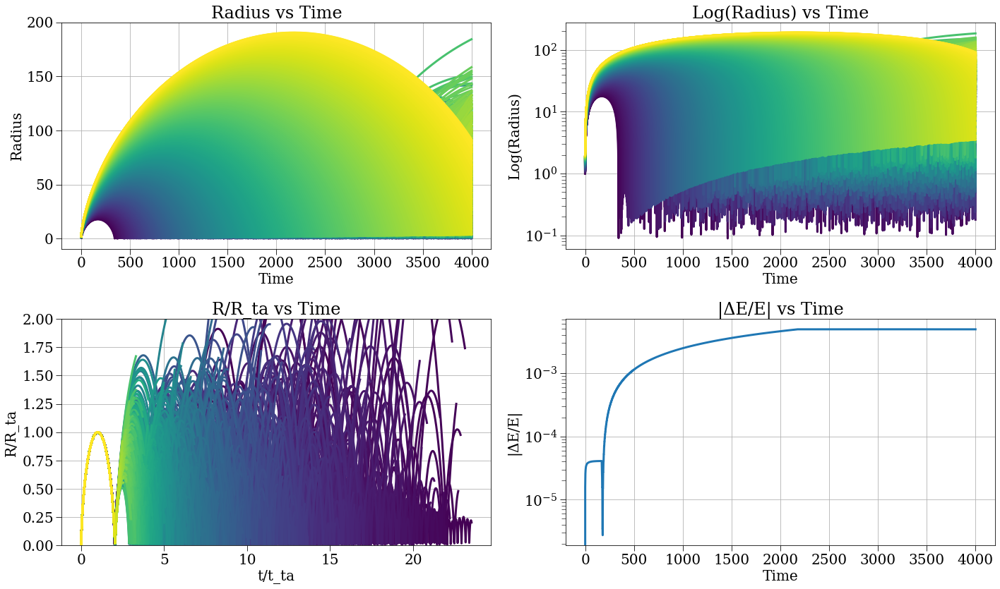

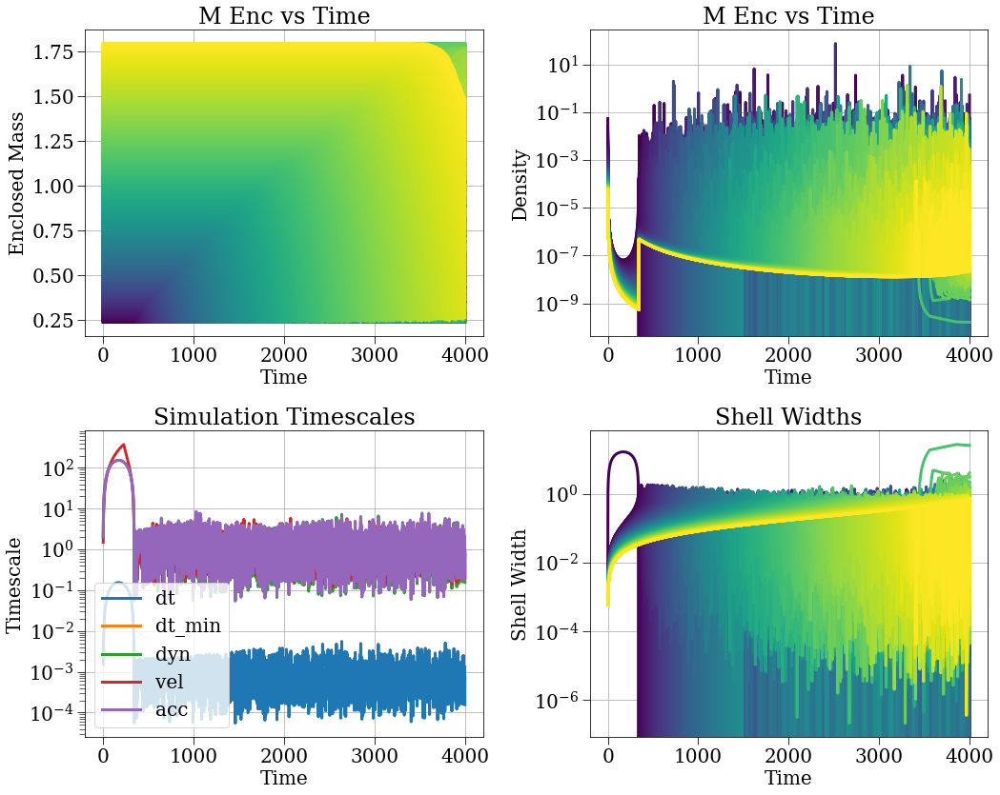

In [61]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='runs/723-7.h5', r_small=1)
sc, results, plotter = run_sc(config, profile=False, plot=True)

(4001,) (1000,)


/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/events.py:88: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


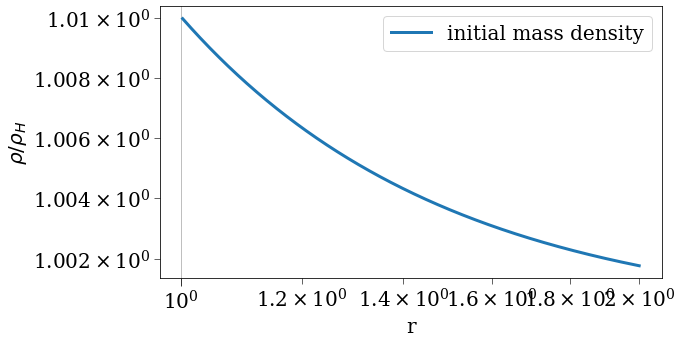

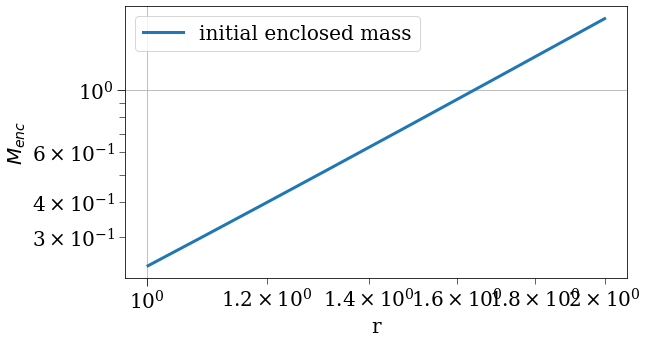

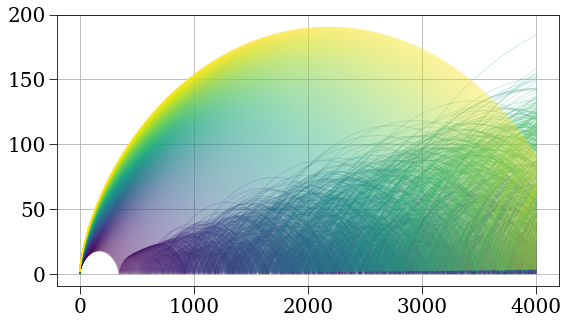

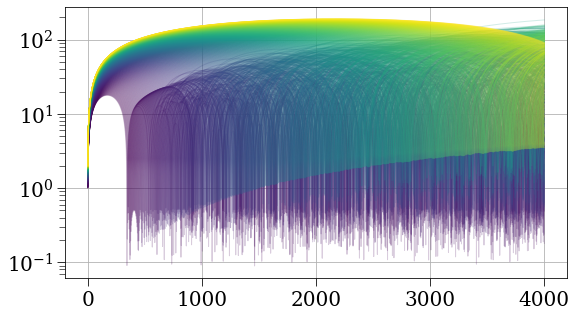

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


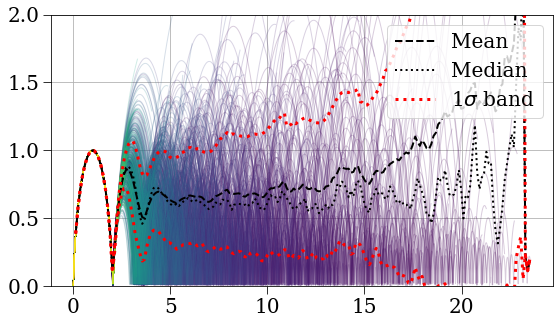

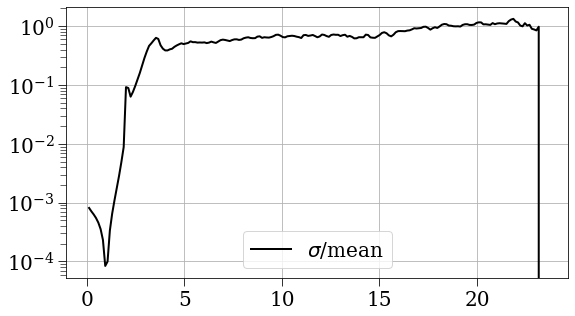

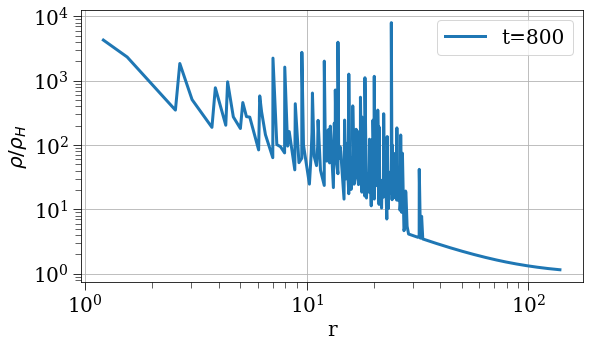

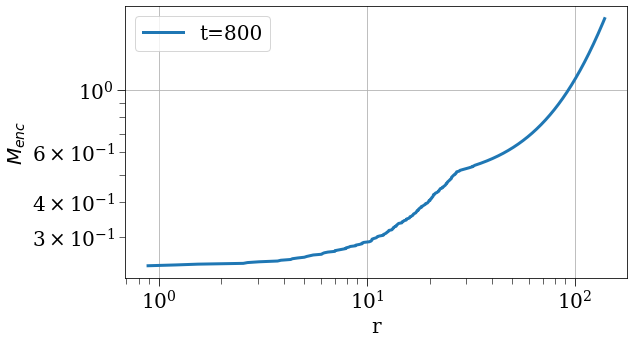

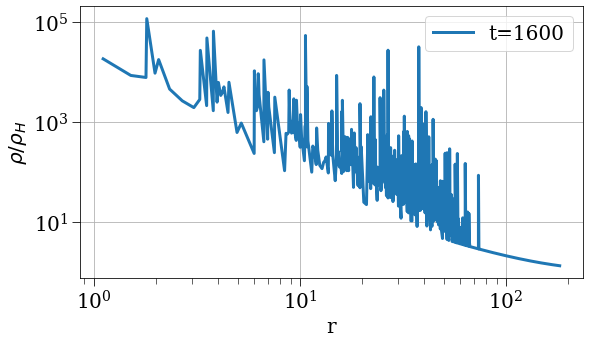

...

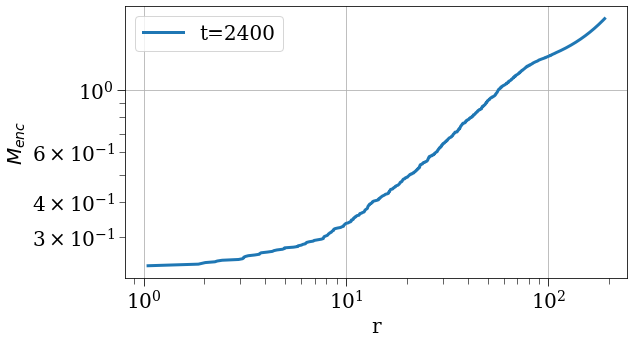

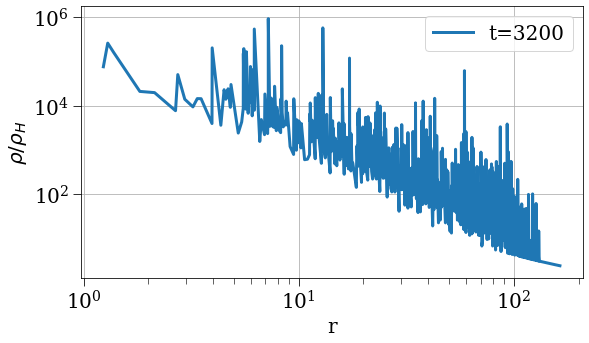

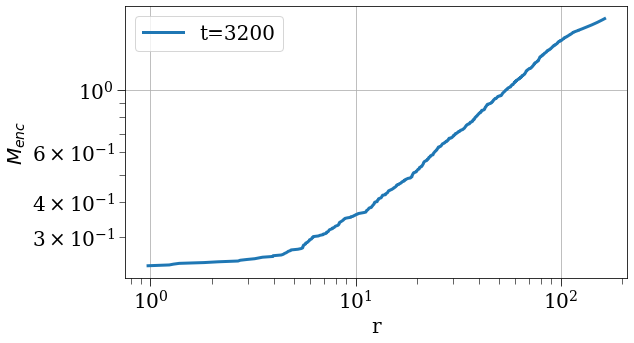

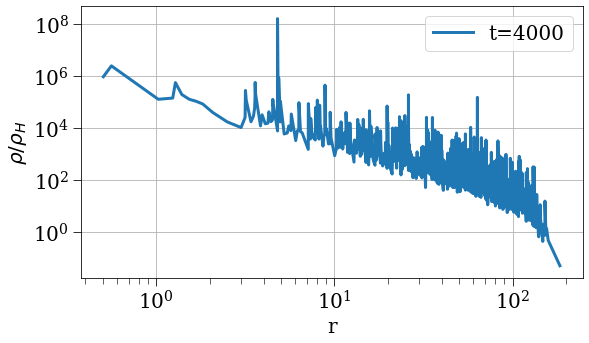

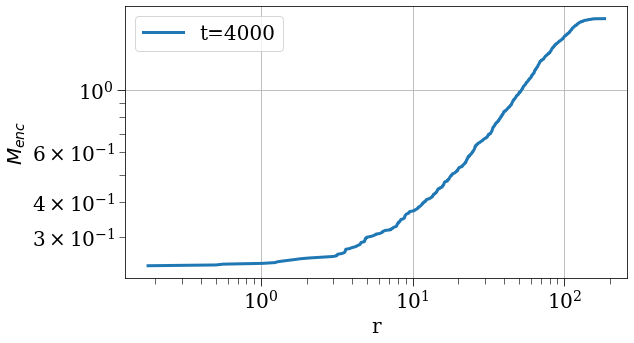

In [66]:
plot_results(results, sc)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft_all',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.5,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': 'runs/723

2025-07-24 01:05:36,859 - collapse - INFO - Simulation setup complete


2025-07-24 01:05:53,881 - DEBUG - Saved dataset t with shape (3944,)
2025-07-24 01:05:53,883 - DEBUG - Saved dataset dt with shape (3944,)
2025-07-24 01:05:53,999 - DEBUG - Saved dataset r with shape (3944, 1000)


2025-07-24 01:05:54,066 - DEBUG - Saved dataset v with shape (3944, 1000)
2025-07-24 01:05:54,153 - DEBUG - Saved dataset a with shape (3944, 1000)
2025-07-24 01:05:54,233 - DEBUG - Saved dataset m_enc with shape (3944, 1000)
2025-07-24 01:05:54,308 - DEBUG - Saved dataset rho_r with shape (3944, 1000)
2025-07-24 01:05:54,310 - WARNING - Skipping pressure because all values are None
2025-07-24 01:05:54,311 - WARNING - Skipping dpressure_drho because all values are None
2025-07-24 01:05:54,312 - WARNING - Skipping rho_prime because all values are None
2025-07-24 01:05:54,410 - DEBUG - Saved dataset e_tot with shape (3944, 1000)
2025-07-24 01:05:54,524 - DEBUG - Saved dataset e_g with shape (3944, 1000)
2025-07-24 01:05:54,626 - DEBUG - Saved dataset e_k with shape (3944, 1000)
2025-07-24 01:05:54,713 - DEBUG - Saved dataset e_r with shape (3944, 1000)
2025-07-24 01:05:54,715 - WARNING - Skipping e_p because all values are None
2025-07-24 01:05:54,716 - WARNING - Skipping e_q because all

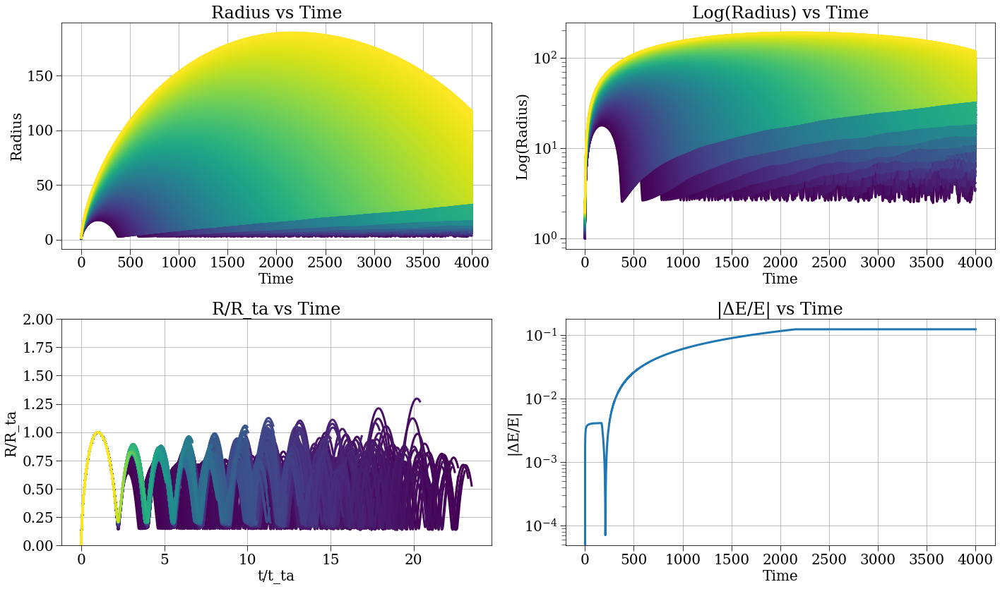

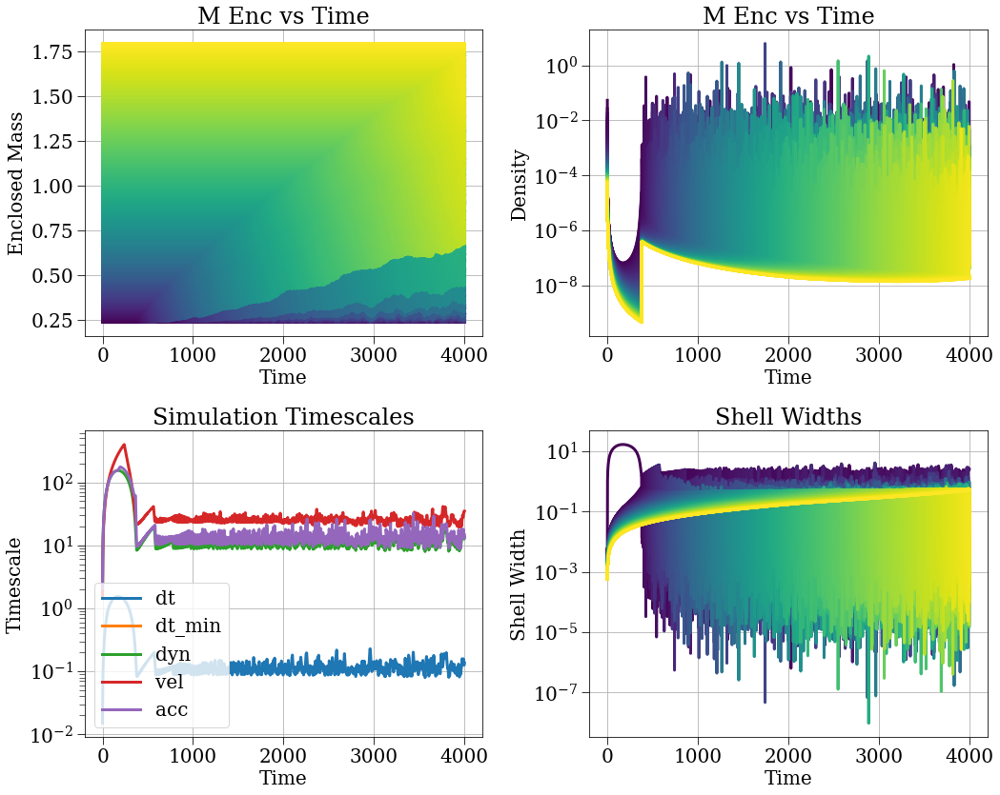

In [55]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='runs/723-6.h5', r_small=1)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft_all',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.7,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': 'runs/723

2025-07-24 01:04:38,639 - collapse - INFO - Simulation setup complete


2025-07-24 01:04:44,306 - DEBUG - Saved dataset t with shape (3937,)
2025-07-24 01:04:44,307 - DEBUG - Saved dataset dt with shape (3937,)
2025-07-24 01:04:44,419 - DEBUG - Saved dataset r with shape (3937, 1000)


2025-07-24 01:04:44,458 - DEBUG - Saved dataset v with shape (3937, 1000)
2025-07-24 01:04:44,538 - DEBUG - Saved dataset a with shape (3937, 1000)
2025-07-24 01:04:44,738 - DEBUG - Saved dataset m_enc with shape (3937, 1000)
2025-07-24 01:04:44,906 - DEBUG - Saved dataset rho_r with shape (3937, 1000)
2025-07-24 01:04:44,911 - WARNING - Skipping pressure because all values are None
2025-07-24 01:04:44,912 - WARNING - Skipping dpressure_drho because all values are None
2025-07-24 01:04:44,913 - WARNING - Skipping rho_prime because all values are None
2025-07-24 01:04:45,017 - DEBUG - Saved dataset e_tot with shape (3937, 1000)
2025-07-24 01:04:45,119 - DEBUG - Saved dataset e_g with shape (3937, 1000)
2025-07-24 01:04:45,210 - DEBUG - Saved dataset e_k with shape (3937, 1000)
2025-07-24 01:04:45,312 - DEBUG - Saved dataset e_r with shape (3937, 1000)
2025-07-24 01:04:45,317 - WARNING - Skipping e_p because all values are None
2025-07-24 01:04:45,318 - WARNING - Skipping e_q because all

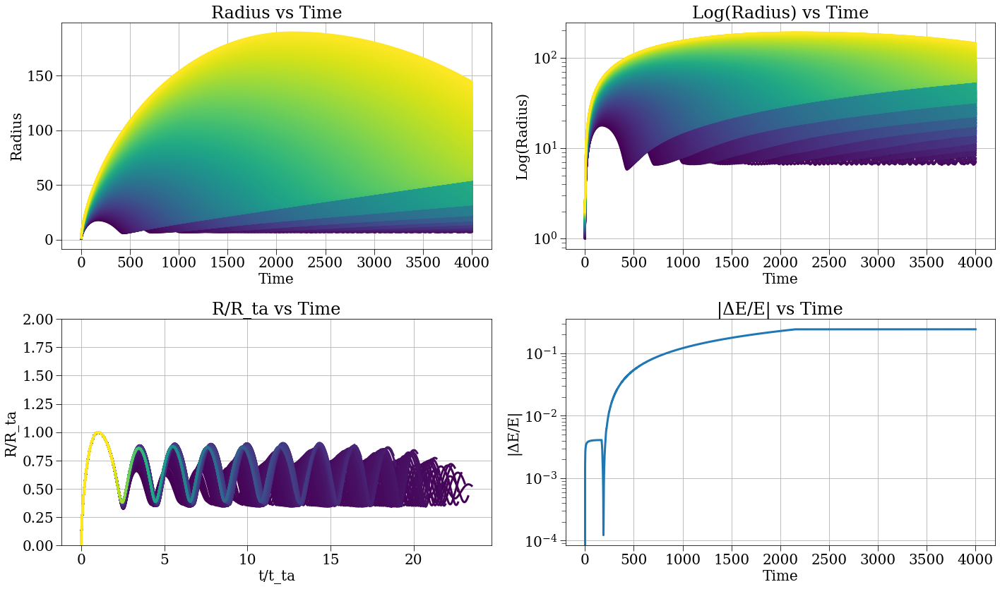

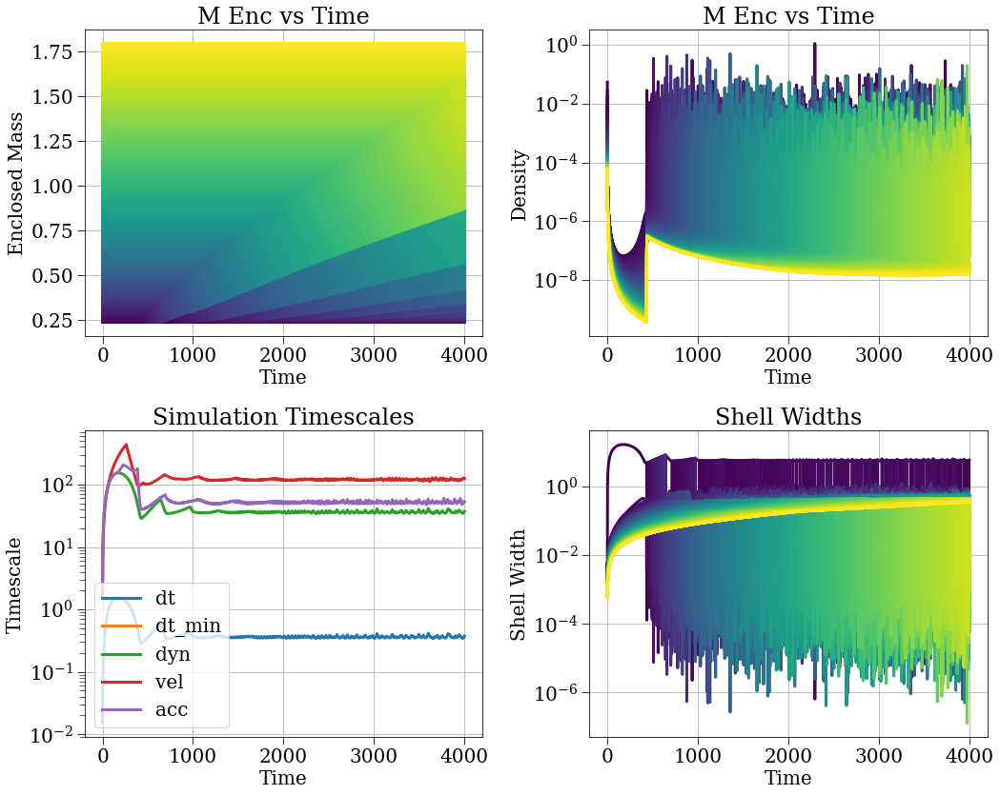

In [53]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, accel_strategy=accel_strategy, ang_mom_strategy=ang_mom_strategy, save_filename='runs/723-5.h5', r_small=1)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'gmr',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.5005,
 'r_max': 2,
 'r_min': 1.5,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': 'runs/723-4.h5',
 'save_s

2025-07-24 00:30:24,044 - collapse - INFO - Simulation setup complete


2025-07-24 00:34:46,074 - DEBUG - Saved dataset t with shape (2718,)
2025-07-24 00:34:46,076 - DEBUG - Saved dataset dt with shape (2718,)
2025-07-24 00:34:46,162 - DEBUG - Saved dataset r with shape (2718, 1000)
2025-07-24 00:34:46,207 - DEBUG - Saved dataset v with shape (2718, 1000)


2025-07-24 00:34:46,266 - DEBUG - Saved dataset a with shape (2718, 1000)
2025-07-24 00:34:46,324 - DEBUG - Saved dataset m_enc with shape (2718, 1000)
2025-07-24 00:34:46,380 - DEBUG - Saved dataset rho_r with shape (2718, 1000)
2025-07-24 00:34:46,382 - WARNING - Skipping pressure because all values are None
2025-07-24 00:34:46,383 - WARNING - Skipping dpressure_drho because all values are None
2025-07-24 00:34:46,384 - WARNING - Skipping rho_prime because all values are None
2025-07-24 00:34:46,433 - DEBUG - Saved dataset e_tot with shape (2718, 1000)
2025-07-24 00:34:46,487 - DEBUG - Saved dataset e_g with shape (2718, 1000)
2025-07-24 00:34:46,538 - DEBUG - Saved dataset e_k with shape (2718, 1000)
2025-07-24 00:34:46,590 - DEBUG - Saved dataset e_r with shape (2718, 1000)
2025-07-24 00:34:46,591 - WARNING - Skipping e_p because all values are None
2025-07-24 00:34:46,592 - WARNING - Skipping e_q because all values are None
2025-07-24 00:34:46,594 - DEBUG - Saved dataset t_dyn wit

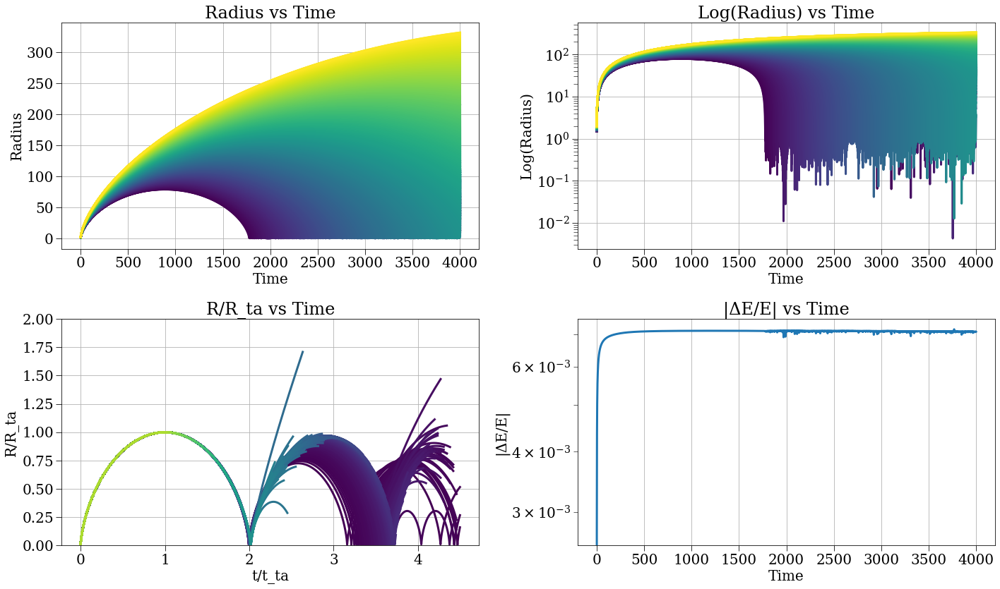

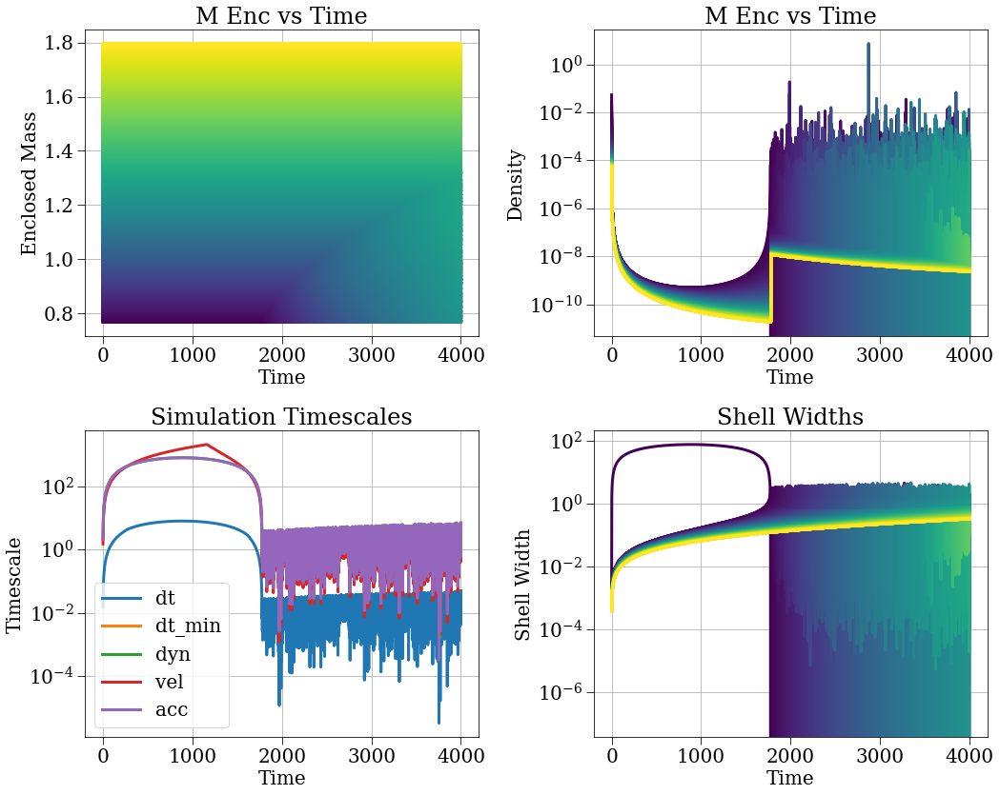

In [10]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/723-4.h5', r_small=1)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.0005,
 'r_max': 1.5,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': 'runs/723-3.h5',
 'save_strategy': 'vf

2025-07-23 21:06:11,615 - collapse - INFO - Simulation setup complete


2025-07-23 21:15:58,732 - DEBUG - Saved dataset t with shape (948,)
2025-07-23 21:15:58,734 - DEBUG - Saved dataset dt with shape (948,)
2025-07-23 21:15:58,777 - DEBUG - Saved dataset r with shape (948, 1000)
2025-07-23 21:15:58,792 - DEBUG - Saved dataset v with shape (948, 1000)
2025-07-23 21:15:58,826 - DEBUG - Saved dataset a with shape (948, 1000)
2025-07-23 21:15:58,855 - DEBUG - Saved dataset m_enc with shape (948, 1000)
2025-07-23 21:15:58,886 - DEBUG - Saved dataset rho_r with shape (948, 1000)
2025-07-23 21:15:58,887 - WARNING - Skipping pressure because all values are None
2025-07-23 21:15:58,888 - WARNING - Skipping dpressure_drho because all values are None
2025-07-23 21:15:58,888 - WARNING - Skipping rho_prime because all values are None


2025-07-23 21:15:58,914 - DEBUG - Saved dataset e_tot with shape (948, 1000)
2025-07-23 21:15:58,941 - DEBUG - Saved dataset e_g with shape (948, 1000)
2025-07-23 21:15:58,970 - DEBUG - Saved dataset e_k with shape (948, 1000)
2025-07-23 21:15:59,000 - DEBUG - Saved dataset e_r with shape (948, 1000)
2025-07-23 21:15:59,001 - WARNING - Skipping e_p because all values are None
2025-07-23 21:15:59,002 - WARNING - Skipping e_q because all values are None
2025-07-23 21:15:59,004 - DEBUG - Saved dataset t_dyn with shape (948,)
2025-07-23 21:15:59,022 - DEBUG - Saved dataset t_vel with shape (948,)
2025-07-23 21:15:59,024 - DEBUG - Saved dataset t_acc with shape (948,)
2025-07-23 21:15:59,025 - WARNING - Skipping t_cross because all values are None
2025-07-23 21:15:59,026 - WARNING - Skipping t_crossa because all values are None
2025-07-23 21:15:59,027 - WARNING - Skipping t_cross2 because all values are None
2025-07-23 21:15:59,028 - WARNING - Skipping t_zero because all values are None
202

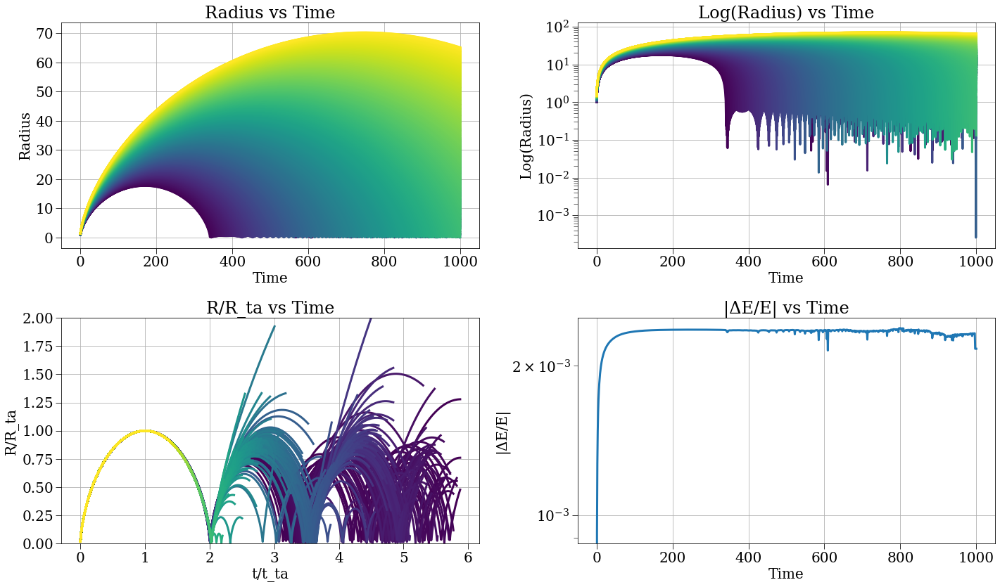

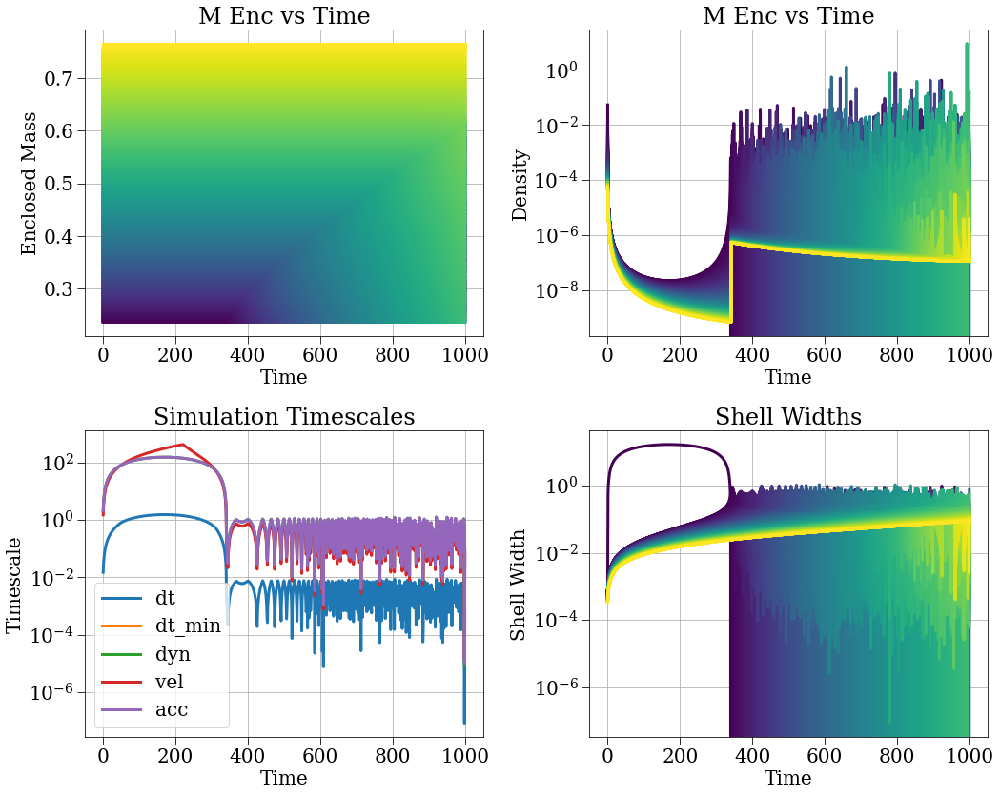

In [ ]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/723-3.h5')
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': 'runs/723-2.h5',
 'save_st

2025-07-23 19:05:24,554 - collapse - INFO - Simulation setup complete


2025-07-23 19:59:37,363 - DEBUG - Saved dataset t with shape (3947,)
2025-07-23 19:59:37,365 - DEBUG - Saved dataset dt with shape (3947,)


2025-07-23 19:59:37,515 - DEBUG - Saved dataset r with shape (3947, 1000)
2025-07-23 19:59:37,562 - DEBUG - Saved dataset v with shape (3947, 1000)
2025-07-23 19:59:37,670 - DEBUG - Saved dataset a with shape (3947, 1000)
2025-07-23 19:59:37,793 - DEBUG - Saved dataset m_enc with shape (3947, 1000)
2025-07-23 19:59:37,880 - DEBUG - Saved dataset rho_r with shape (3947, 1000)
2025-07-23 19:59:37,881 - WARNING - Skipping pressure because all values are None
2025-07-23 19:59:37,883 - WARNING - Skipping dpressure_drho because all values are None
2025-07-23 19:59:37,884 - WARNING - Skipping rho_prime because all values are None
2025-07-23 19:59:37,960 - DEBUG - Saved dataset e_tot with shape (3947, 1000)
2025-07-23 19:59:38,030 - DEBUG - Saved dataset e_g with shape (3947, 1000)
2025-07-23 19:59:38,104 - DEBUG - Saved dataset e_k with shape (3947, 1000)
2025-07-23 19:59:38,189 - DEBUG - Saved dataset e_r with shape (3947, 1000)
2025-07-23 19:59:38,191 - WARNING - Skipping e_p because all va

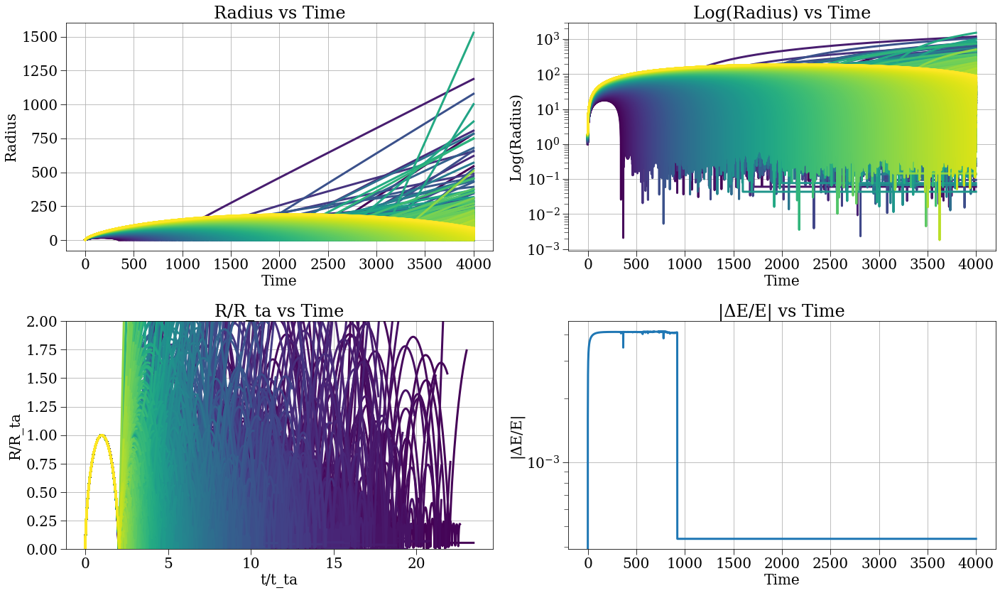

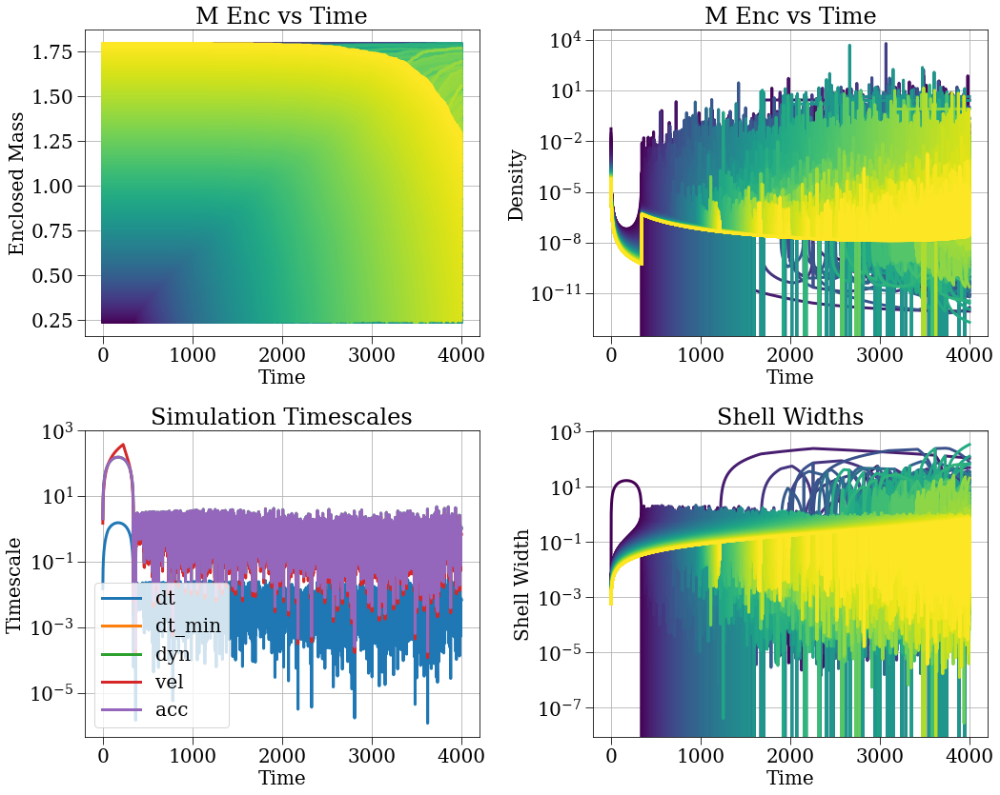

In [ ]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/723-2.h5', r_small=1)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 0.501,
 'r_max': 1.5,
 'r_min': 0.5,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': 'runs/723-1.h5',
 'sav

2025-07-23 18:21:24,010 - collapse - INFO - Simulation setup complete


2025-07-23 18:50:16,255 - DEBUG - Saved dataset t with shape (1001,)
2025-07-23 18:50:16,257 - DEBUG - Saved dataset dt with shape (1001,)
2025-07-23 18:50:16,307 - DEBUG - Saved dataset r with shape (1001, 1000)
2025-07-23 18:50:16,328 - DEBUG - Saved dataset v with shape (1001, 1000)
2025-07-23 18:50:16,357 - DEBUG - Saved dataset a with shape (1001, 1000)
2025-07-23 18:50:16,386 - DEBUG - Saved dataset m_enc with shape (1001, 1000)


2025-07-23 18:50:16,409 - DEBUG - Saved dataset rho_r with shape (1001, 1000)
2025-07-23 18:50:16,410 - WARNING - Skipping pressure because all values are None
2025-07-23 18:50:16,411 - WARNING - Skipping dpressure_drho because all values are None
2025-07-23 18:50:16,413 - WARNING - Skipping rho_prime because all values are None
2025-07-23 18:50:16,436 - DEBUG - Saved dataset e_tot with shape (1001, 1000)
2025-07-23 18:50:16,461 - DEBUG - Saved dataset e_g with shape (1001, 1000)
2025-07-23 18:50:16,490 - DEBUG - Saved dataset e_k with shape (1001, 1000)
2025-07-23 18:50:16,518 - DEBUG - Saved dataset e_r with shape (1001, 1000)
2025-07-23 18:50:16,519 - WARNING - Skipping e_p because all values are None
2025-07-23 18:50:16,520 - WARNING - Skipping e_q because all values are None
2025-07-23 18:50:16,521 - DEBUG - Saved dataset t_dyn with shape (1001,)
2025-07-23 18:50:16,540 - DEBUG - Saved dataset t_vel with shape (1001,)
2025-07-23 18:50:16,541 - DEBUG - Saved dataset t_acc with shap

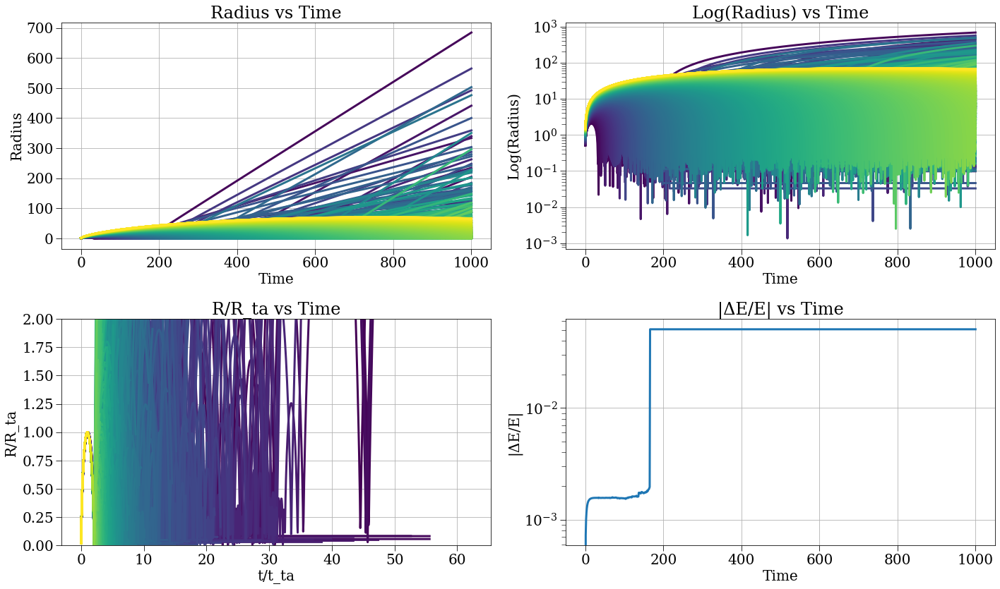

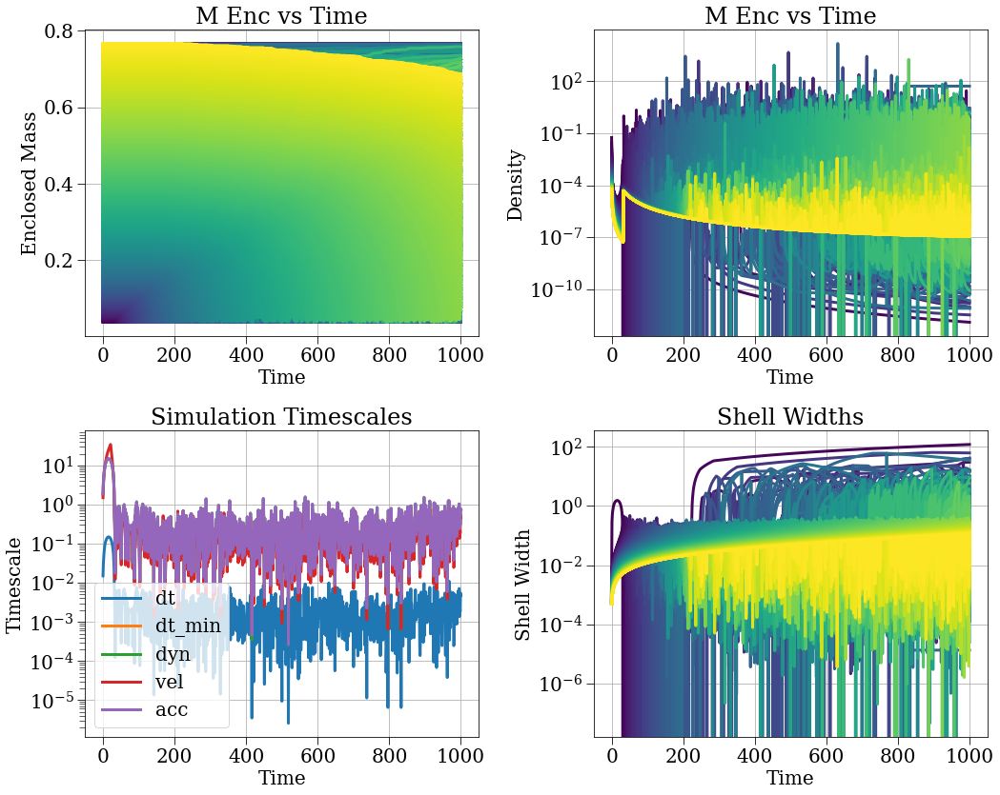

In [ ]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/723-1.h5', r_small=1)
sc, results, plotter = run_sc(config, profile=False, plot=True)

In [ ]:
menc = results['m_enc']
rvals = results['r']
print(np.argmin(np.abs(rvals[0]-1)))
print(rvals[0,295])
menc[0,295]

306
0.9868773800381836


0.22683365581272047

(3947,) (1000,)


/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/events.py:88: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


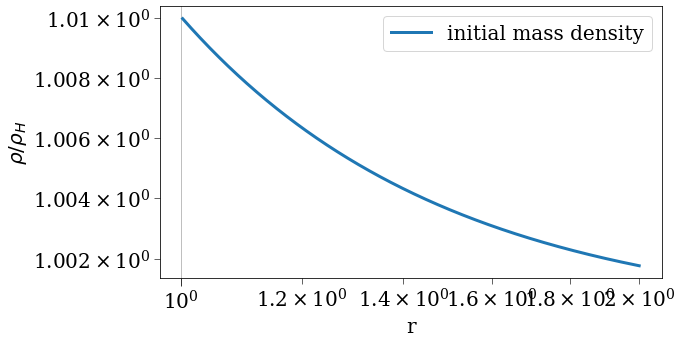

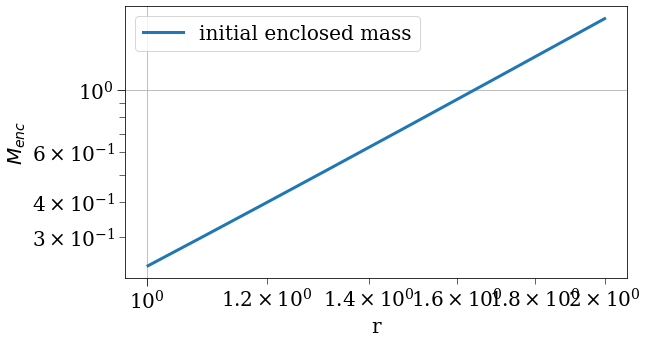

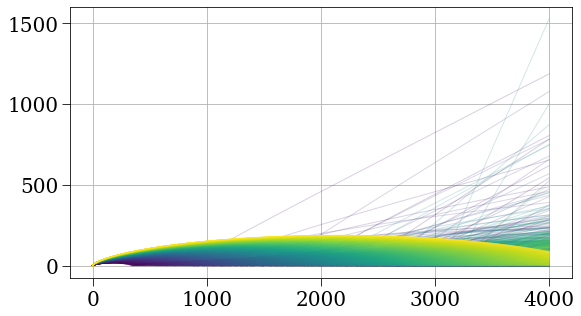

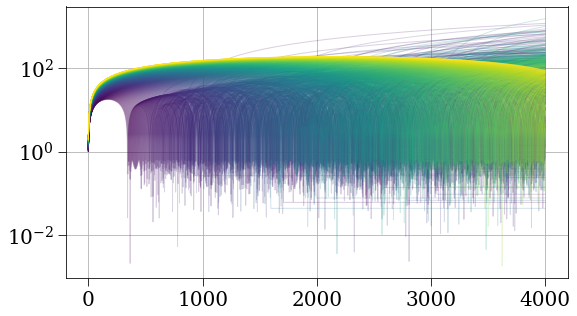

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


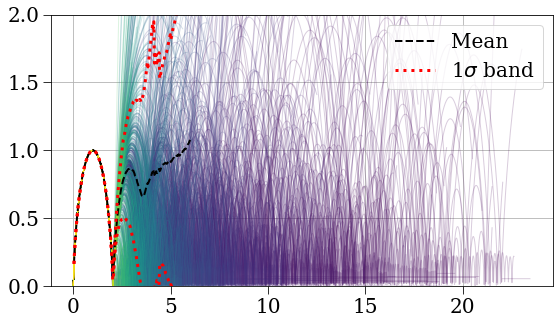

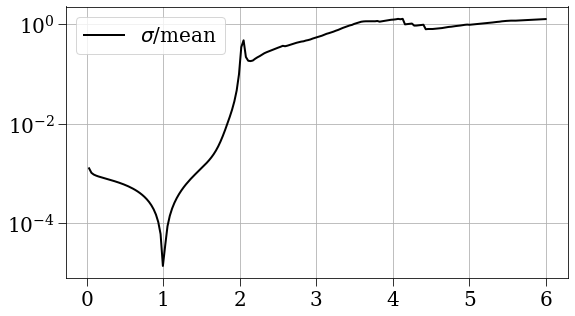

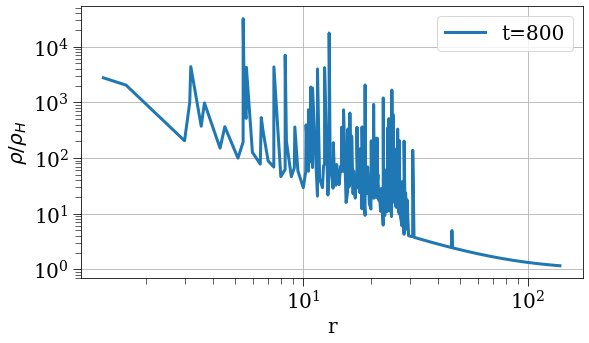

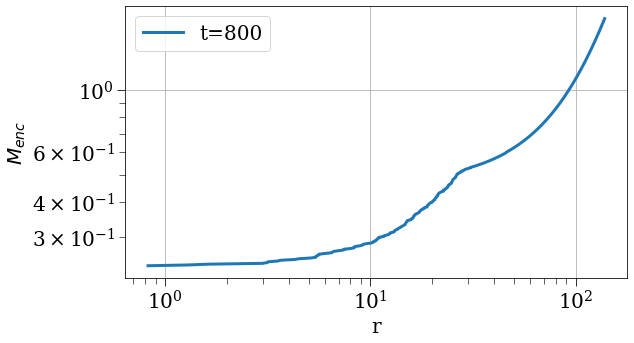

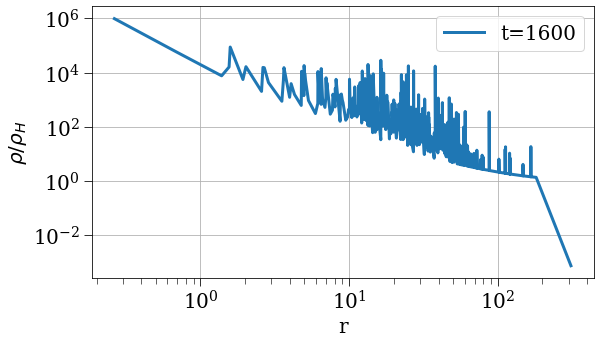

...

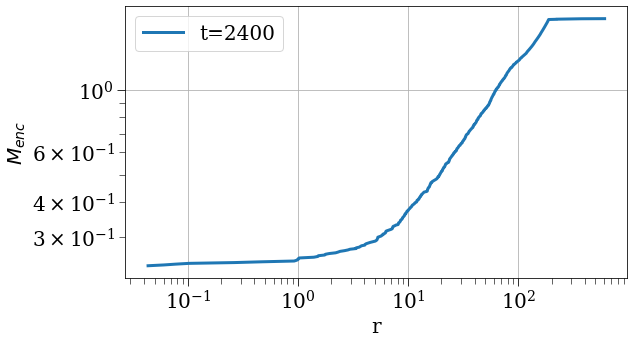

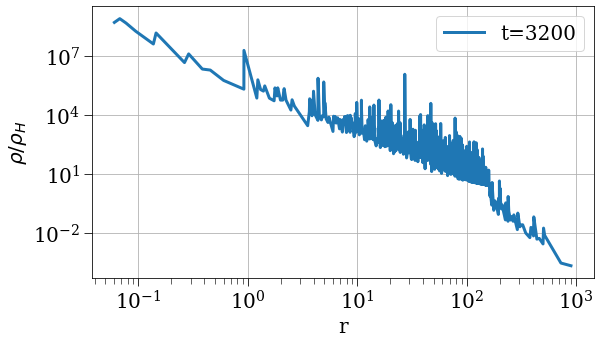

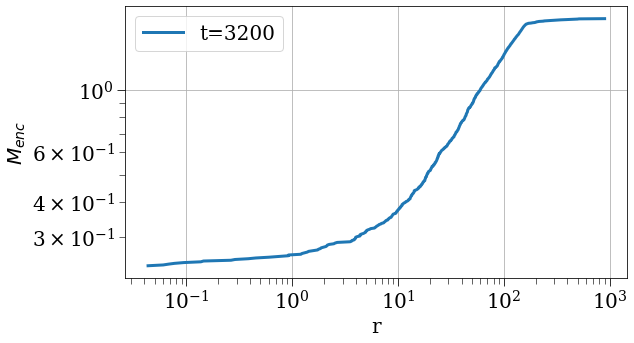

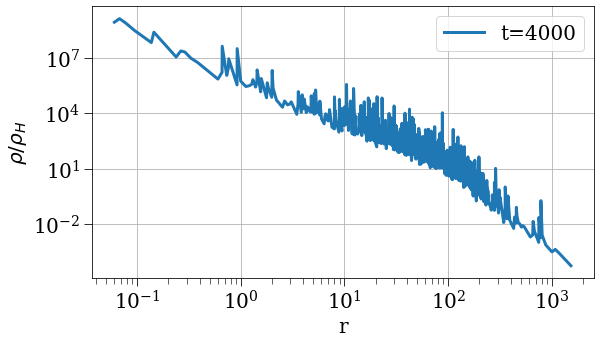

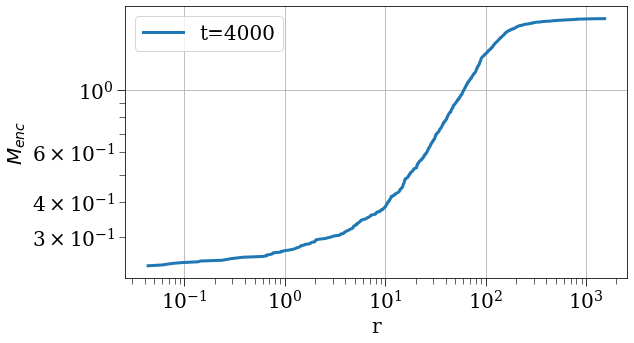

In [ ]:
plot_results(results, sc)

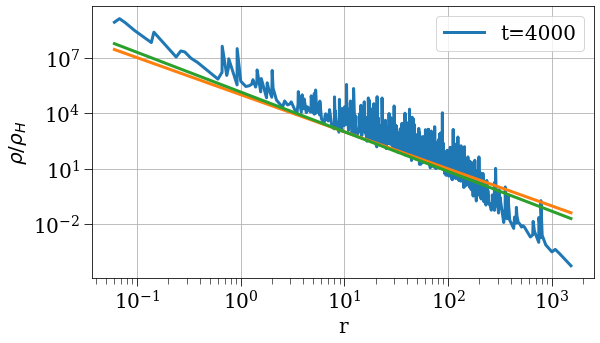

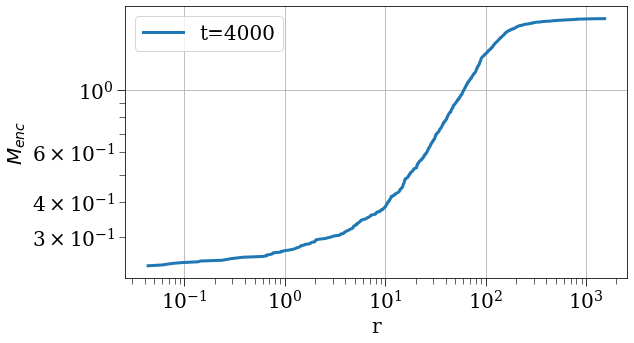

In [ ]:
num_divisions = 1
tvals = results['t']
rvals = results['r']
mvals = results['m'][:,0]
mencvals = results['m_enc']

tval = tvals[-1]
idx = np.argmin(np.abs(tvals - tval))
rho = results['rho_r'][idx,:]
rval = rvals[idx,:]
menc = mencvals[idx,:]


sorted_indices = np.argsort(rval)
rval = rval[sorted_indices]
rho = rho[sorted_indices]
menc = menc[sorted_indices]
mvals = mvals[sorted_indices]
upper_bounds = rval
lower_bounds = np.array([1, *rval[:-1]])
vol = 4/3 * np.pi * (upper_bounds**3 - lower_bounds**3)

plt.figure()

plt.plot(rval[1:], mvals[1:]/(rho_H * (tval+1)**-2 * vol[1:]), label=f't={int(tval)}')
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.yscale('log')
plt.xscale('log')
plt.legend()
scale, pivot = 1e3, 1e1
plt.plot(rval[1:], scale*(rval[1:]/pivot)**-2, label=f't={int(tval)}')
plt.plot(rval[1:], scale*(rval[1:]/pivot)**(-15/7), label=f't={int(tval)}')

plt.figure()
plt.plot(rval, menc, label=f't={int(tval)}')
plt.xlabel('r')
plt.ylabel(r'$M_{enc}$')
plt.yscale('log')
plt.xscale('log')
plt.legend()

{'G': 1,
 'H': 0.6666666666666666,
 'N': 10000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.0001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 10,
 'save_filename': 'runs/723-6.h5',
 'save_strategy': 'vf

2025-07-23 23:47:20,896 - collapse - INFO - Simulation setup complete


2025-07-24 00:19:05,628 - DEBUG - Saved dataset t with shape (51,)
2025-07-24 00:19:05,630 - DEBUG - Saved dataset dt with shape (51,)
2025-07-24 00:19:05,658 - DEBUG - Saved dataset r with shape (51, 10000)
2025-07-24 00:19:05,666 - DEBUG - Saved dataset v with shape (51, 10000)
2025-07-24 00:19:05,684 - DEBUG - Saved dataset a with shape (51, 10000)
2025-07-24 00:19:05,701 - DEBUG - Saved dataset m_enc with shape (51, 10000)
2025-07-24 00:19:05,718 - DEBUG - Saved dataset rho_r with shape (51, 10000)
2025-07-24 00:19:05,719 - WARNING - Skipping pressure because all values are None
2025-07-24 00:19:05,719 - WARNING - Skipping dpressure_drho because all values are None
2025-07-24 00:19:05,720 - WARNING - Skipping rho_prime because all values are None
2025-07-24 00:19:05,731 - DEBUG - Saved dataset e_tot with shape (51, 10000)
2025-07-24 00:19:05,748 - DEBUG - Saved dataset e_g with shape (51, 10000)
2025-07-24 00:19:05,764 - DEBUG - Saved dataset e_k with shape (51, 10000)
2025-07-24 0

2025-07-24 00:19:05,798 - WARNING - Skipping t_cross2 because all values are None
2025-07-24 00:19:05,799 - WARNING - Skipping t_zero because all values are None
2025-07-24 00:19:05,800 - WARNING - Skipping t_rmin because all values are None
2025-07-24 00:19:05,800 - WARNING - Skipping t_rmina because all values are None
2025-07-24 00:19:05,801 - WARNING - Skipping t_ref because all values are None
2025-07-24 00:19:05,802 - WARNING - Skipping t_thickness because all values are None
2025-07-24 00:19:05,802 - WARNING - Skipping t_dynr because all values are None
2025-07-24 00:19:05,803 - WARNING - Skipping t_dynnext because all values are None
2025-07-24 00:19:05,803 - WARNING - Skipping t_sound because all values are None
2025-07-24 00:19:05,804 - WARNING - Skipping t_j because all values are None
2025-07-24 00:19:05,805 - WARNING - Skipping t_jeans because all values are None
2025-07-24 00:19:05,806 - DEBUG - Saved dataset num_crossing with shape (51,)
2025-07-24 00:19:05,827 - DEBUG -

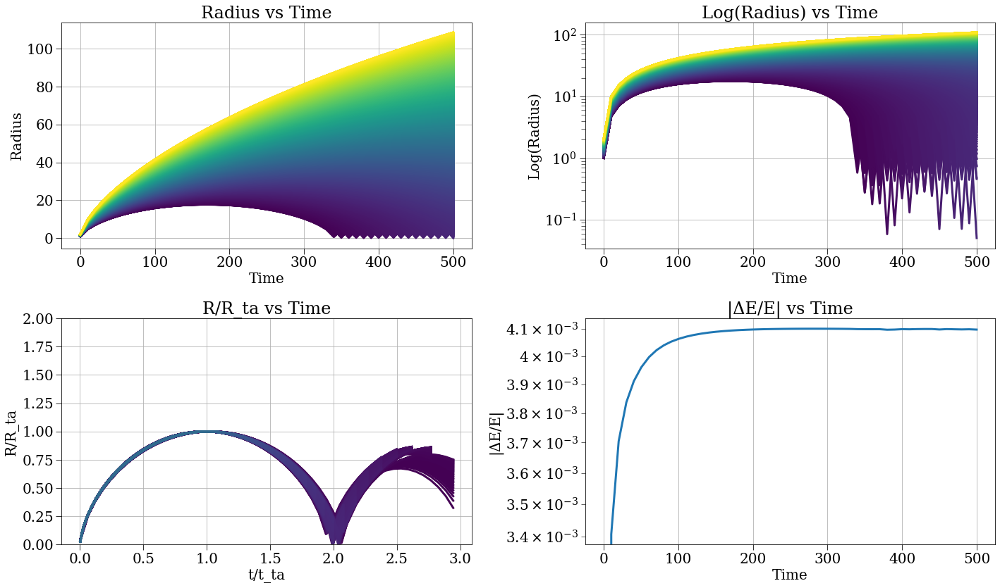

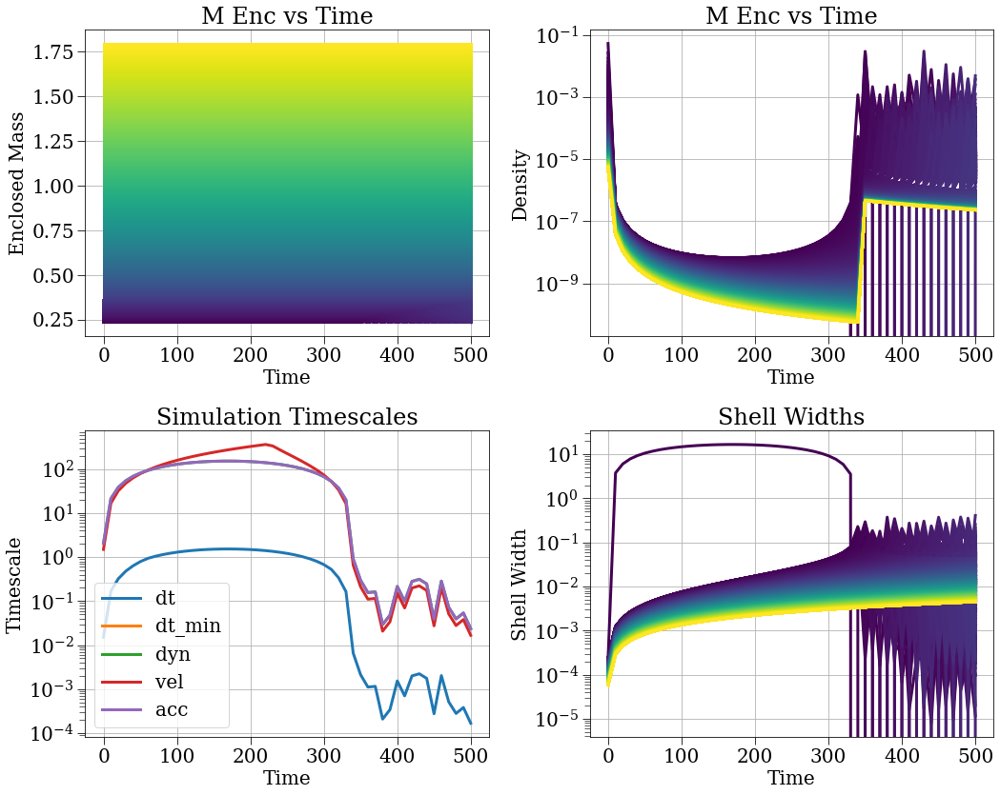

In [92]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/723-6.h5')
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.001,
 'save_dt': 10,
 'save_filename': 'runs/723-5.h5',
 'save_strategy': 'vfl

2025-07-23 23:41:10,551 - collapse - INFO - Simulation setup complete


2025-07-23 23:46:29,910 - DEBUG - Saved dataset t with shape (51,)
2025-07-23 23:46:29,912 - DEBUG - Saved dataset dt with shape (51,)
2025-07-23 23:46:29,918 - DEBUG - Saved dataset r with shape (51, 1000)
2025-07-23 23:46:29,921 - DEBUG - Saved dataset v with shape (51, 1000)
2025-07-23 23:46:29,925 - DEBUG - Saved dataset a with shape (51, 1000)
2025-07-23 23:46:29,928 - DEBUG - Saved dataset m_enc with shape (51, 1000)
2025-07-23 23:46:29,931 - DEBUG - Saved dataset rho_r with shape (51, 1000)
2025-07-23 23:46:29,932 - WARNING - Skipping pressure because all values are None
2025-07-23 23:46:29,933 - WARNING - Skipping dpressure_drho because all values are None
2025-07-23 23:46:29,934 - WARNING - Skipping rho_prime because all values are None
2025-07-23 23:46:29,937 - DEBUG - Saved dataset e_tot with shape (51, 1000)
2025-07-23 23:46:29,941 - DEBUG - Saved dataset e_g with shape (51, 1000)
2025-07-23 23:46:29,944 - DEBUG - Saved dataset e_k with shape (51, 1000)
2025-07-23 23:46:29,

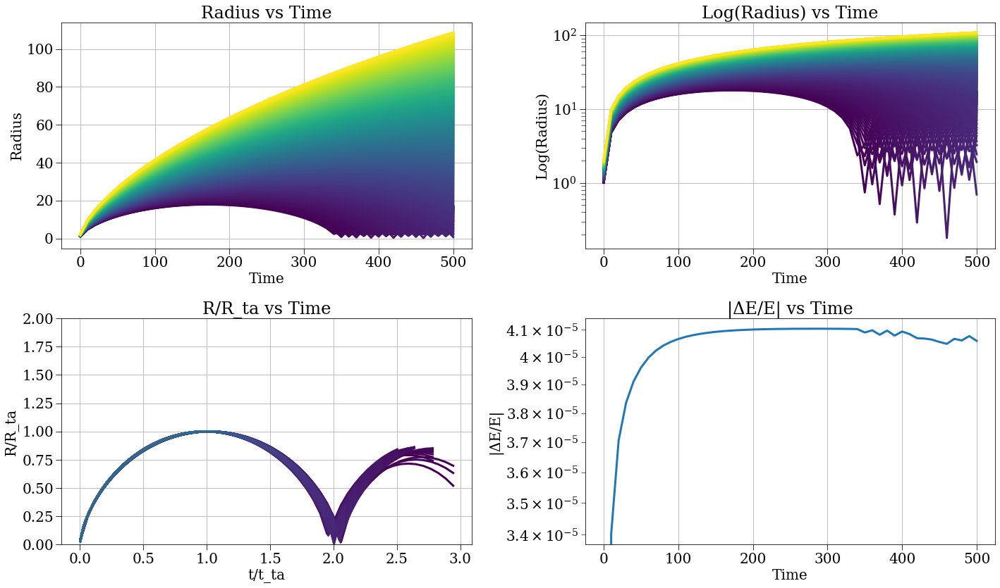

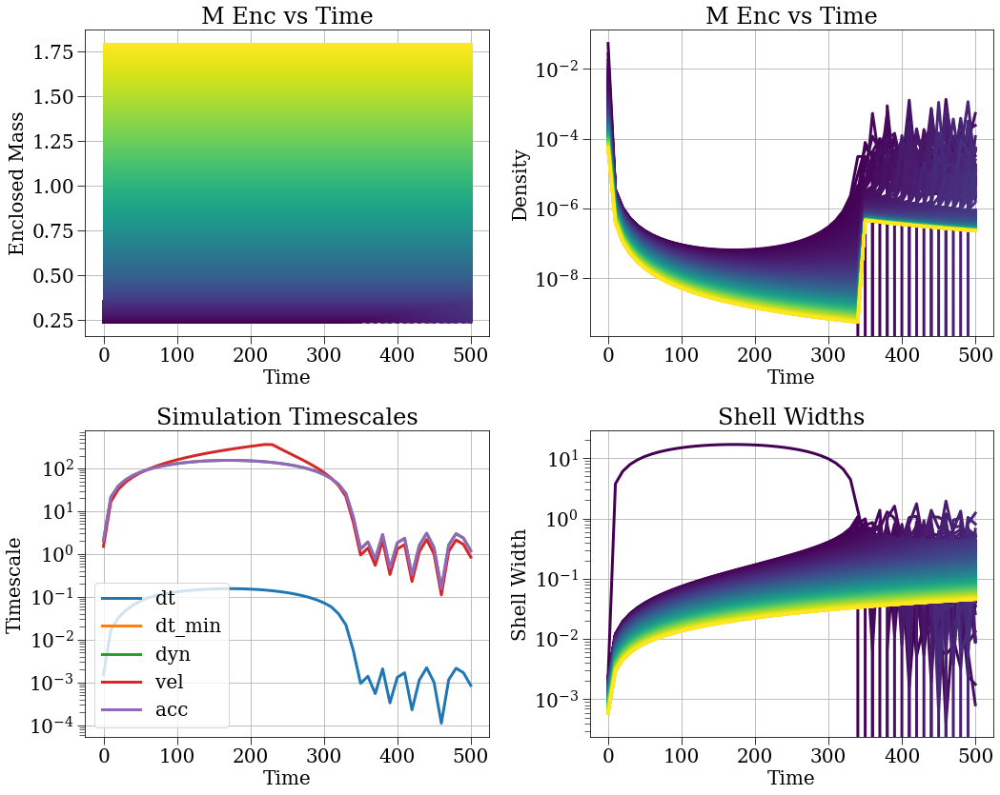

In [90]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/723-5.h5')
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 10,
 'save_filename': 'runs/723-4.h5',
 'save_strategy': 'vfli

2025-07-23 23:39:30,486 - collapse - INFO - Simulation setup complete


2025-07-23 23:40:03,723 - DEBUG - Saved dataset t with shape (51,)
2025-07-23 23:40:03,724 - DEBUG - Saved dataset dt with shape (51,)
2025-07-23 23:40:03,730 - DEBUG - Saved dataset r with shape (51, 1000)
2025-07-23 23:40:03,732 - DEBUG - Saved dataset v with shape (51, 1000)
2025-07-23 23:40:03,735 - DEBUG - Saved dataset a with shape (51, 1000)
2025-07-23 23:40:03,738 - DEBUG - Saved dataset m_enc with shape (51, 1000)
2025-07-23 23:40:03,741 - DEBUG - Saved dataset rho_r with shape (51, 1000)
2025-07-23 23:40:03,742 - WARNING - Skipping pressure because all values are None
2025-07-23 23:40:03,742 - WARNING - Skipping dpressure_drho because all values are None
2025-07-23 23:40:03,743 - WARNING - Skipping rho_prime because all values are None
2025-07-23 23:40:03,744 - DEBUG - Saved dataset e_tot with shape (51, 1000)
2025-07-23 23:40:03,748 - DEBUG - Saved dataset e_g with shape (51, 1000)
2025-07-23 23:40:03,751 - DEBUG - Saved dataset e_k with shape (51, 1000)
2025-07-23 23:40:03,

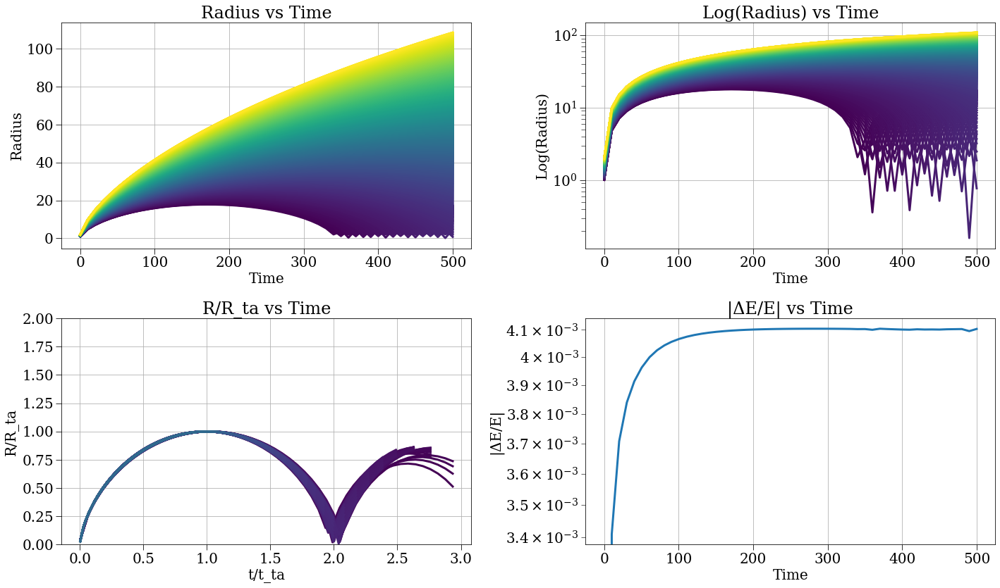

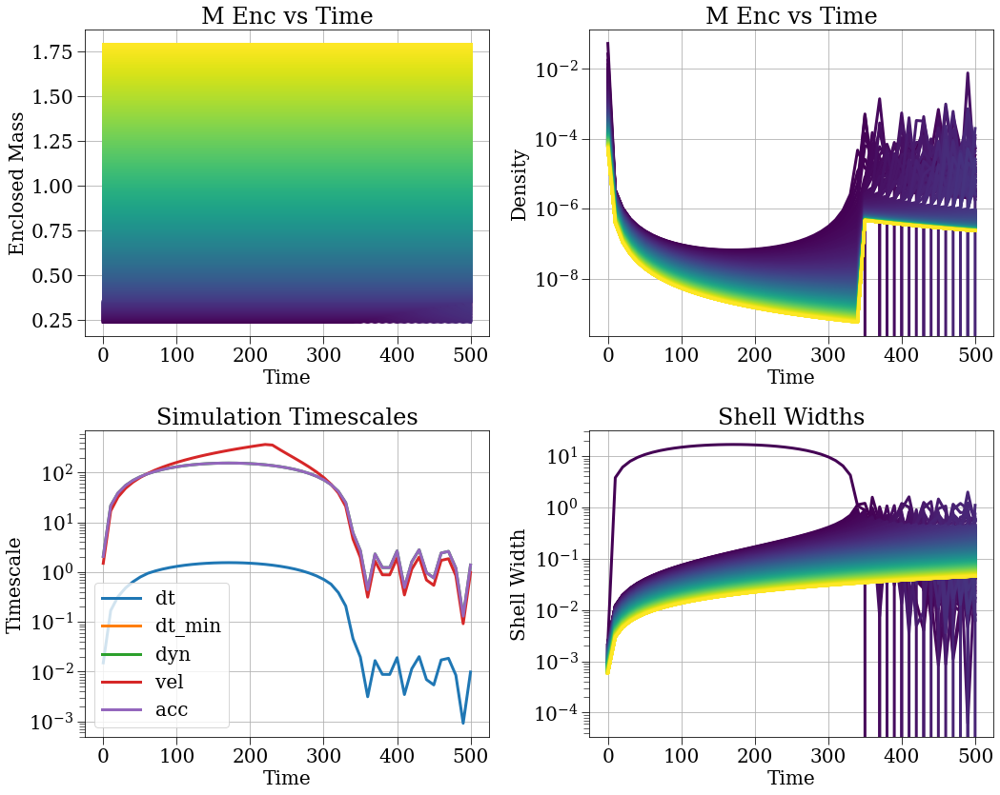

In [87]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/723-4.h5')
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1500,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.0006666666666666,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': 'runs/723-4.h5',
 'save_stra

2025-07-23 21:27:33,367 - collapse - INFO - Simulation setup complete


2025-07-23 23:25:04,557 - DEBUG - Saved dataset t with shape (3947,)
2025-07-23 23:25:04,559 - DEBUG - Saved dataset dt with shape (3947,)


2025-07-23 23:25:04,735 - DEBUG - Saved dataset r with shape (3947, 1500)
2025-07-23 23:25:04,804 - DEBUG - Saved dataset v with shape (3947, 1500)
2025-07-23 23:25:04,925 - DEBUG - Saved dataset a with shape (3947, 1500)
2025-07-23 23:25:05,045 - DEBUG - Saved dataset m_enc with shape (3947, 1500)
2025-07-23 23:25:05,158 - DEBUG - Saved dataset rho_r with shape (3947, 1500)
2025-07-23 23:25:05,159 - WARNING - Skipping pressure because all values are None
2025-07-23 23:25:05,160 - WARNING - Skipping dpressure_drho because all values are None
2025-07-23 23:25:05,161 - WARNING - Skipping rho_prime because all values are None
2025-07-23 23:25:05,275 - DEBUG - Saved dataset e_tot with shape (3947, 1500)
2025-07-23 23:25:05,391 - DEBUG - Saved dataset e_g with shape (3947, 1500)
2025-07-23 23:25:05,505 - DEBUG - Saved dataset e_k with shape (3947, 1500)
2025-07-23 23:25:05,620 - DEBUG - Saved dataset e_r with shape (3947, 1500)
2025-07-23 23:25:05,621 - WARNING - Skipping e_p because all va

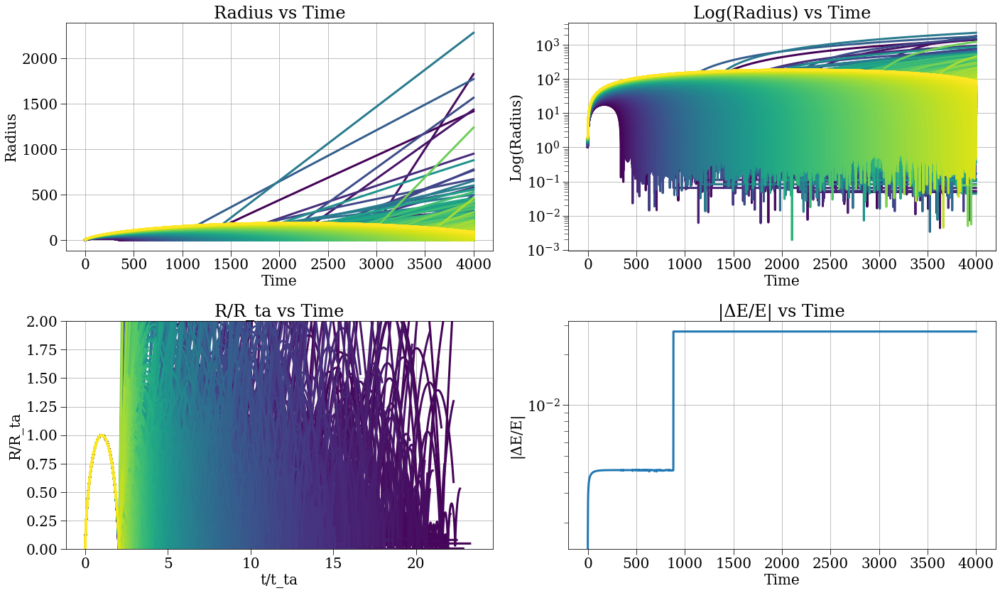

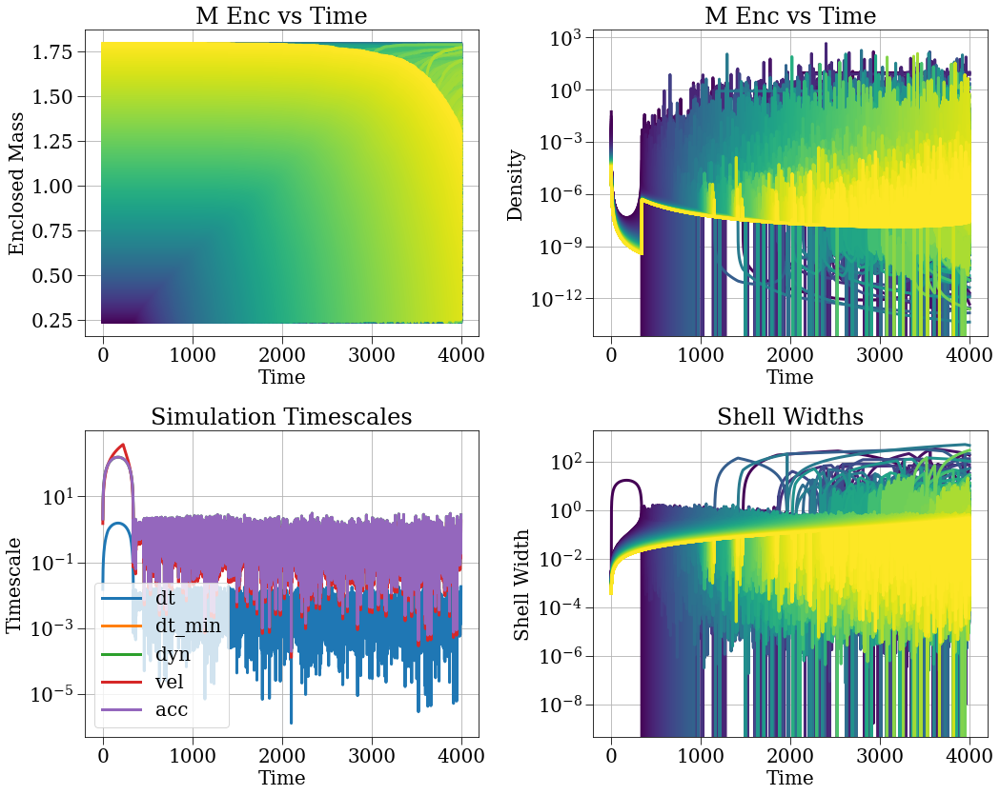

In [81]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/723-4.h5')
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.0005,
 'r_max': 1.5,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': 'runs/723-3.h5',
 'save_strategy': 'vf

2025-07-23 21:06:11,615 - collapse - INFO - Simulation setup complete


2025-07-23 21:15:58,732 - DEBUG - Saved dataset t with shape (948,)
2025-07-23 21:15:58,734 - DEBUG - Saved dataset dt with shape (948,)
2025-07-23 21:15:58,777 - DEBUG - Saved dataset r with shape (948, 1000)
2025-07-23 21:15:58,792 - DEBUG - Saved dataset v with shape (948, 1000)
2025-07-23 21:15:58,826 - DEBUG - Saved dataset a with shape (948, 1000)
2025-07-23 21:15:58,855 - DEBUG - Saved dataset m_enc with shape (948, 1000)
2025-07-23 21:15:58,886 - DEBUG - Saved dataset rho_r with shape (948, 1000)
2025-07-23 21:15:58,887 - WARNING - Skipping pressure because all values are None
2025-07-23 21:15:58,888 - WARNING - Skipping dpressure_drho because all values are None
2025-07-23 21:15:58,888 - WARNING - Skipping rho_prime because all values are None


2025-07-23 21:15:58,914 - DEBUG - Saved dataset e_tot with shape (948, 1000)
2025-07-23 21:15:58,941 - DEBUG - Saved dataset e_g with shape (948, 1000)
2025-07-23 21:15:58,970 - DEBUG - Saved dataset e_k with shape (948, 1000)
2025-07-23 21:15:59,000 - DEBUG - Saved dataset e_r with shape (948, 1000)
2025-07-23 21:15:59,001 - WARNING - Skipping e_p because all values are None
2025-07-23 21:15:59,002 - WARNING - Skipping e_q because all values are None
2025-07-23 21:15:59,004 - DEBUG - Saved dataset t_dyn with shape (948,)
2025-07-23 21:15:59,022 - DEBUG - Saved dataset t_vel with shape (948,)
2025-07-23 21:15:59,024 - DEBUG - Saved dataset t_acc with shape (948,)
2025-07-23 21:15:59,025 - WARNING - Skipping t_cross because all values are None
2025-07-23 21:15:59,026 - WARNING - Skipping t_crossa because all values are None
2025-07-23 21:15:59,027 - WARNING - Skipping t_cross2 because all values are None
2025-07-23 21:15:59,028 - WARNING - Skipping t_zero because all values are None
202

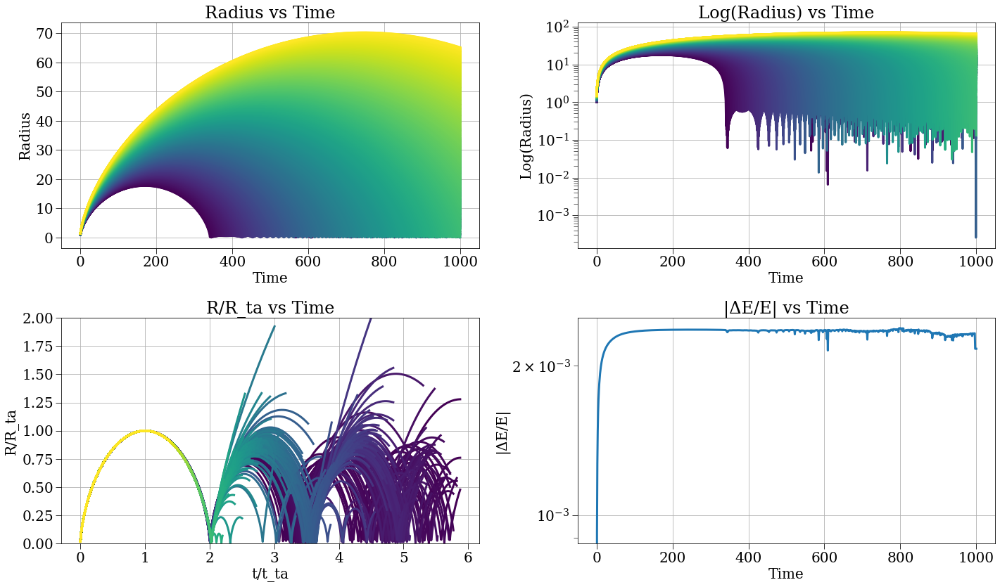

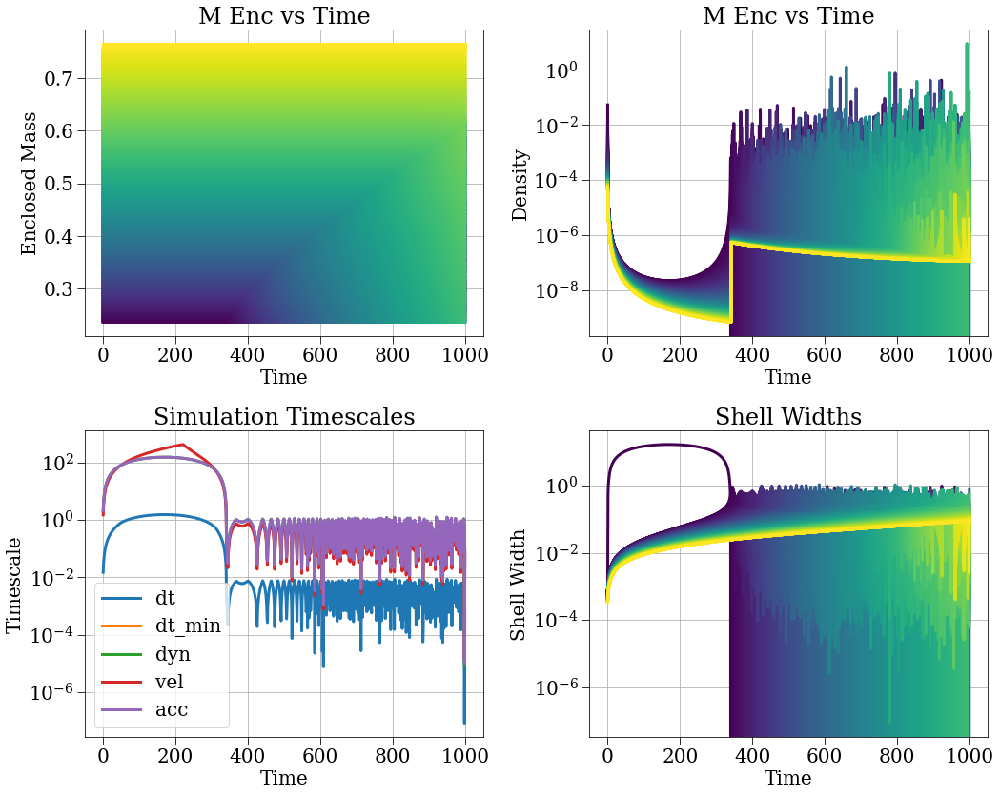

In [76]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/723-3.h5')
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': 'runs/723-2.h5',
 'save_st

2025-07-23 19:05:24,554 - collapse - INFO - Simulation setup complete


2025-07-23 19:59:37,363 - DEBUG - Saved dataset t with shape (3947,)
2025-07-23 19:59:37,365 - DEBUG - Saved dataset dt with shape (3947,)


2025-07-23 19:59:37,515 - DEBUG - Saved dataset r with shape (3947, 1000)
2025-07-23 19:59:37,562 - DEBUG - Saved dataset v with shape (3947, 1000)
2025-07-23 19:59:37,670 - DEBUG - Saved dataset a with shape (3947, 1000)
2025-07-23 19:59:37,793 - DEBUG - Saved dataset m_enc with shape (3947, 1000)
2025-07-23 19:59:37,880 - DEBUG - Saved dataset rho_r with shape (3947, 1000)
2025-07-23 19:59:37,881 - WARNING - Skipping pressure because all values are None
2025-07-23 19:59:37,883 - WARNING - Skipping dpressure_drho because all values are None
2025-07-23 19:59:37,884 - WARNING - Skipping rho_prime because all values are None
2025-07-23 19:59:37,960 - DEBUG - Saved dataset e_tot with shape (3947, 1000)
2025-07-23 19:59:38,030 - DEBUG - Saved dataset e_g with shape (3947, 1000)
2025-07-23 19:59:38,104 - DEBUG - Saved dataset e_k with shape (3947, 1000)
2025-07-23 19:59:38,189 - DEBUG - Saved dataset e_r with shape (3947, 1000)
2025-07-23 19:59:38,191 - WARNING - Skipping e_p because all va

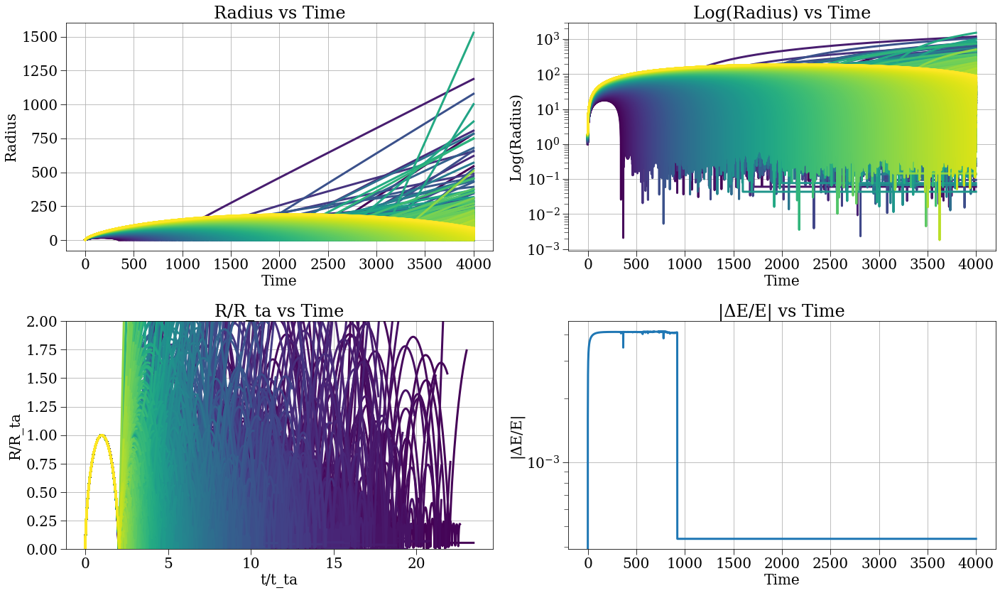

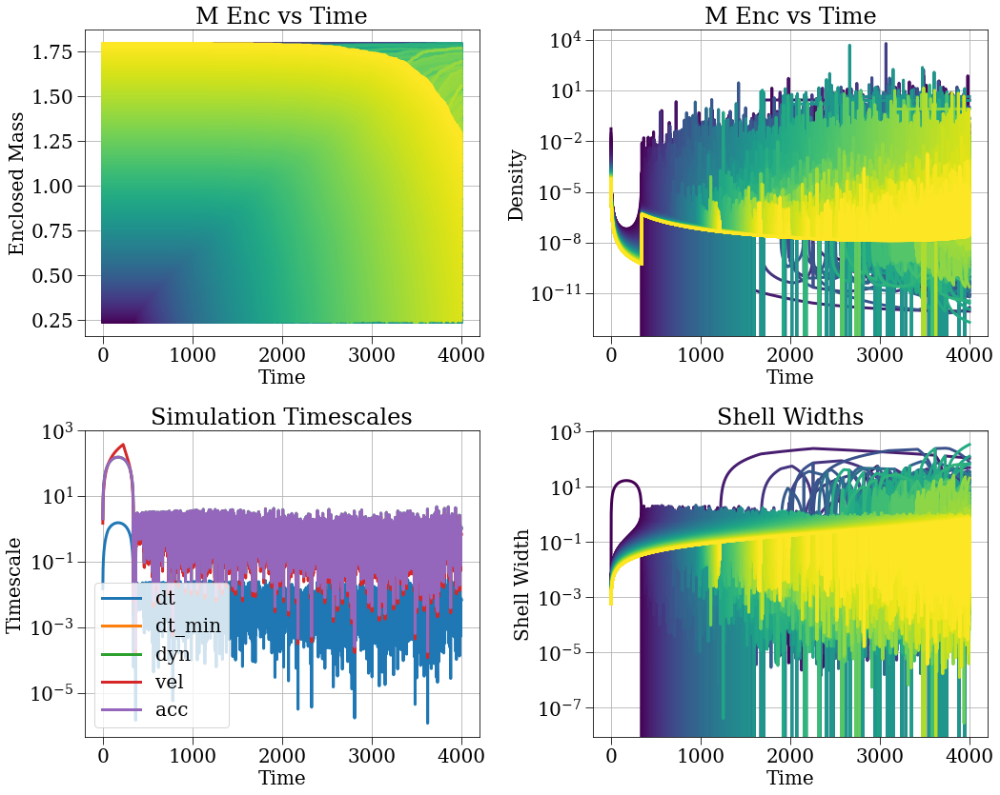

In [30]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/723-2.h5', r_small=1)
sc, results, plotter = run_sc(config, profile=False, plot=True)

In [ ]:
import numpy as np
import logging
import sys
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['axes.formatter.useoffset'] = False
import scipy.signal as sps
from pprint import pprint

sys.path.insert(1, '/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/')
sys.path.insert(1, '/home/jsipple/one_d_spherical_collapse/one-d-spherical-collapse-of-fuzzy-dark-matter/src')
import importlib
import simulation_strategies, collapse, plotting, utils, analtyic_formulas
importlib.reload(simulation_strategies)
importlib.reload(collapse)
importlib.reload(plotting)
importlib.reload(utils)
importlib.reload(analtyic_formulas)
from simulation_strategies import *
from collapse import *
from plotting import *
from utils import *
from analtyic_formulas import *
import cProfile
import pstats

import warnings
warnings.filterwarnings('ignore', category=np.VisibleDeprecationWarning)

In [ ]:
# Default plotting settings
def my_mpl():
    plt.rc('font', family='serif', size=20)
    plt.rc('axes', grid=True)
    plt.rc('lines', lw=3)
    ts = 8
    plt.rc('xtick.minor', size=ts-2)
    plt.rc('ytick.minor', size=ts-2)
    plt.rc('xtick.major', size=ts)
    plt.rc('ytick.major', size=ts)
    plt.rc('figure', figsize=[9, 5])
my_mpl()
logging.basicConfig(level=logging.DEBUG,
                    format='%(asctime)s - %(levelname)s - %(message)s')
logger = logging.getLogger(__name__)
logging.getLogger('matplotlib').setLevel(logging.ERROR)

In [ ]:
t_i = 1
G = 1
rho_H = 1/(6*np.pi*G*t_i**2)
H0 = 2/(3*t_i)

def compute_r0_min(r_min, r_max, N):
    """
    Compute r0_min such that the spacing dR in np.linspace(r0_min, r_max, N)
    satisfies dR = r0_min - r_min. That is, the inner edge of the innermost shell is at r_min.
    
    Parameters:
    - r_min (float): The minimum radius.
    - r_max (float): The maximum radius.
    - N (int): Number of points.
    
    Returns:
    - float: The computed r0_min.
    """
    return (r_max + r_min * (N - 1)) / N

def make_config(no_pm=False, **kwargs):
    # Set defaults directly in kwargs
    kwargs.setdefault('r_min', 0)
    kwargs.setdefault('r_max', 1)
    kwargs.setdefault('N', 1)
    kwargs.setdefault('H', 0)
    kwargs.setdefault('rho_bar', rho_H)
    kwargs.setdefault('delta', 0)
    kwargs.setdefault('j_coef', 0)
    kwargs.setdefault('r_min_strategy', 'nothing')
    kwargs.setdefault('t_max', 5000)
    kwargs.setdefault('dt_min', 0)
    kwargs.setdefault('stepper_strategy', 'leapfrog_kdk')
    kwargs.setdefault('timescale_strategy', 'dyn')
    kwargs.setdefault('save_strategy', 'vflip')
    kwargs.setdefault('safety_factor', 1e-2)
    kwargs.setdefault('save_dt', 1e-2)
    kwargs.setdefault('initial_radius_strategy', 'r0min_start_equal')
    kwargs.setdefault('m_enc_strategy', 'inclusive')
    kwargs.setdefault('density_strategy', 'background_plus_tophat2')
    kwargs.setdefault('timestep_strategy', 'simple_adaptive')
    kwargs.setdefault('problematic_shell_strategy', 'energy')
    kwargs.setdefault('energy_strategy', 'kin_grav_rot_absorbed')
    
    # Set r_th default after r_max is set
    kwargs.setdefault('tophat_radius', kwargs['r_max'])

    # Extract values for computation
    r_min = kwargs['r_min']
    r_max = kwargs['r_max']
    N = kwargs['N']
    rho_bar = kwargs['rho_bar']
    delta_i = kwargs['delta']
    r_th = kwargs['tophat_radius']
    j_coeff = kwargs['j_coef']
    reflect_bool = kwargs['r_min_strategy'] == 'reflect'

    # m_pert = rho_bar * delta_i * 4/3 * np.pi * min(r_max, r_th)**3
    # if no_pm:
    #     point_mass = 0
    #     shell_volume_strategy = 'keep_edges'
    # else:
    #     point_mass = 4/3 * np.pi * r_min**3 * rho_bar * (1+delta_i)
    #     shell_volume_strategy = 'inner_not_zero'

    r0_min = compute_r0_min(r_min=r_min, r_max=r_max, N=N)
    r_min_strategy = 'reflect' if reflect_bool else 'nothing'
    t_ta_strategy = 't_ta_cycloid'
    r_ta_strategy = 'r_ta_cycloid'
    ang_mom_strategy = 'const' if j_coeff > 0 else 'zero'

    # Start with all user-supplied kwargs (now with defaults), then update/override with computed values
    config = dict(kwargs)
    config.update({
        'r0_min': r0_min,
        'r_min_strategy': r_min_strategy,
        't_ta_strategy': t_ta_strategy,
        'r_ta_strategy': r_ta_strategy,
        'ang_mom_strategy': ang_mom_strategy,
    })
    return config

def run_sc(config, profile=False, plot=True):
    sc = SphericalCollapse(config)
    if profile:
        # Profile the run method
        profiler = cProfile.Profile()
        profiler.enable()
        results = sc.run()
        profiler.disable()
        # Print the profiling results
        stats = pstats.Stats(profiler).sort_stats('cumulative')
        stats.print_stats(50)  # Print top 50 time-consuming functions
    else:
        results = sc.run()
    if not plot:
        return sc, results, None
    plotter = SimulationPlotter(results, sc)
    plotter.plot_radius_analysis()
    plotter.plot_mass_density_timescales()
    return sc, results, plotter

In [ ]:
def find_turnaround_indices(results):
    r_data = results['r']
    
    # Find turnaround indices for each shell
    ta_indices = []
    for i in range(r_data.shape[1]):
        # Find indices of local maxima for this shell
        maxima_indices = argrelmax(r_data[:, i])[0]
        # If maxima found, use the first one; otherwise use None
        ta_idx = maxima_indices[0] if len(maxima_indices) > 0 else None
        ta_indices.append(ta_idx)
    
    # Process shells that have turnaround points
    valid_shells = [i for i in range(r_data.shape[1]) if ta_indices[i] is not None]
    
    if valid_shells:
        # Calculate r_ta and t_ta only for shells with turnaround points
        r_ta = np.zeros(r_data.shape[1])
        t_ta = np.zeros(r_data.shape[1])
        
        for i in valid_shells:
            r_ta[i] = r_data[ta_indices[i], i]
            t_ta[i] = results['t'][ta_indices[i]]
        r_normalized = np.zeros_like(r_data)
        for i in valid_shells:
            r_normalized[:, i] = r_data[:, i] / r_ta[i]
    return r_ta, t_ta, r_normalized

def plot_results(results, sc):
    r_ta, t_ta, r_normalized = find_turnaround_indices(results)

    tvals = results['t']
    rvals = results['r']
    mvals = results['m'][0,:]
    mvals_w_point_mass = mvals.copy()
    mvals_w_point_mass[0] += sc.point_mass
    mencvals = results['m_enc']
    #volvals = 4/3 * np.pi * np.array([np.diff(np.array([0, *rvals[i,:]]))**3 for i in range(len(rvals))])
    rhovals = results['rho_r']

    rho0 = results['rho_r'][0,:]
    #vol0 = volvals[0,:]
    rvals0 = rvals[0,:]
    menc0 = mencvals[0,:]

    upper_bounds = rvals0
    lower_bounds = np.array([1, *rvals0[:-1]])
    volumes = 4/3 * np.pi * (upper_bounds**3 - lower_bounds**3)

    cmap = plt.cm.viridis
    norm = mpl.colors.Normalize(vmin=0, vmax=999)  # assuming i goes from 0 to 999

    #plt.plot(rvals0, rho0/rho_H, label='initial profile')
    #plt.plot(rvals0, 1/rho_H * mvals_w_point_mass/vol0, label='initial mass density')
    plt.plot(rvals0, mvals/(rho_H * volumes), label='initial mass density')
    plt.xlabel('r')
    plt.ylabel(r'$\rho/\rho_H$')
    plt.yscale('log')
    plt.xscale('log')
    plt.legend()

    plt.figure()
    plt.plot(rvals0, menc0, label='initial enclosed mass')
    plt.xlabel('r')
    plt.ylabel(r'$M_{enc}$')
    plt.yscale('log')
    plt.xscale('log')
    plt.legend()

    plt.figure()
    for i in range(1000):
        color = cmap(norm(i))
        plt.plot(tvals, rvals[:,i], alpha=0.2, color=color, lw=1)

    plt.figure()
    for i in range(1000):
        color = cmap(norm(i))
        plt.semilogy(tvals, rvals[:,i], alpha=0.2, color=color, lw=1)

    plt.figure()
    print(tvals.shape, t_ta.shape)
    for i in range(1000):
        color = cmap(norm(i))
        plt.plot((tvals+1)/t_ta[i], r_normalized[:,i], alpha=0.2, color=color, lw=1)

    # 1. Create a grid of normalized time values
    n_points = 200
    norm_time_grid = np.linspace(
        0, 
        6, 
        n_points
    )

    mean_r = np.empty(n_points)
    std_r = np.empty(n_points)
    median_r = np.empty(n_points)

    for j, norm_time in enumerate(norm_time_grid):
        r_values_at_time = []
        for i in range(r_normalized.shape[1]):
            shell_norm_time = (tvals + 1) / t_ta[i]
            # Only interpolate if norm_time is within the shell's time range
            if norm_time >= shell_norm_time[0] and norm_time <= shell_norm_time[-1]:
                r_val = np.interp(norm_time, shell_norm_time, r_normalized[:, i])
                r_values_at_time.append(r_val)
        if r_values_at_time:
            mean_r[j] = np.mean(r_values_at_time)
            std_r[j] = np.std(r_values_at_time)
            median_r[j] = np.median(r_values_at_time)
        else:
            mean_r[j] = np.nan
            std_r[j] = np.nan

    # 2. Plot, skipping nan values
    valid = ~np.isnan(mean_r)
    plt.plot(norm_time_grid[valid], mean_r[valid], color='black', label='Mean', ls='--', lw=2)
    #plt.plot(norm_time_grid[valid], median_r[valid], color='red', label='Median', ls='--', lw=2)
    plt.plot(norm_time_grid[valid], mean_r[valid] - std_r[valid], color='red', label='1$\sigma$ band', ls=':')
    plt.plot(norm_time_grid[valid], mean_r[valid] + std_r[valid], color='red', ls=':')
    plt.legend()
    plt.ylim(0, 2)

    plt.figure()
    plt.plot(norm_time_grid[valid], std_r[valid]/mean_r[valid], color='black', label=r'$\sigma$/mean', ls='-', lw=2)
    plt.yscale('log')
    plt.legend()

    num_divisions = 5
    for i in range(num_divisions):
        tval = tvals[-1]/num_divisions * (i+1)
        idx = np.argmin(np.abs(tvals - tval))
        rho = results['rho_r'][idx,:]
        rval = rvals[idx,:]
        menc = mencvals[idx,:]


        sorted_indices = np.argsort(rval)
        rval = rval[sorted_indices]
        rho = rho[sorted_indices]
        menc = menc[sorted_indices]
        mvals = mvals[sorted_indices]
        upper_bounds = rval
        lower_bounds = np.array([1, *rval[:-1]])
        vol = 4/3 * np.pi * (upper_bounds**3 - lower_bounds**3)
        
        plt.figure()
        
        plt.plot(rval[1:], mvals[1:]/(rho_H * (tval+1)**-2 * vol[1:]), label=f't={int(tval)}')
        plt.xlabel('r')
        plt.ylabel(r'$\rho/\rho_H$')
        plt.yscale('log')
        plt.xscale('log')
        plt.legend()

        plt.figure()
        plt.plot(rval, menc, label=f't={int(tval)}')
        plt.xlabel('r')
        plt.ylabel(r'$M_{enc}$')
        plt.yscale('log')
        plt.xscale('log')
        plt.legend()

In [ ]:
r_max = 2
j_coef = 1e-2
N = 10_000
t_max = 1000
safety_factor = 1e-2
save_dt = 1
delta = 1e-2
irs = 'equal_mass'#'r0min_start_equal'
ivs = 'hubble'
density_strategy = 'background_plus_power_law'
tss = 'dyn_vel_acc'
# mes = 'const_inclusive'
r_min = 1
gamma = -2.5

In [ ]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/723-3.h5', r_small=1)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 10000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.0001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': 'runs/723-3.h5',
 'save_

2025-07-23 20:17:13,010 - collapse - INFO - Simulation setup complete


{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': 'runs/723-2.h5',
 'save_st

2025-07-23 19:05:24,554 - collapse - INFO - Simulation setup complete


2025-07-23 19:59:37,363 - DEBUG - Saved dataset t with shape (3947,)
2025-07-23 19:59:37,365 - DEBUG - Saved dataset dt with shape (3947,)


2025-07-23 19:59:37,515 - DEBUG - Saved dataset r with shape (3947, 1000)
2025-07-23 19:59:37,562 - DEBUG - Saved dataset v with shape (3947, 1000)
2025-07-23 19:59:37,670 - DEBUG - Saved dataset a with shape (3947, 1000)
2025-07-23 19:59:37,793 - DEBUG - Saved dataset m_enc with shape (3947, 1000)
2025-07-23 19:59:37,880 - DEBUG - Saved dataset rho_r with shape (3947, 1000)
2025-07-23 19:59:37,881 - WARNING - Skipping pressure because all values are None
2025-07-23 19:59:37,883 - WARNING - Skipping dpressure_drho because all values are None
2025-07-23 19:59:37,884 - WARNING - Skipping rho_prime because all values are None
2025-07-23 19:59:37,960 - DEBUG - Saved dataset e_tot with shape (3947, 1000)
2025-07-23 19:59:38,030 - DEBUG - Saved dataset e_g with shape (3947, 1000)
2025-07-23 19:59:38,104 - DEBUG - Saved dataset e_k with shape (3947, 1000)
2025-07-23 19:59:38,189 - DEBUG - Saved dataset e_r with shape (3947, 1000)
2025-07-23 19:59:38,191 - WARNING - Skipping e_p because all va

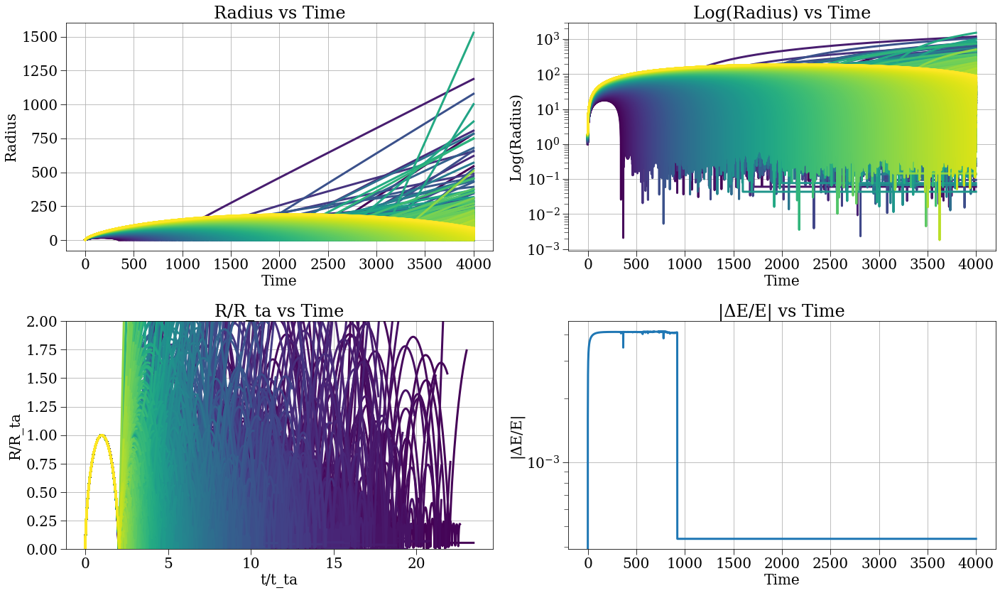

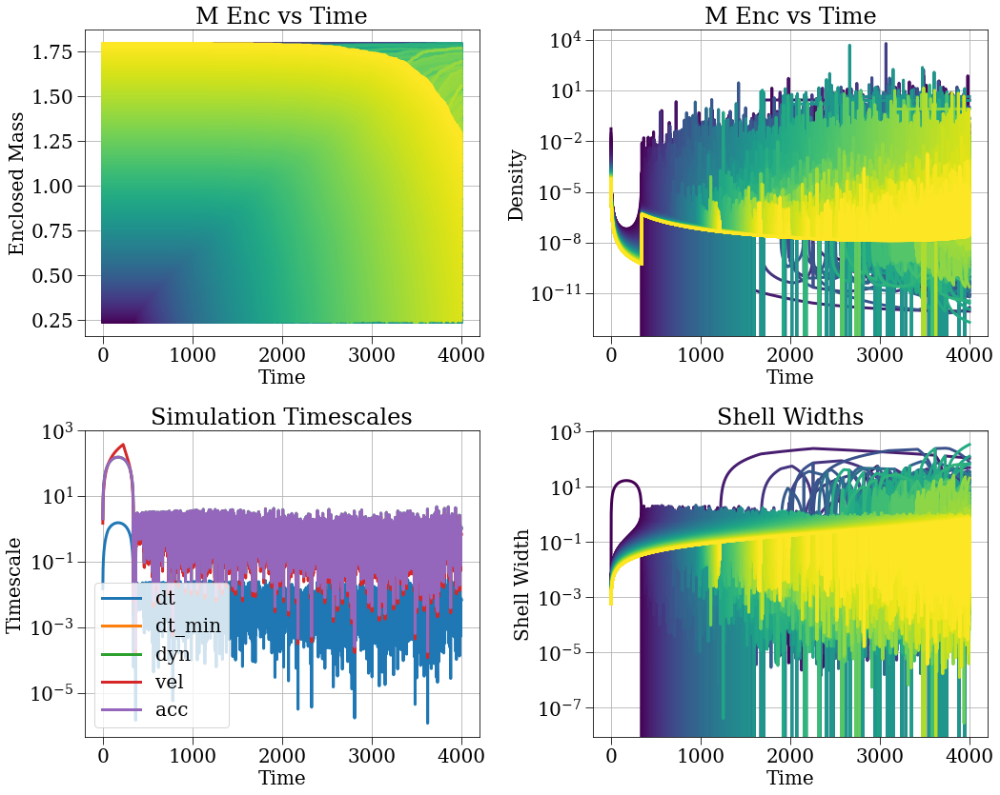

In [ ]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/723-2.h5', r_small=1)
sc, results, plotter = run_sc(config, profile=False, plot=True)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 0.501,
 'r_max': 1.5,
 'r_min': 0.5,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': 'runs/723-1.h5',
 'sav

2025-07-23 18:21:24,010 - collapse - INFO - Simulation setup complete


2025-07-23 18:50:16,255 - DEBUG - Saved dataset t with shape (1001,)
2025-07-23 18:50:16,257 - DEBUG - Saved dataset dt with shape (1001,)
2025-07-23 18:50:16,307 - DEBUG - Saved dataset r with shape (1001, 1000)
2025-07-23 18:50:16,328 - DEBUG - Saved dataset v with shape (1001, 1000)
2025-07-23 18:50:16,357 - DEBUG - Saved dataset a with shape (1001, 1000)
2025-07-23 18:50:16,386 - DEBUG - Saved dataset m_enc with shape (1001, 1000)


2025-07-23 18:50:16,409 - DEBUG - Saved dataset rho_r with shape (1001, 1000)
2025-07-23 18:50:16,410 - WARNING - Skipping pressure because all values are None
2025-07-23 18:50:16,411 - WARNING - Skipping dpressure_drho because all values are None
2025-07-23 18:50:16,413 - WARNING - Skipping rho_prime because all values are None
2025-07-23 18:50:16,436 - DEBUG - Saved dataset e_tot with shape (1001, 1000)
2025-07-23 18:50:16,461 - DEBUG - Saved dataset e_g with shape (1001, 1000)
2025-07-23 18:50:16,490 - DEBUG - Saved dataset e_k with shape (1001, 1000)
2025-07-23 18:50:16,518 - DEBUG - Saved dataset e_r with shape (1001, 1000)
2025-07-23 18:50:16,519 - WARNING - Skipping e_p because all values are None
2025-07-23 18:50:16,520 - WARNING - Skipping e_q because all values are None
2025-07-23 18:50:16,521 - DEBUG - Saved dataset t_dyn with shape (1001,)
2025-07-23 18:50:16,540 - DEBUG - Saved dataset t_vel with shape (1001,)
2025-07-23 18:50:16,541 - DEBUG - Saved dataset t_acc with shap

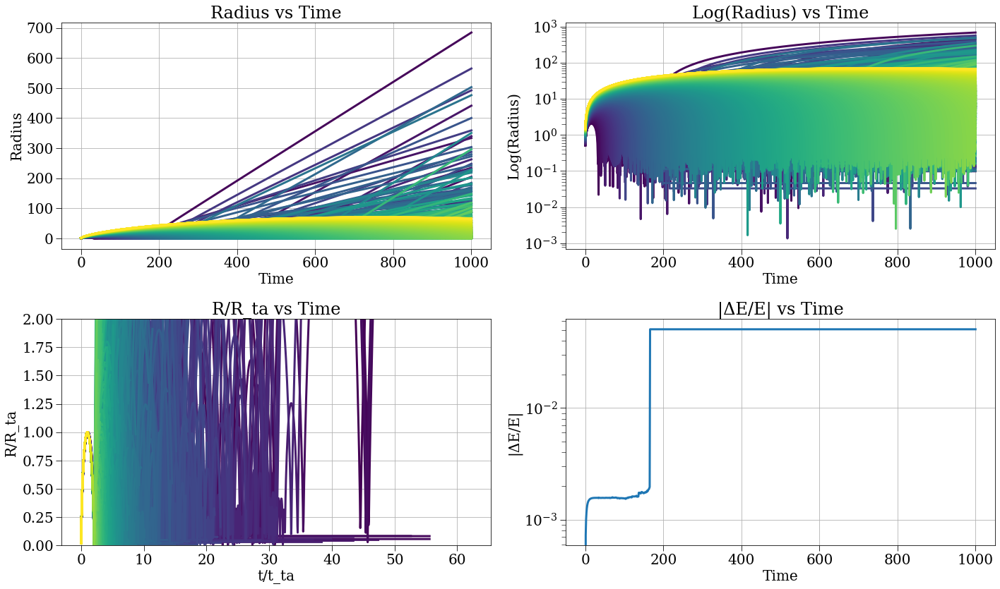

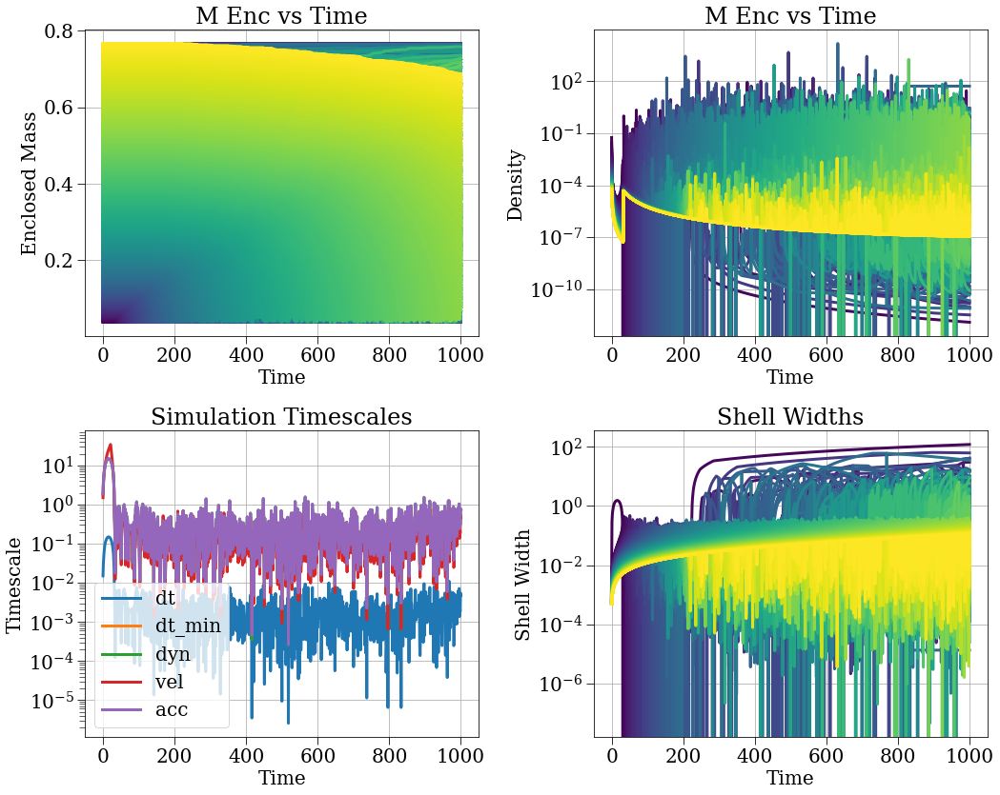

In [ ]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/723-1.h5', r_small=1)
sc, results, plotter = run_sc(config, profile=False, plot=True)

In [ ]:
menc = results['m_enc']
rvals = results['r']
print(np.argmin(np.abs(rvals[0]-1)))
print(rvals[0,295])
menc[0,295]

306
0.9868773800381836


0.22683365581272047

(948,) (1000,)


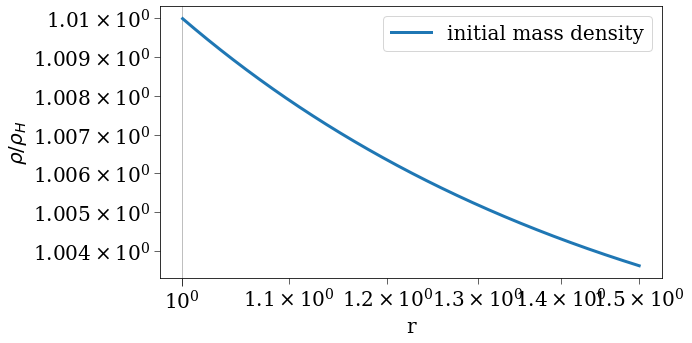

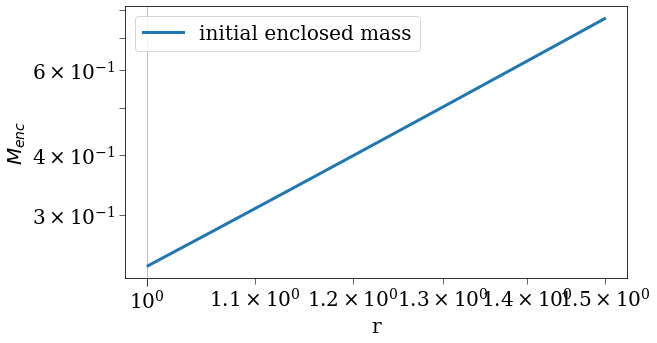

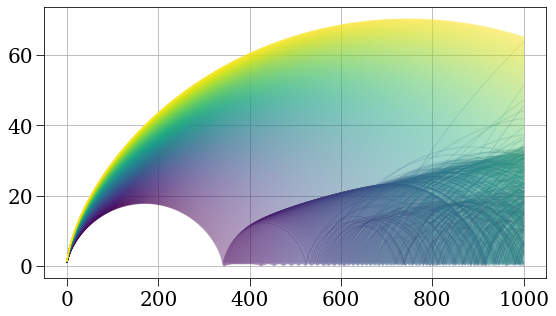

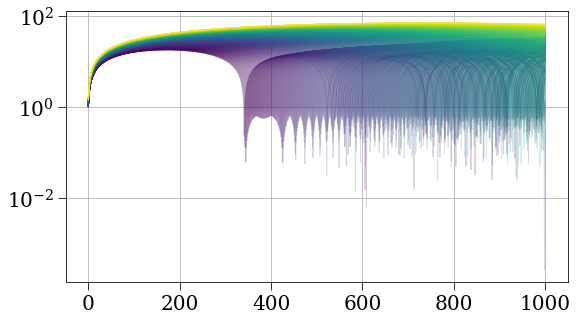

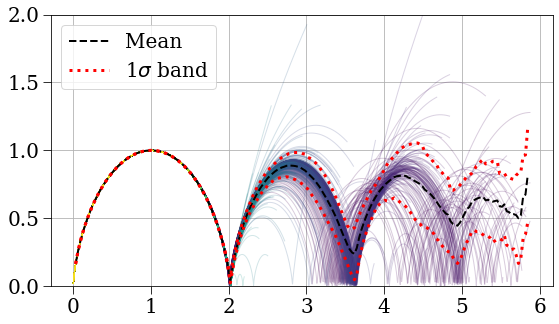

...

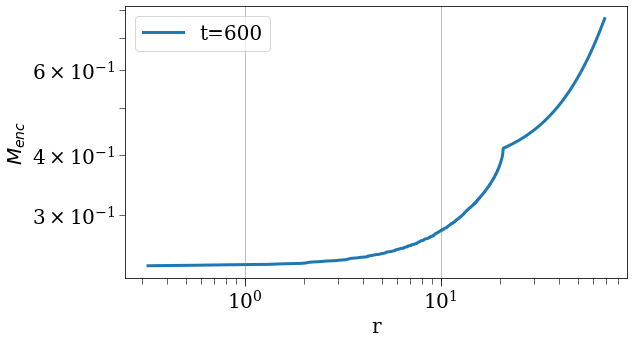

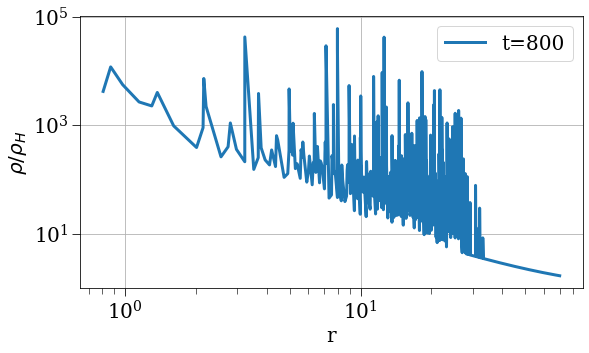

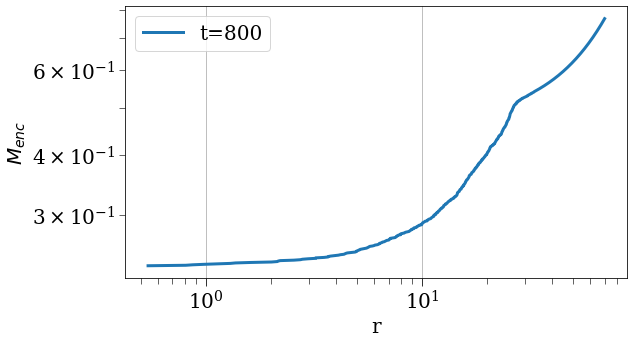

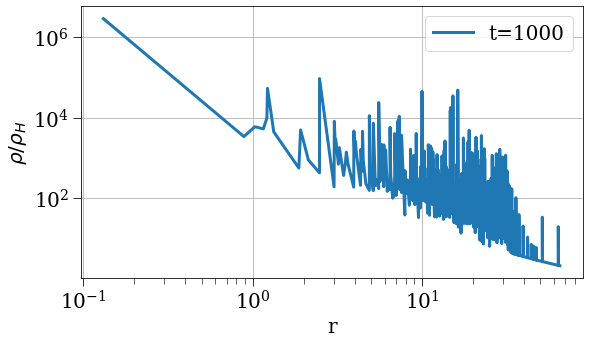

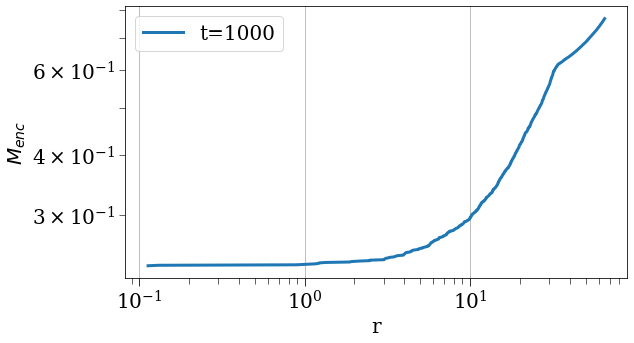

In [79]:
plot_results(results, sc)

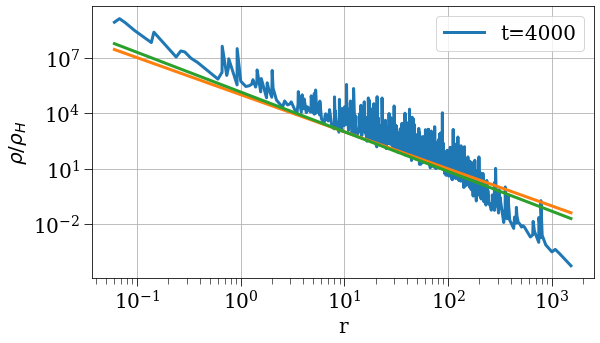

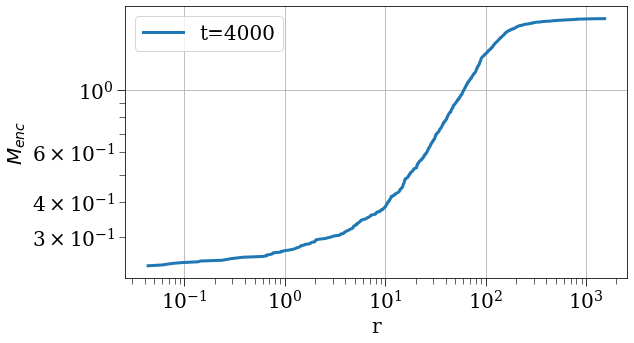

In [ ]:
num_divisions = 1
tvals = results['t']
rvals = results['r']
mvals = results['m'][:,0]
mencvals = results['m_enc']

tval = tvals[-1]
idx = np.argmin(np.abs(tvals - tval))
rho = results['rho_r'][idx,:]
rval = rvals[idx,:]
menc = mencvals[idx,:]


sorted_indices = np.argsort(rval)
rval = rval[sorted_indices]
rho = rho[sorted_indices]
menc = menc[sorted_indices]
mvals = mvals[sorted_indices]
upper_bounds = rval
lower_bounds = np.array([1, *rval[:-1]])
vol = 4/3 * np.pi * (upper_bounds**3 - lower_bounds**3)

plt.figure()

plt.plot(rval[1:], mvals[1:]/(rho_H * (tval+1)**-2 * vol[1:]), label=f't={int(tval)}')
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.yscale('log')
plt.xscale('log')
plt.legend()
scale, pivot = 1e3, 1e1
plt.plot(rval[1:], scale*(rval[1:]/pivot)**-2, label=f't={int(tval)}')
plt.plot(rval[1:], scale*(rval[1:]/pivot)**(-15/7), label=f't={int(tval)}')

plt.figure()
plt.plot(rval, menc, label=f't={int(tval)}')
plt.xlabel('r')
plt.ylabel(r'$M_{enc}$')
plt.yscale('log')
plt.xscale('log')
plt.legend()

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 0.501,
 'r_max': 1.5,
 'r_min': 0.5,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': 'runs/723-1.h5',
 'sav

2025-07-23 18:21:24,010 - collapse - INFO - Simulation setup complete


2025-07-23 18:50:16,255 - DEBUG - Saved dataset t with shape (1001,)
2025-07-23 18:50:16,257 - DEBUG - Saved dataset dt with shape (1001,)
2025-07-23 18:50:16,307 - DEBUG - Saved dataset r with shape (1001, 1000)
2025-07-23 18:50:16,328 - DEBUG - Saved dataset v with shape (1001, 1000)
2025-07-23 18:50:16,357 - DEBUG - Saved dataset a with shape (1001, 1000)
2025-07-23 18:50:16,386 - DEBUG - Saved dataset m_enc with shape (1001, 1000)


2025-07-23 18:50:16,409 - DEBUG - Saved dataset rho_r with shape (1001, 1000)
2025-07-23 18:50:16,410 - WARNING - Skipping pressure because all values are None
2025-07-23 18:50:16,411 - WARNING - Skipping dpressure_drho because all values are None
2025-07-23 18:50:16,413 - WARNING - Skipping rho_prime because all values are None
2025-07-23 18:50:16,436 - DEBUG - Saved dataset e_tot with shape (1001, 1000)
2025-07-23 18:50:16,461 - DEBUG - Saved dataset e_g with shape (1001, 1000)
2025-07-23 18:50:16,490 - DEBUG - Saved dataset e_k with shape (1001, 1000)
2025-07-23 18:50:16,518 - DEBUG - Saved dataset e_r with shape (1001, 1000)
2025-07-23 18:50:16,519 - WARNING - Skipping e_p because all values are None
2025-07-23 18:50:16,520 - WARNING - Skipping e_q because all values are None
2025-07-23 18:50:16,521 - DEBUG - Saved dataset t_dyn with shape (1001,)
2025-07-23 18:50:16,540 - DEBUG - Saved dataset t_vel with shape (1001,)
2025-07-23 18:50:16,541 - DEBUG - Saved dataset t_acc with shap

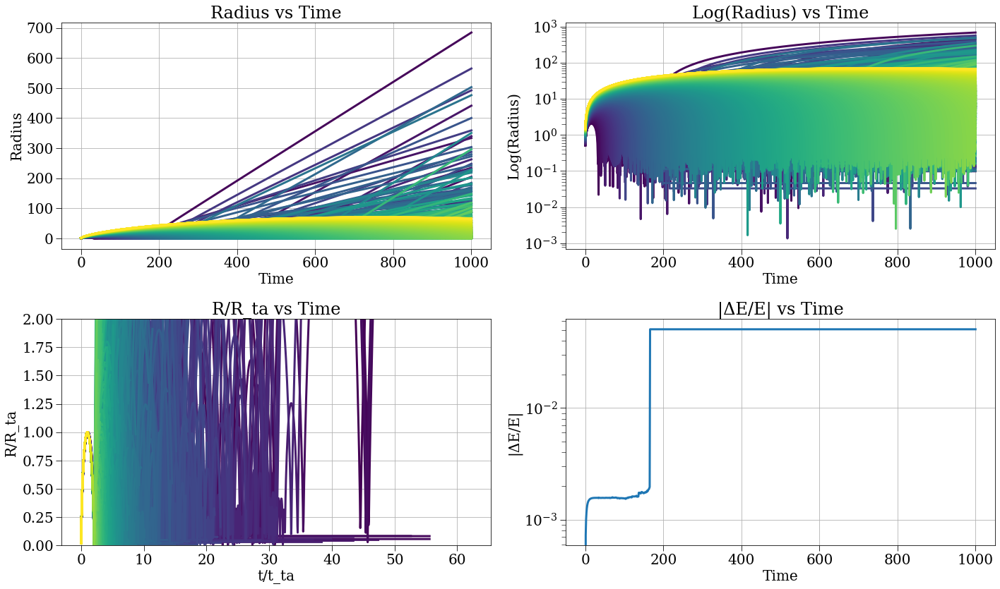

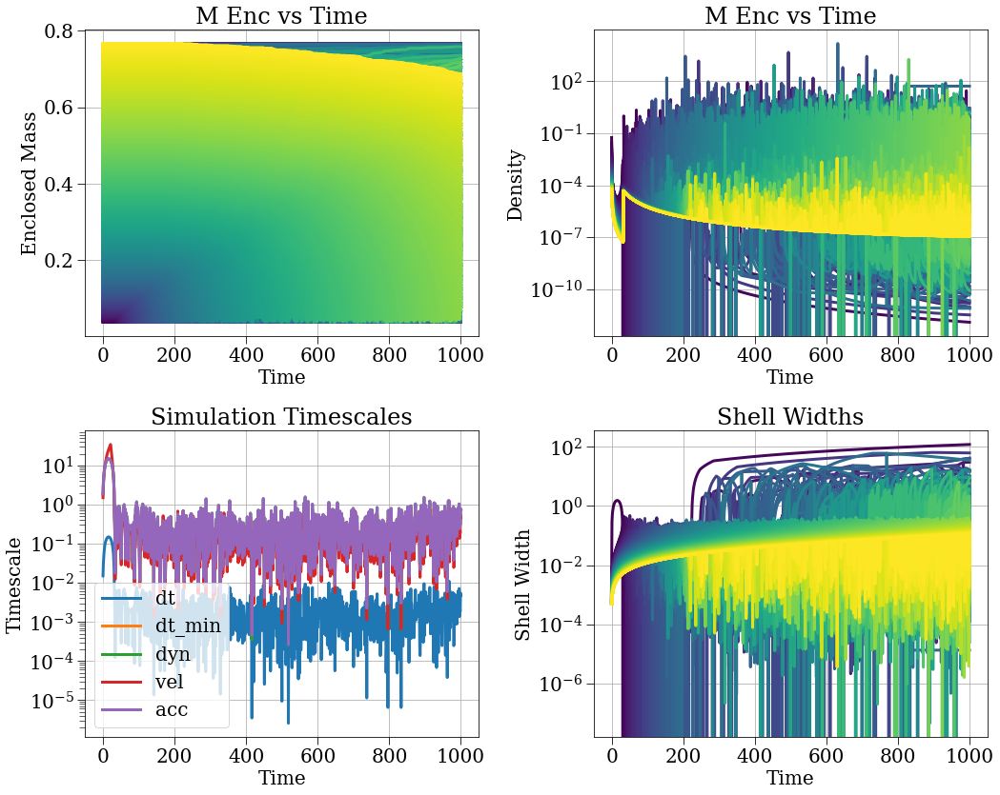

In [6]:
config = make_config(N=N, r_min=r_min, r_max=r_max, t_max=t_max, j_coef=j_coef, save_dt=save_dt, density_strategy=density_strategy, delta=delta, safety_factor=safety_factor, stepper_strategy='leapfrog_hut',  timescale_strategy=tss, H=H0, initial_radius_strategy=irs, gamma=gamma, initial_v_strategy=ivs, save_filename='runs/723-1.h5', r_small=1)
sc, results, plotter = run_sc(config, profile=False, plot=True)

In [7]:
menc = results['m_enc']
rvals = results['r']
print(np.argmin(np.abs(rvals[0]-1)))
print(rvals[0,295])
menc[0,295]

306
0.9868773800381836


0.22683365581272047

(2718,) (1000,)


/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:84: RuntimeWarning: divide by zero encountered in true_divide
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:84: RuntimeWarning: divide by zero encountered in true_divide
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:84: RuntimeWarning: divide by zero encountered in true_divide
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:84: RuntimeWarning: divide by zero encountered in true_divide
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:84: RuntimeWarning: divide by zero encountered in true_divide
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:84: RuntimeWarning: divide by zero encountered in true_divide
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:84: RuntimeWarning: divide by zero encou

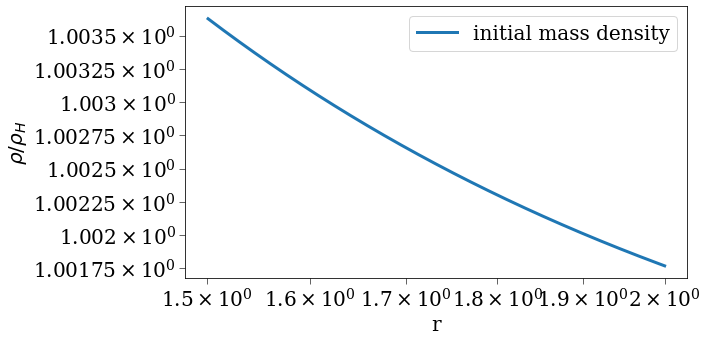

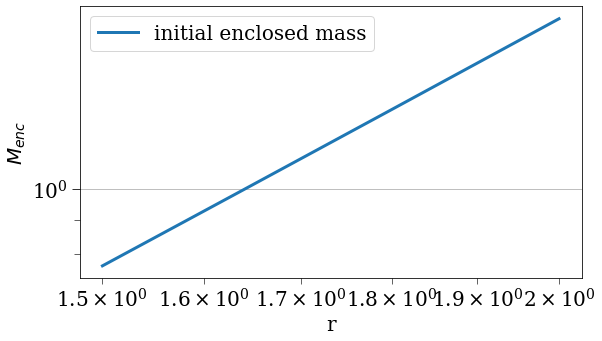

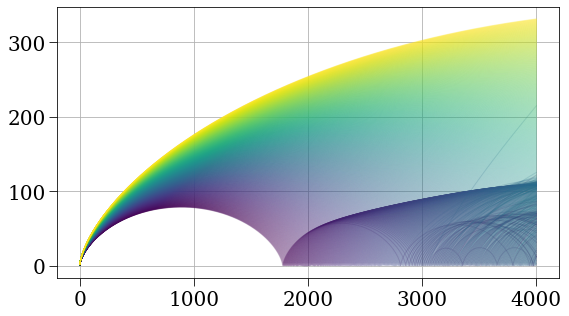

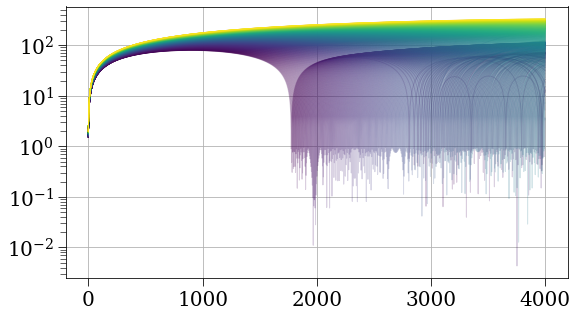

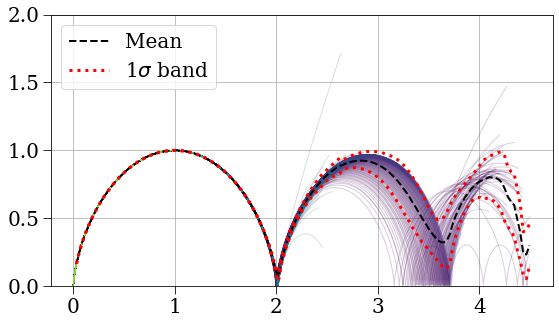

...

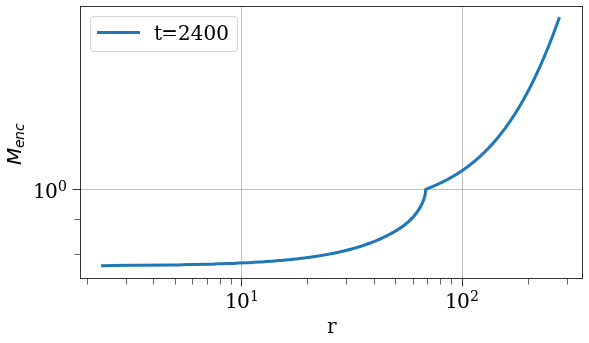

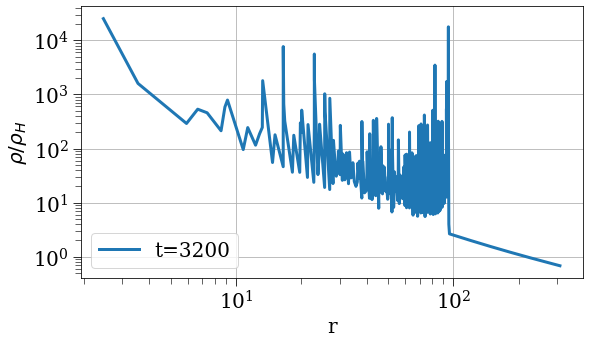

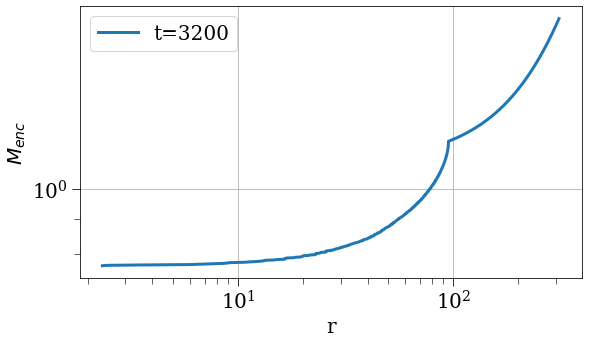

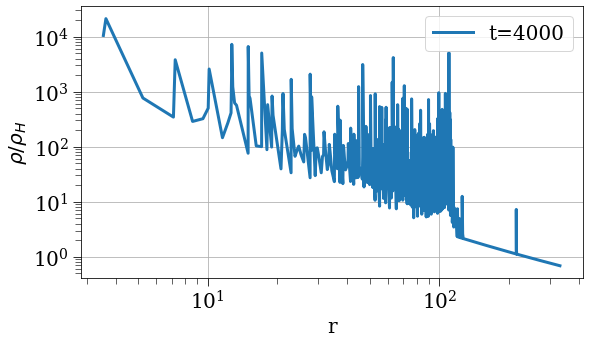

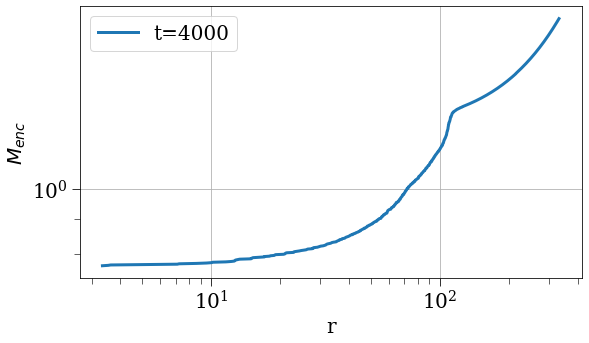

In [13]:
plot_results(results, sc)

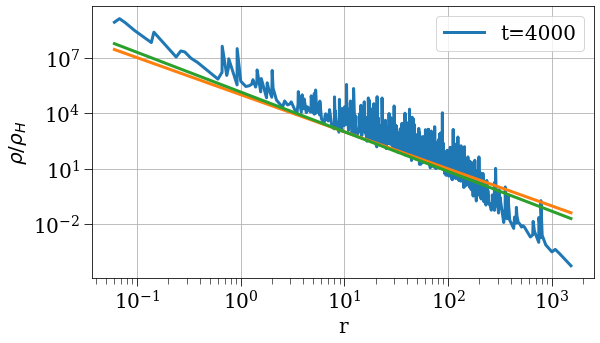

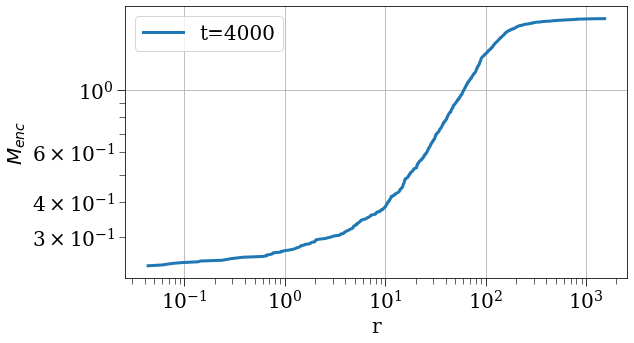

In [42]:
num_divisions = 1
tvals = results['t']
rvals = results['r']
mvals = results['m'][:,0]
mencvals = results['m_enc']

tval = tvals[-1]
idx = np.argmin(np.abs(tvals - tval))
rho = results['rho_r'][idx,:]
rval = rvals[idx,:]
menc = mencvals[idx,:]


sorted_indices = np.argsort(rval)
rval = rval[sorted_indices]
rho = rho[sorted_indices]
menc = menc[sorted_indices]
mvals = mvals[sorted_indices]
upper_bounds = rval
lower_bounds = np.array([1, *rval[:-1]])
vol = 4/3 * np.pi * (upper_bounds**3 - lower_bounds**3)

plt.figure()

plt.plot(rval[1:], mvals[1:]/(rho_H * (tval+1)**-2 * vol[1:]), label=f't={int(tval)}')
plt.xlabel('r')
plt.ylabel(r'$\rho/\rho_H$')
plt.yscale('log')
plt.xscale('log')
plt.legend()
scale, pivot = 1e3, 1e1
plt.plot(rval[1:], scale*(rval[1:]/pivot)**-2, label=f't={int(tval)}')
plt.plot(rval[1:], scale*(rval[1:]/pivot)**(-15/7), label=f't={int(tval)}')

plt.figure()
plt.plot(rval, menc, label=f't={int(tval)}')
plt.xlabel('r')
plt.ylabel(r'$M_{enc}$')
plt.yscale('log')
plt.xscale('log')
plt.legend()

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 0.501,
 'r_max': 1.5,
 'r_min': 0.5,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': 'runs/723-1.h5',
 'sav

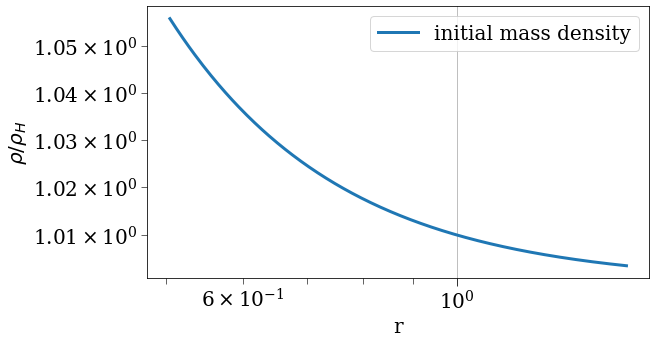

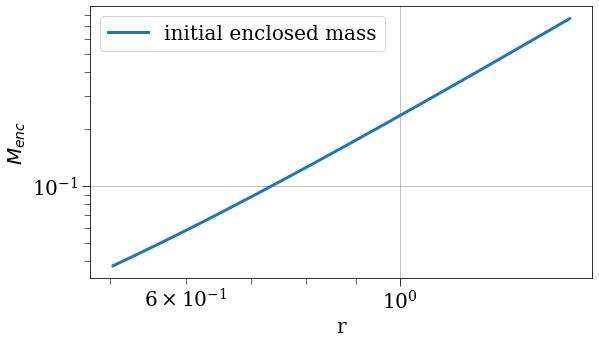

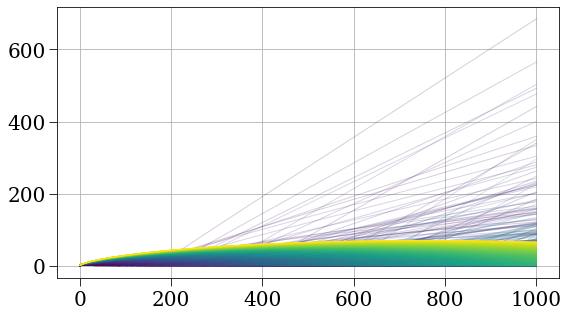

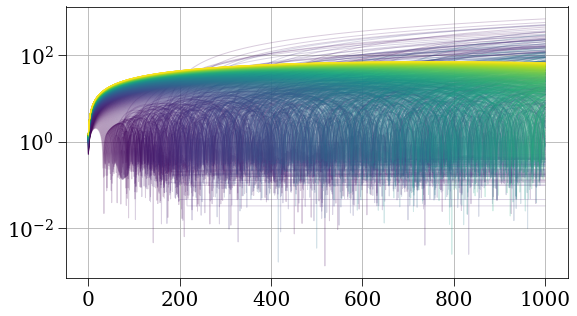

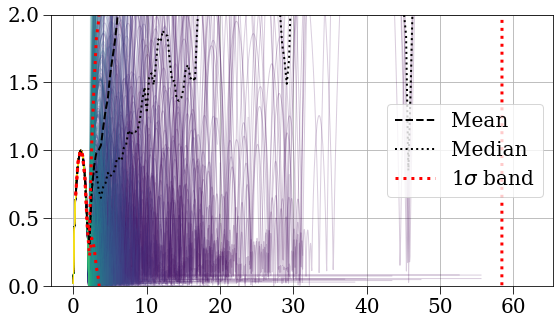

...

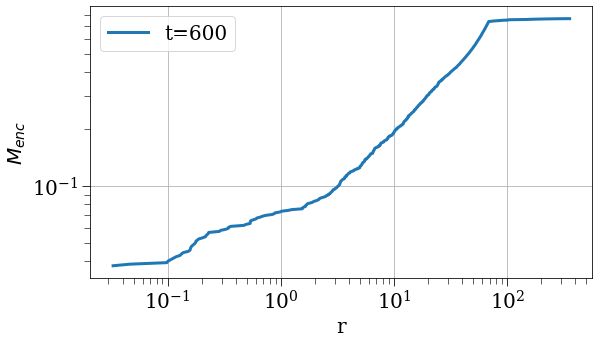

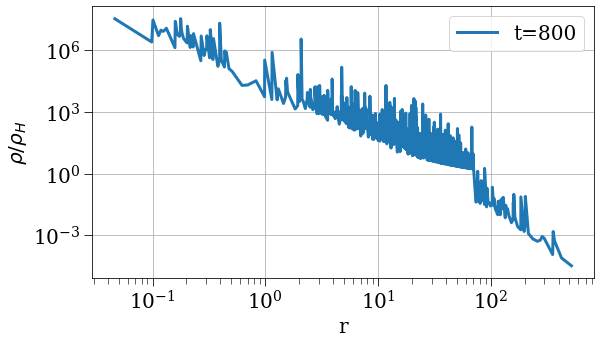

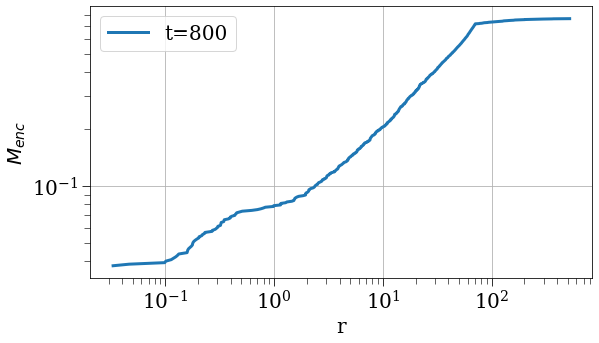

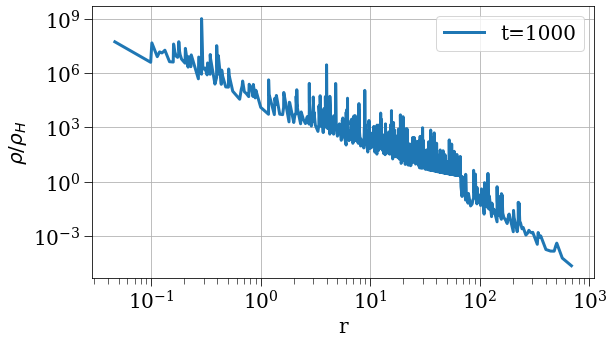

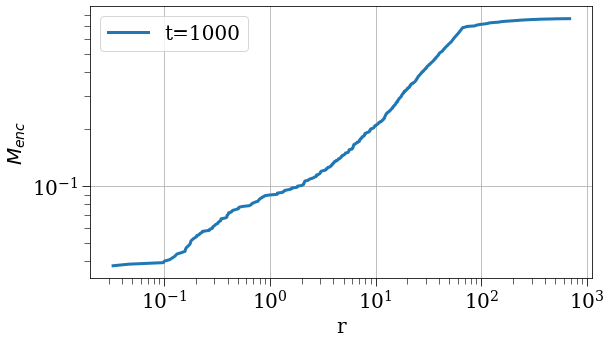

In [7]:
filename = f'runs/723-1.h5'
params, results = load_simulation_data(filename)
pprint(params)
plot_results(results, sc=None, params=params)

In [ ]:
rho = rho_H * (1 + delta*(r/0.5)**-2.5)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': 'runs/723-2.h5',
 'save_st

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/events.py:88: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


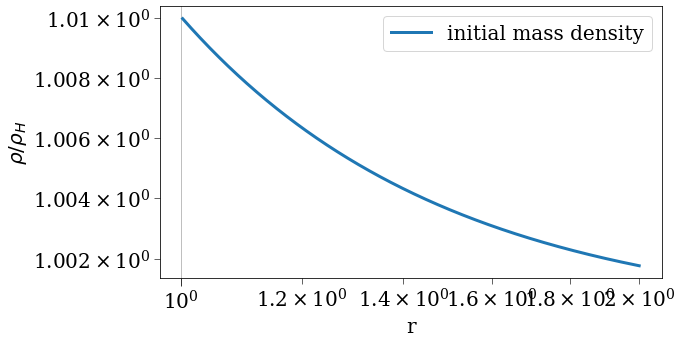

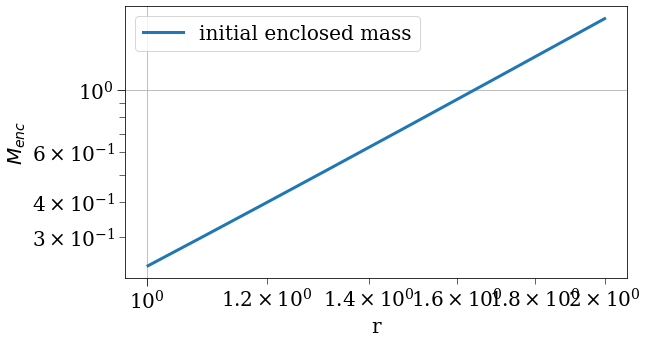

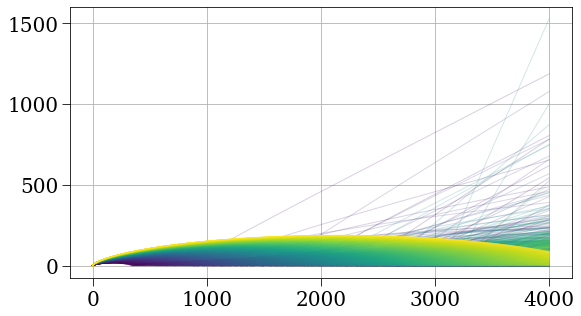

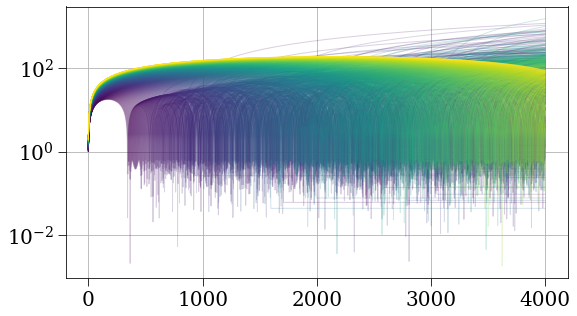

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


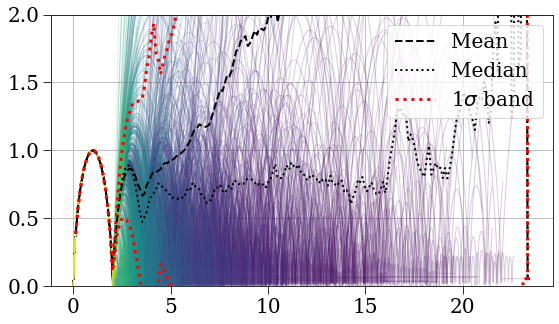

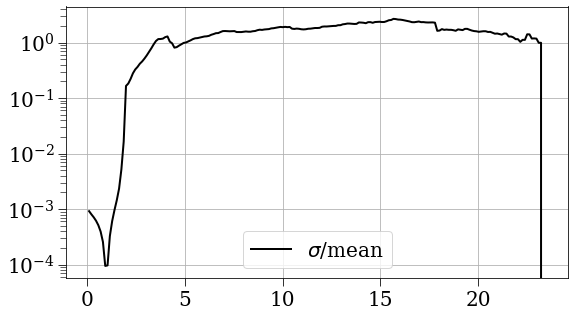

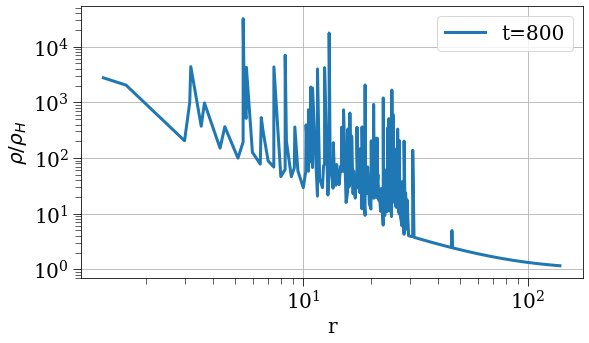

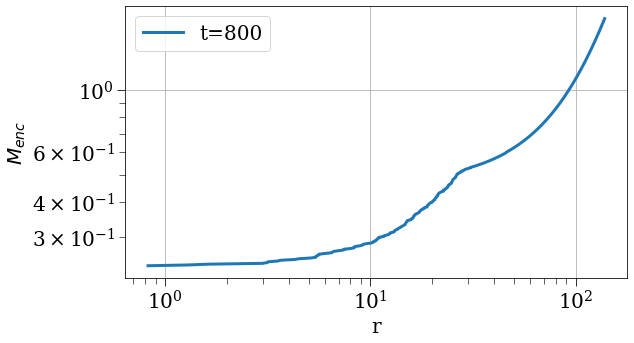

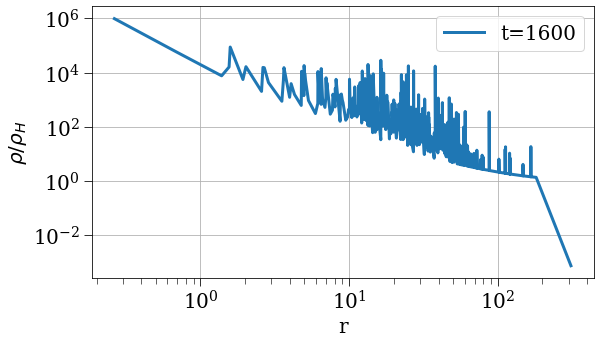

...

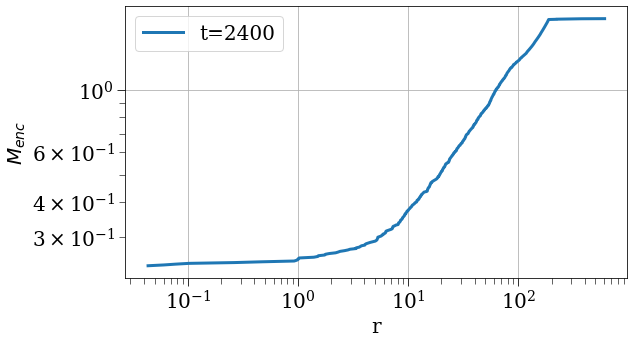

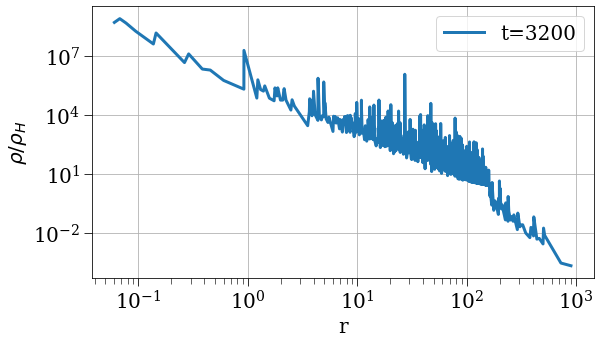

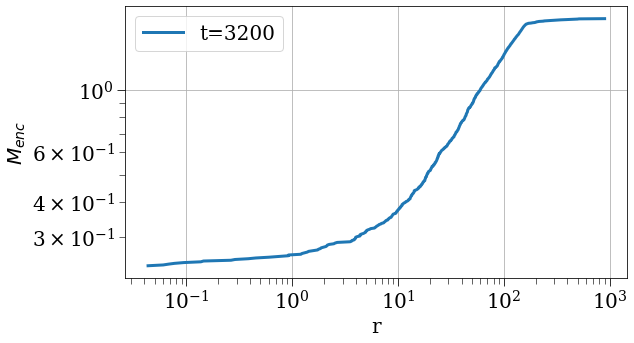

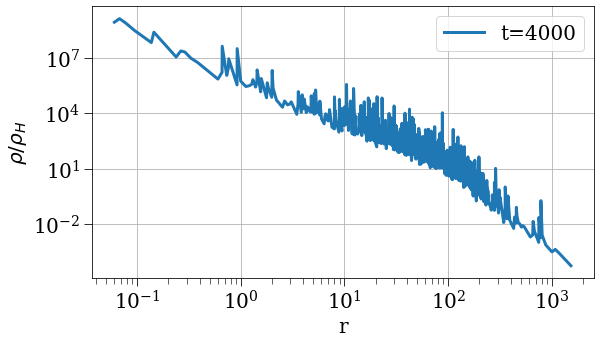

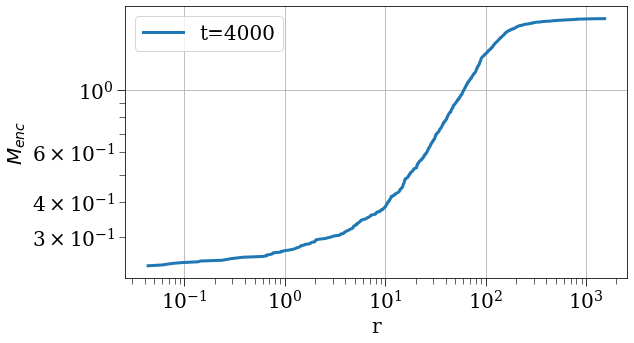

In [8]:
filename = f'runs/723-2.h5'
params, results = load_simulation_data(filename)
pprint(params)
plot_results(results, sc=None, params=params)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.0005,
 'r_max': 1.5,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': 'runs/723-3.h5',
 'save_strategy': 'vf

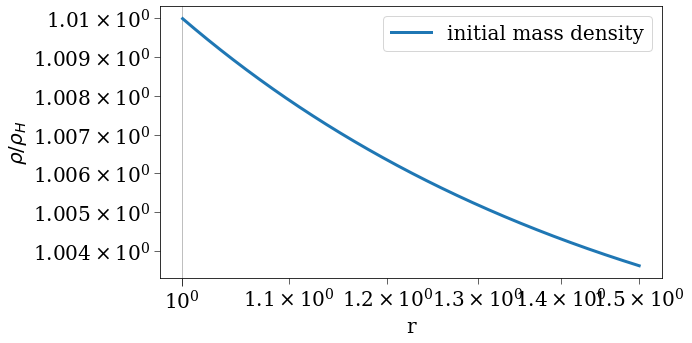

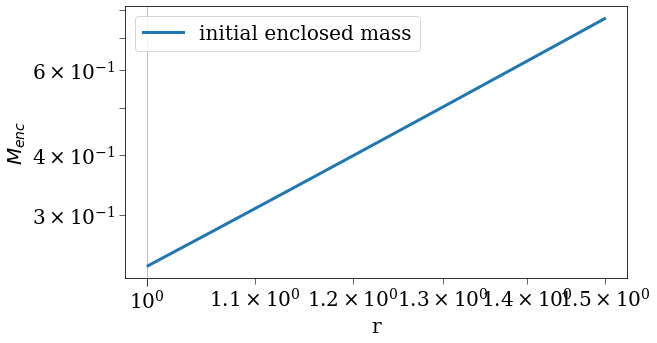

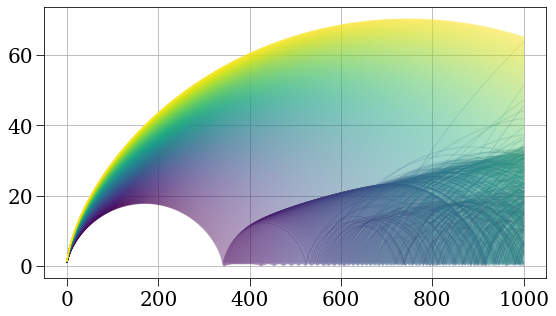

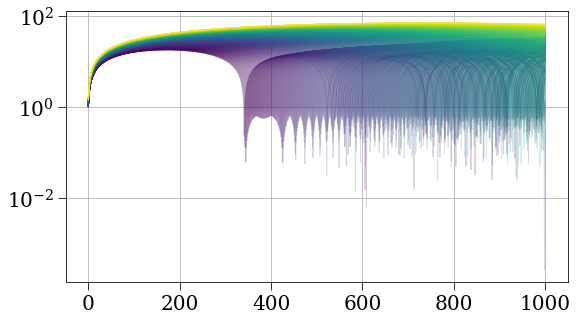

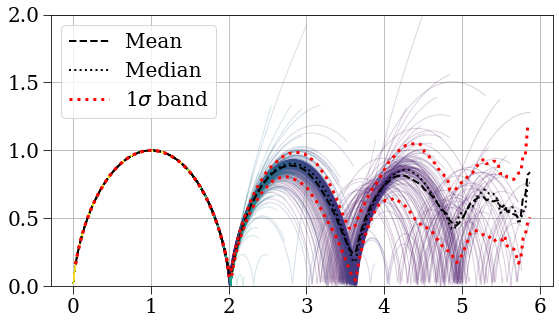

...

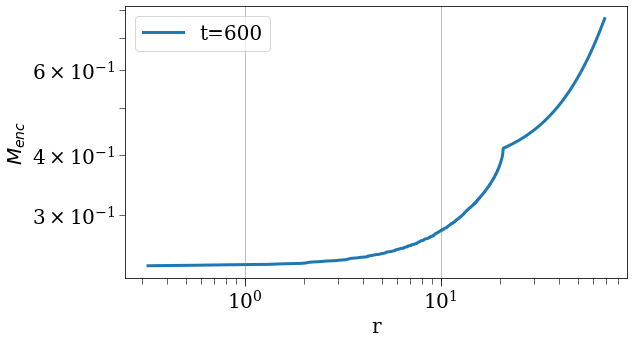

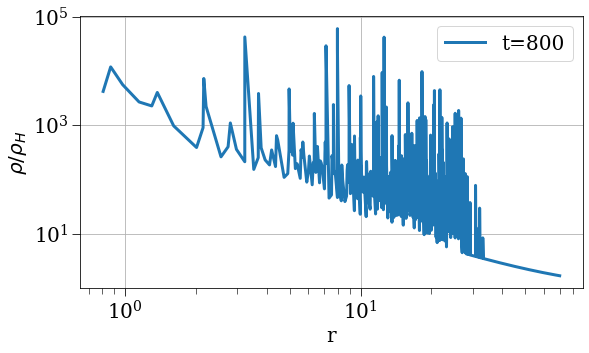

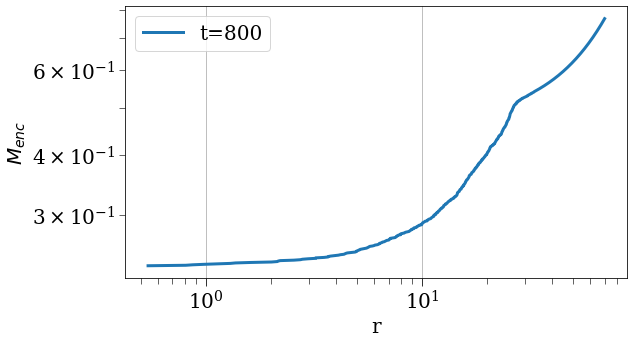

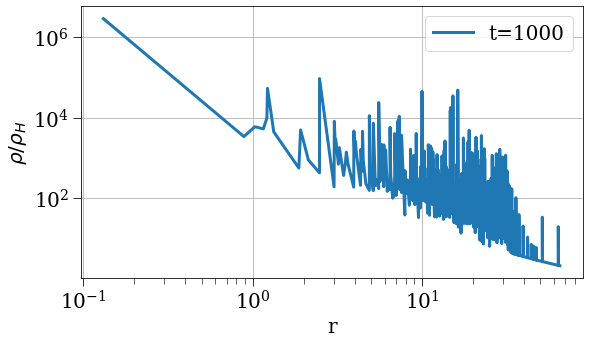

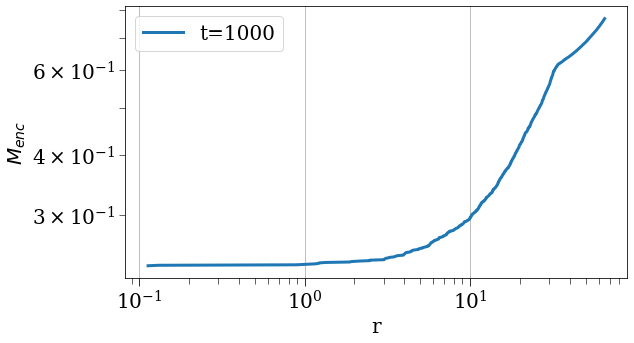

In [9]:
filename = f'runs/723-3.h5'
params, results = load_simulation_data(filename)
pprint(params)
plot_results(results, sc=None, params=params)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'gmr',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.5005,
 'r_max': 2,
 'r_min': 1.5,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': 'runs/723-4.h5',
 'save_s

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encountered in true_divide
/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/ipykernel_launcher.py:90: RuntimeWarning: divide by zero encou

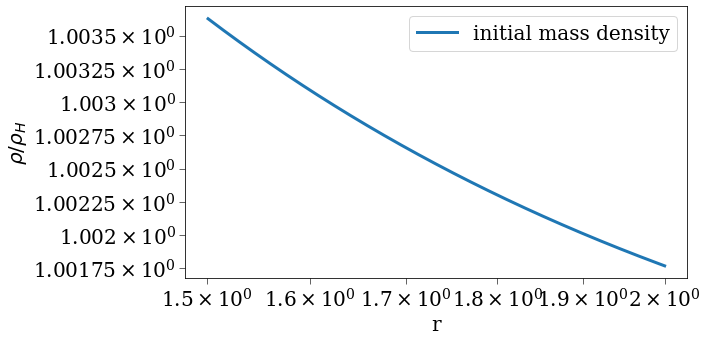

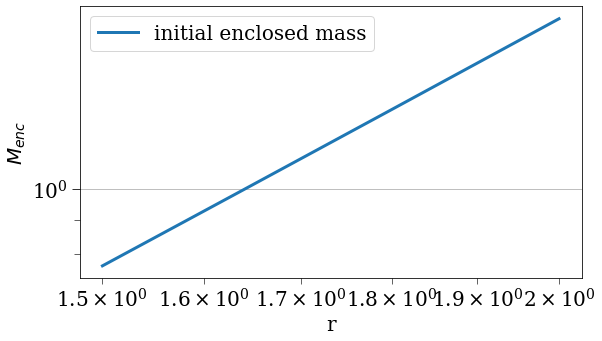

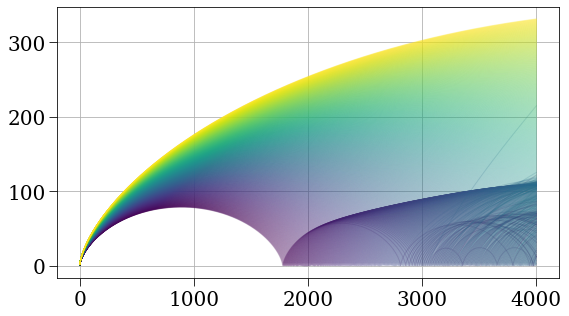

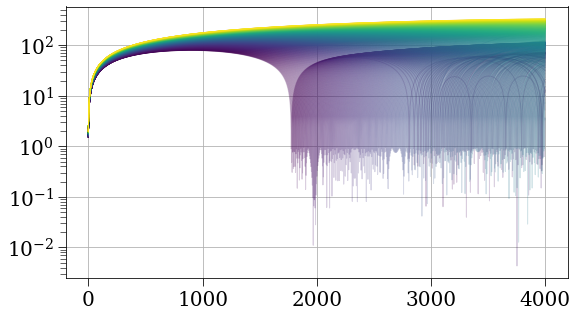

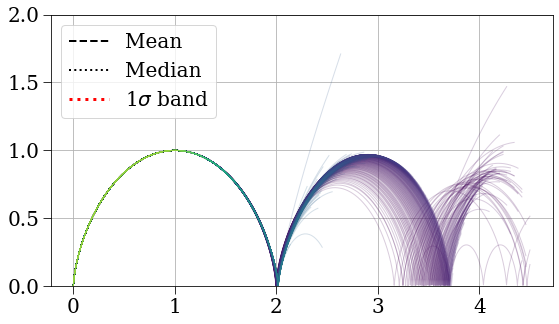

...

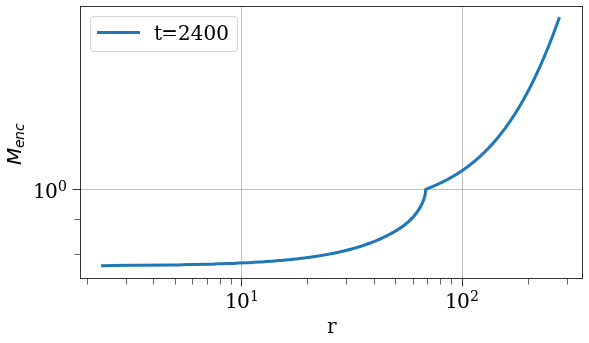

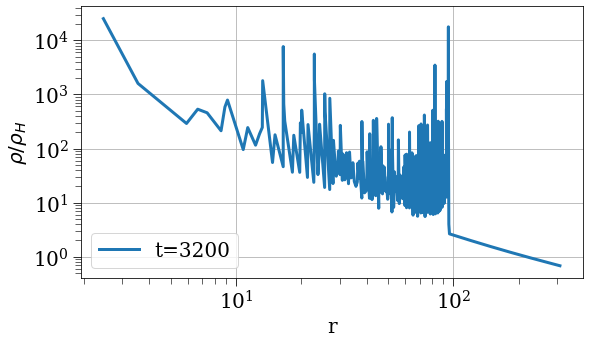

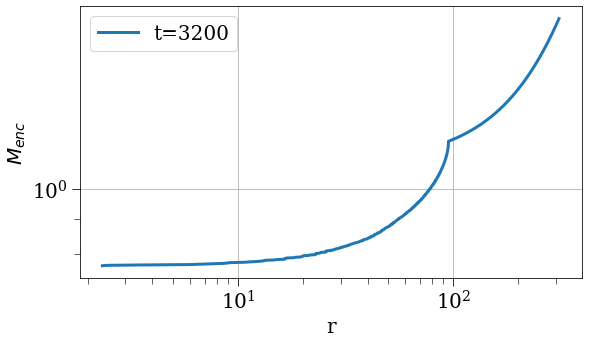

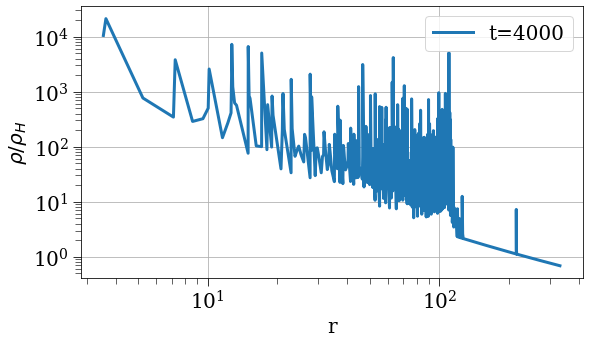

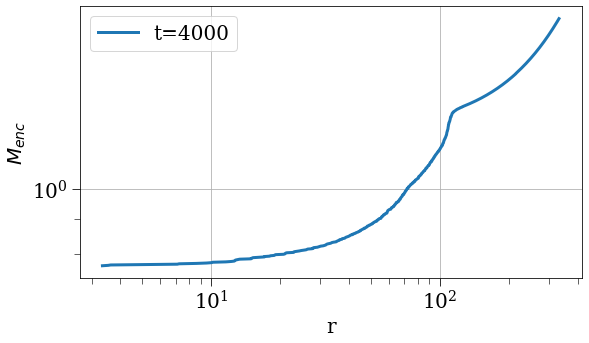

In [10]:
filename = f'runs/723-4.h5'
params, results = load_simulation_data(filename)
pprint(params)
plot_results(results, sc=None, params=params)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft_all',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.7,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': 'runs/723

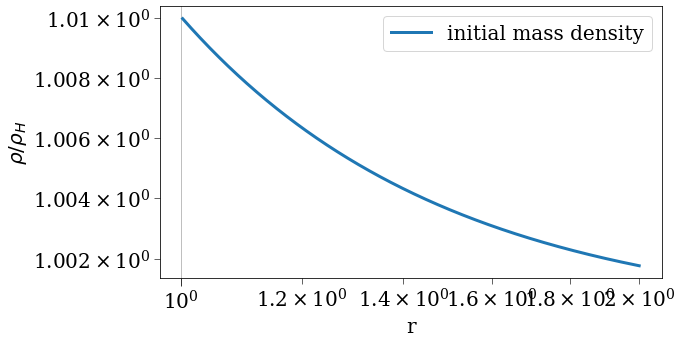

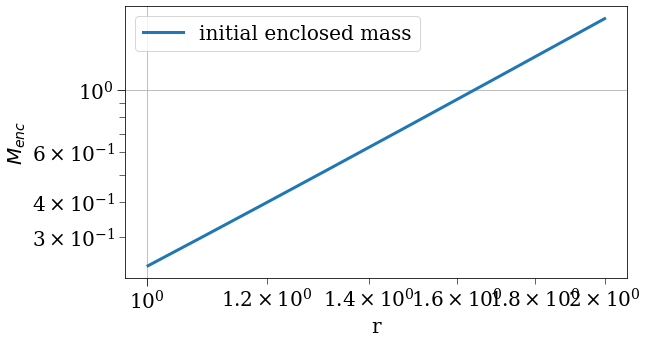

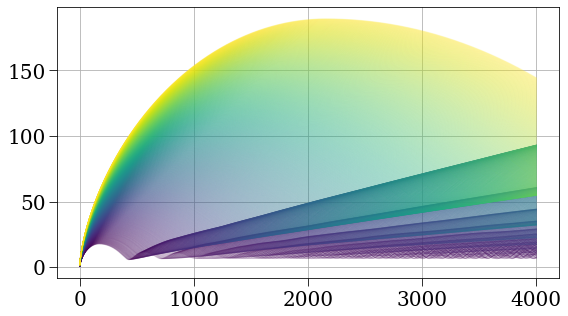

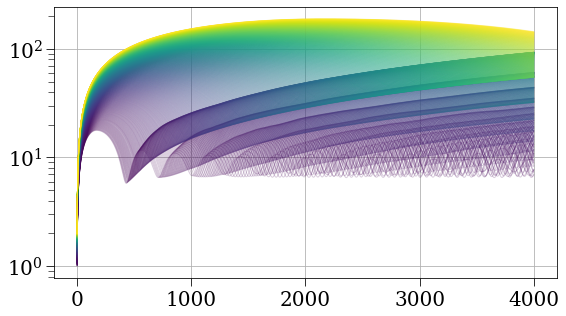

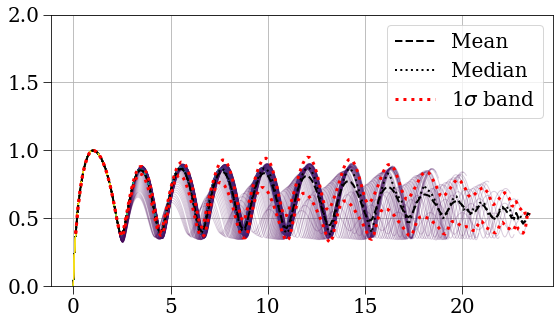

...

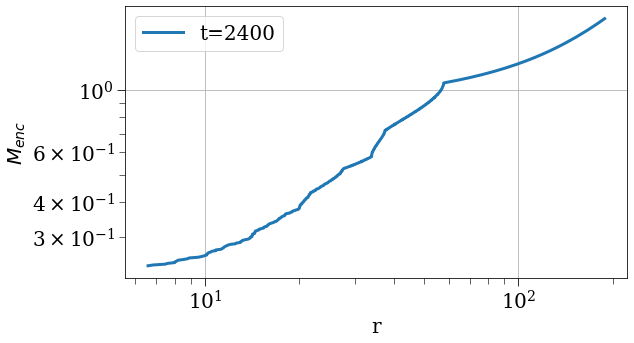

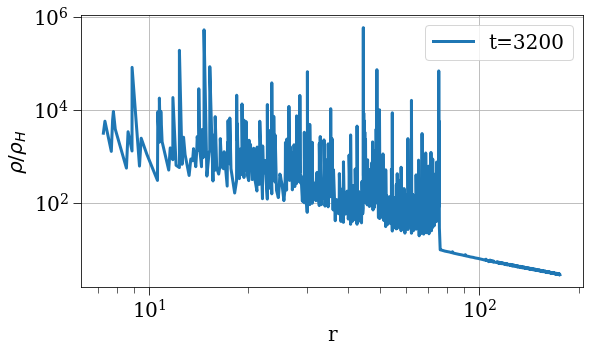

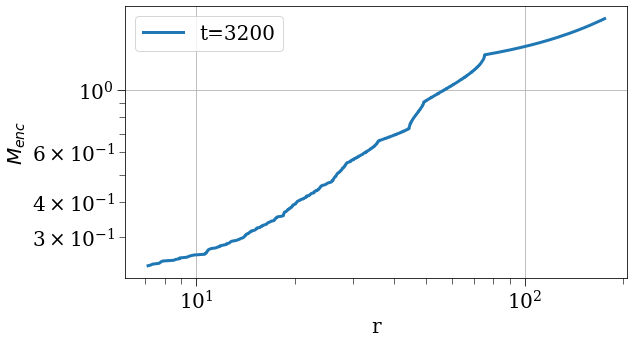

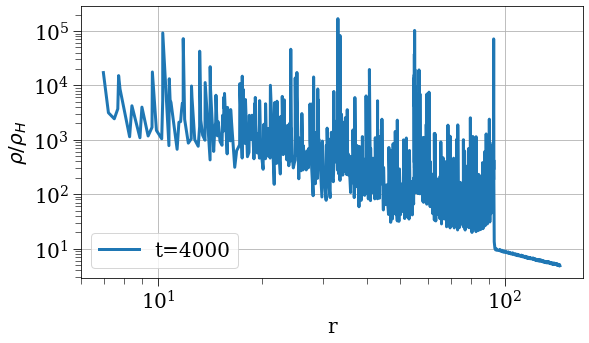

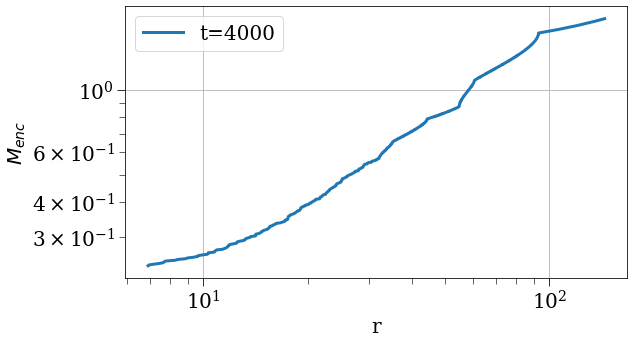

In [11]:
filename = f'runs/723-5.h5'
params, results = load_simulation_data(filename)
pprint(params)
plot_results(results, sc=None, params=params)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft_all',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.5,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': 'runs/723

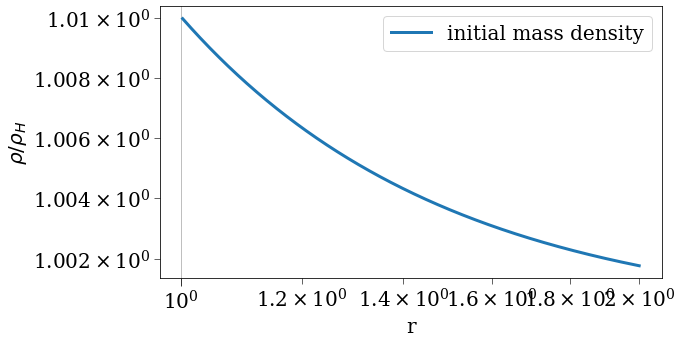

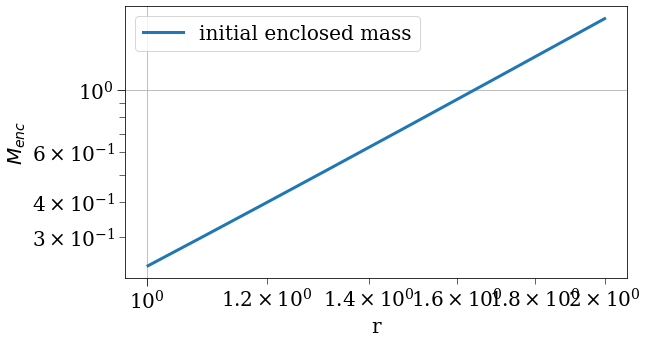

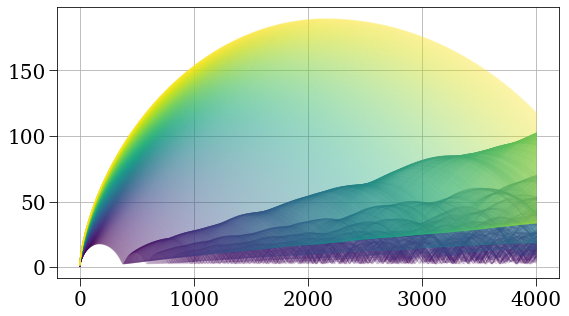

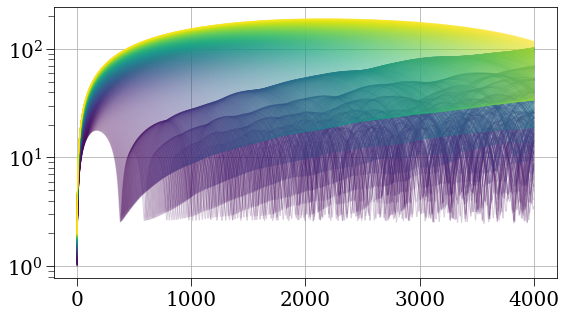

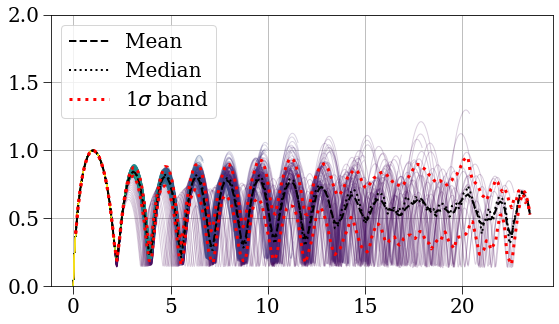

...

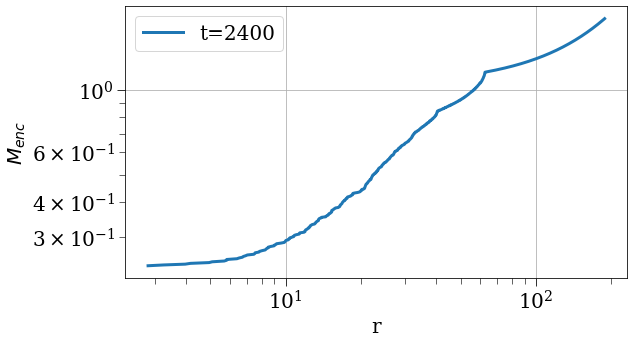

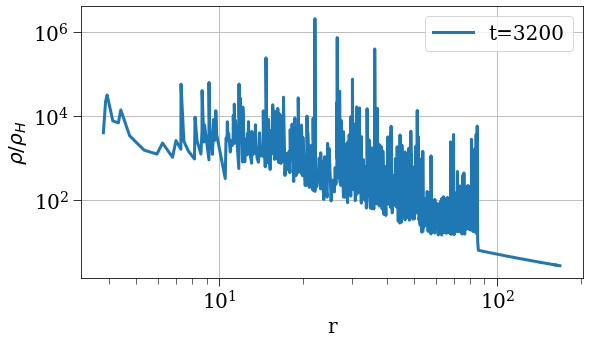

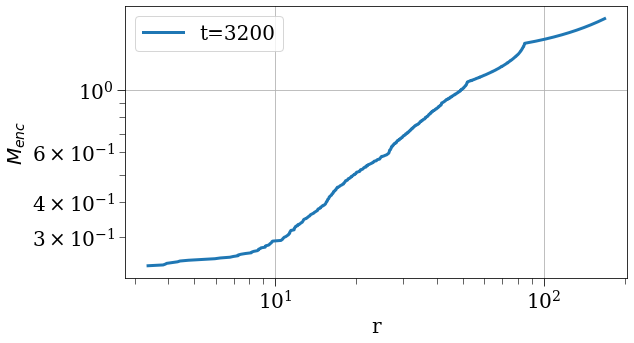

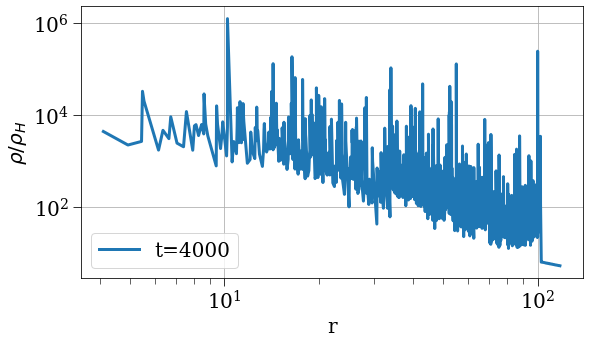

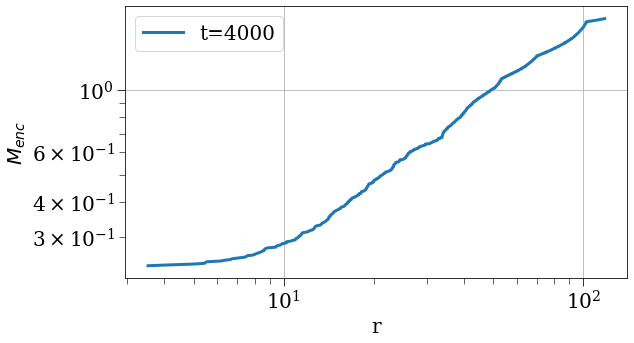

In [12]:
filename = f'runs/723-6.h5'
params, results = load_simulation_data(filename)
pprint(params)
plot_results(results, sc=None, params=params)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft_all',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.1,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.001,
 'save_dt': 1,
 'save_filename': 'runs/72

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/events.py:88: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


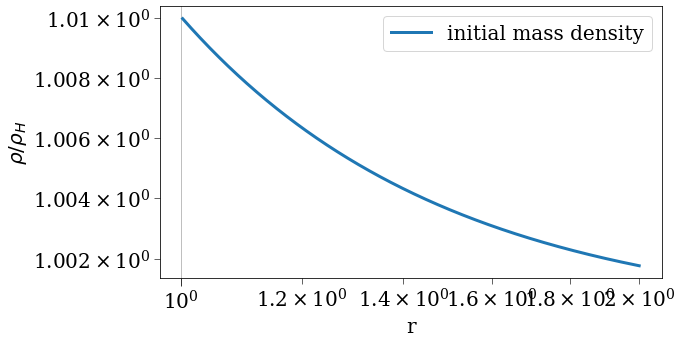

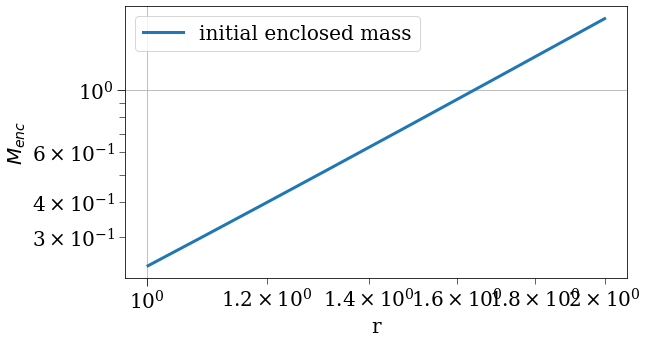

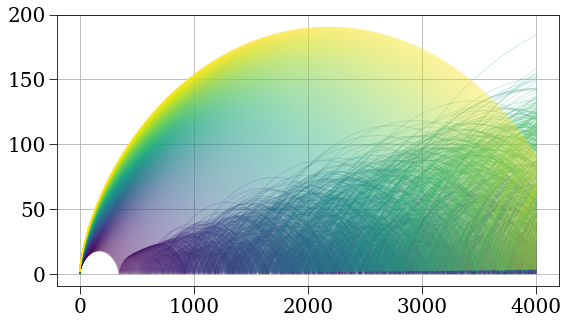

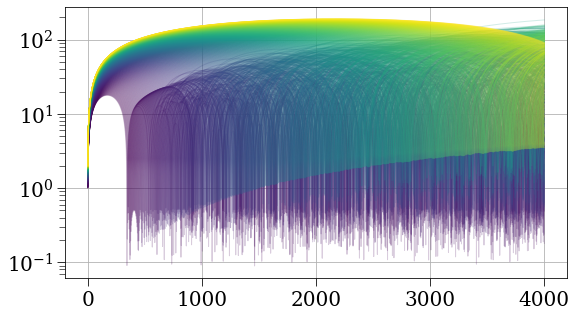

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


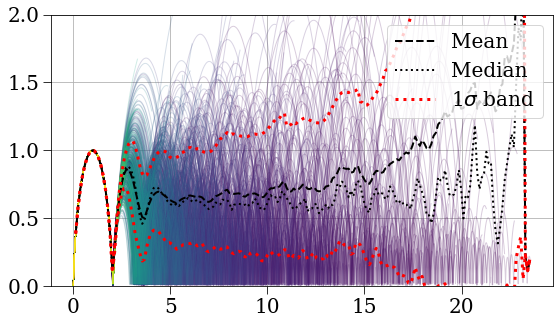

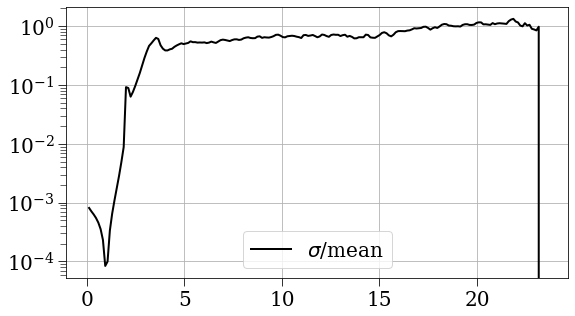

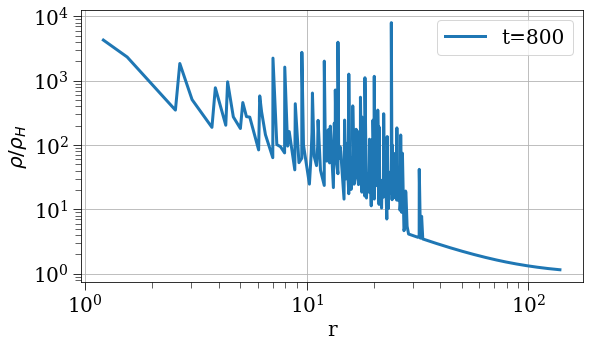

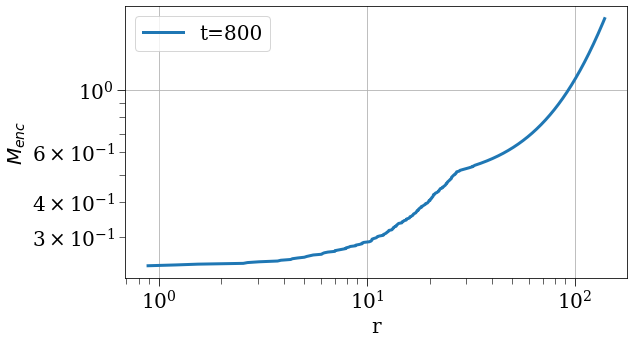

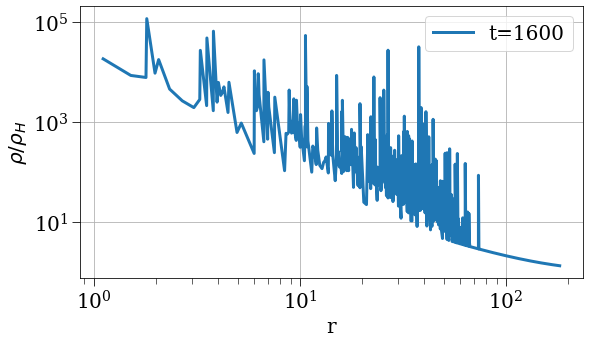

...

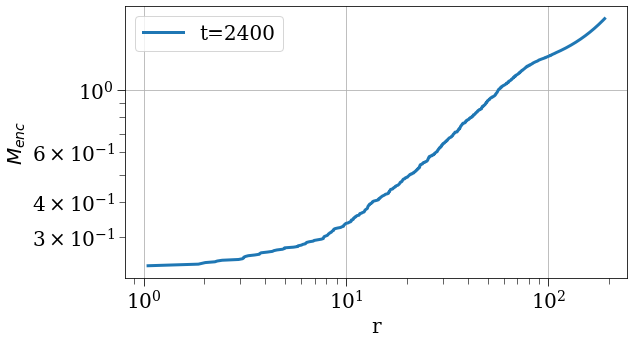

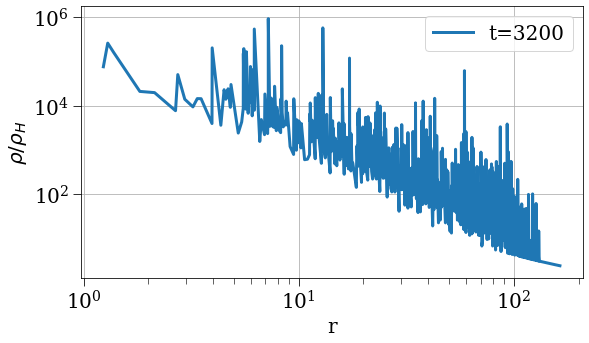

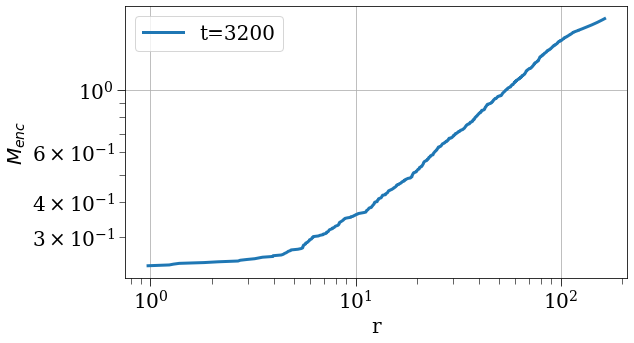

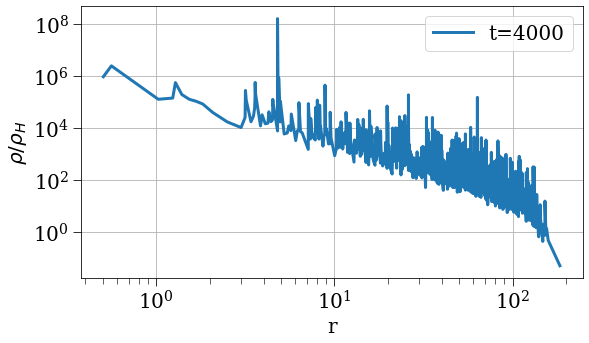

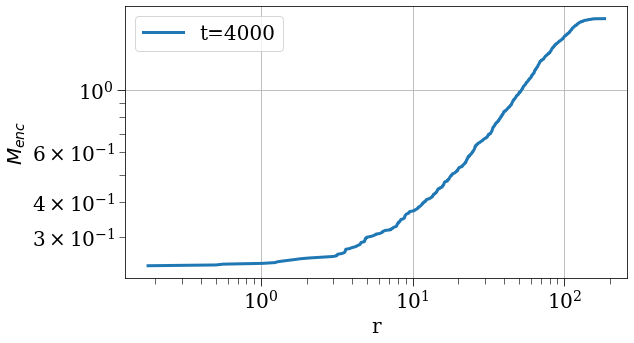

In [13]:
filename = f'runs/723-7.h5'
params, results = load_simulation_data(filename)
pprint(params)
plot_results(results, sc=None, params=params)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'grant_gmr_j_at_r_ta_soft_all',
 'ang_mom_strategy': 'zero',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.5,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_small': 1,
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.001,
 'save_dt': 1,
 'save_filename': 'runs/72

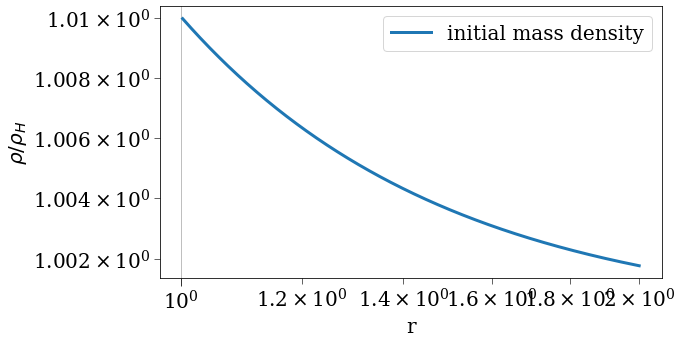

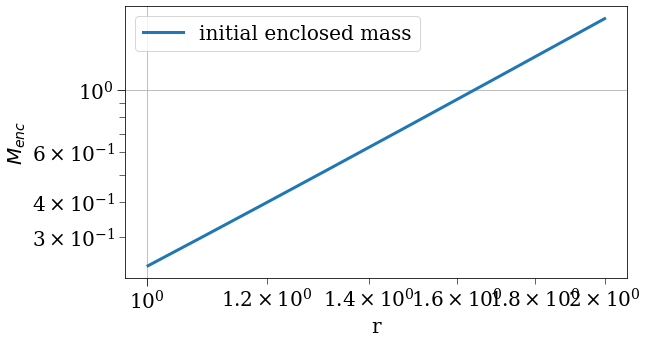

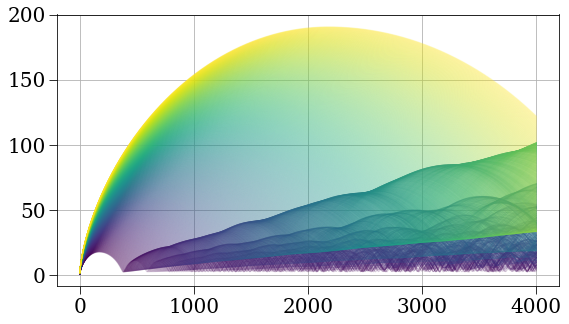

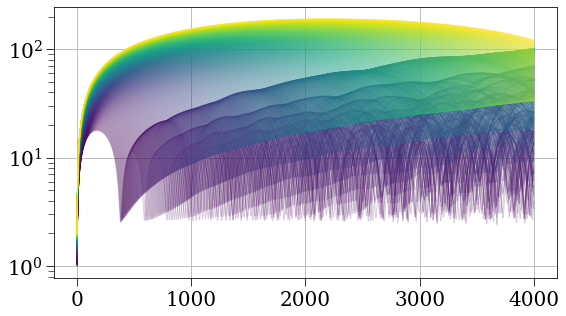

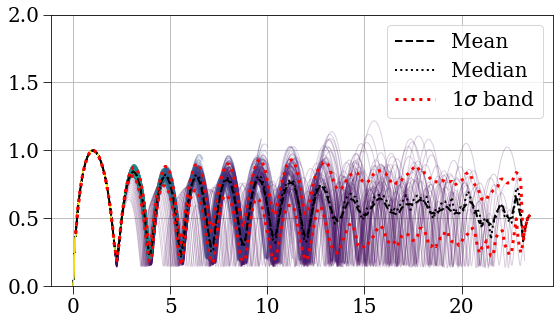

...

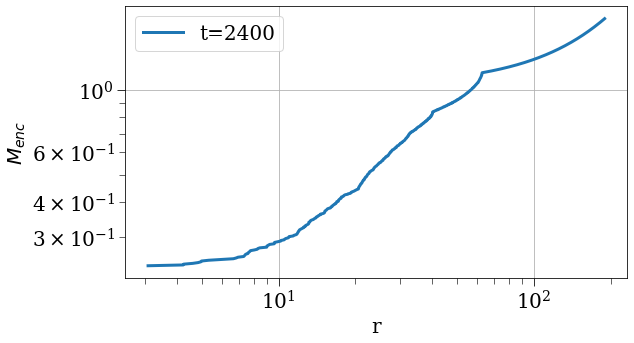

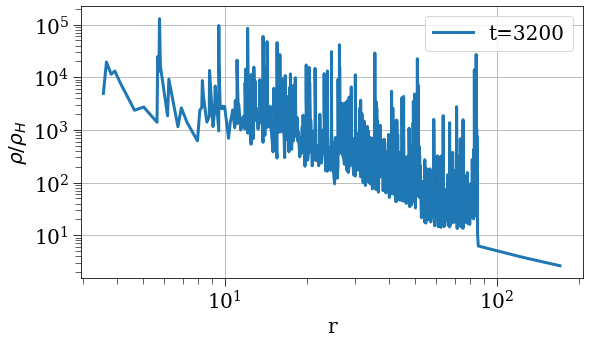

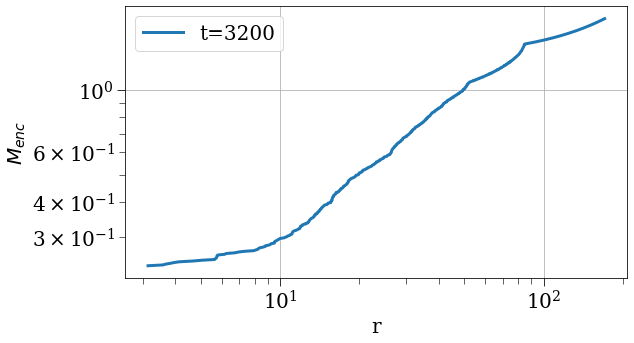

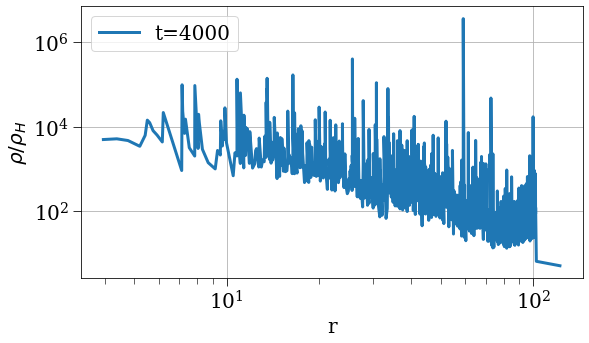

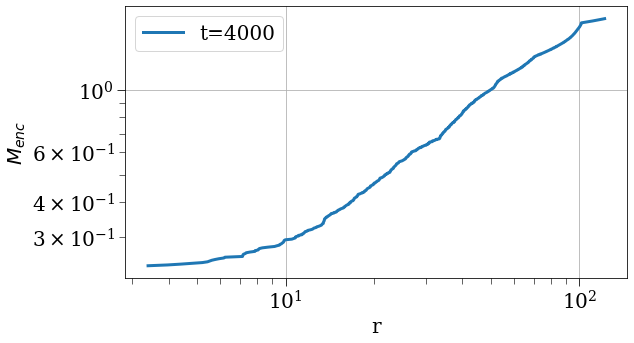

In [14]:
filename = f'runs/723-8.h5'
params, results = load_simulation_data(filename)
pprint(params)
plot_results(results, sc=None, params=params)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 10000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.00005,
 'r_max': 1.5,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 10,
 'save_filename': '/home/jsipple/one_d_spherical_coll

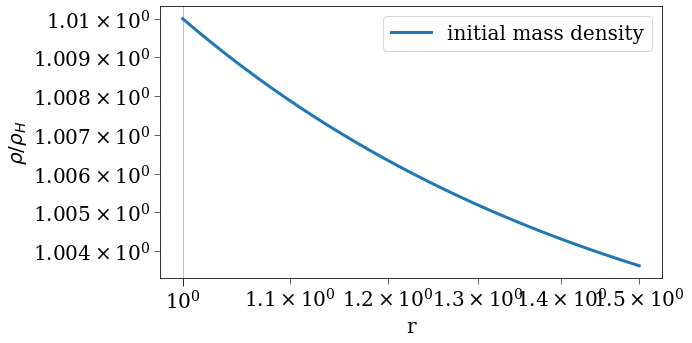

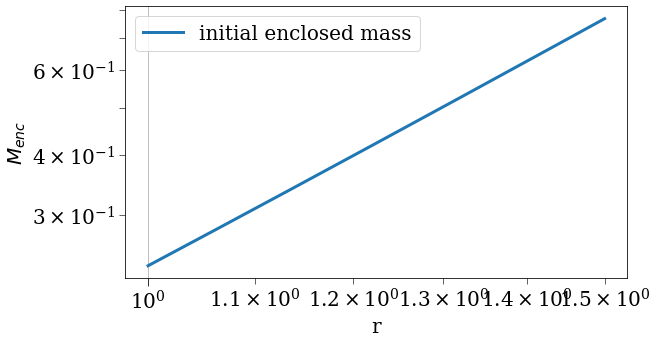

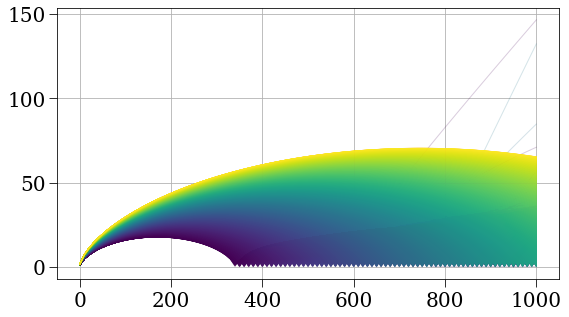

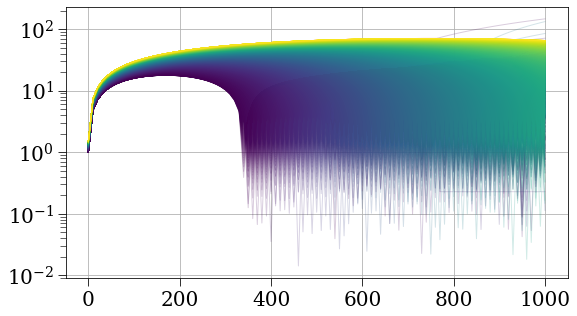

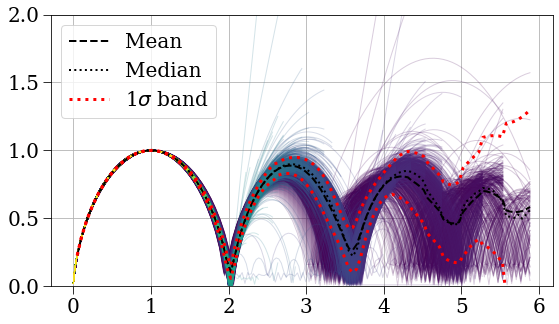

...

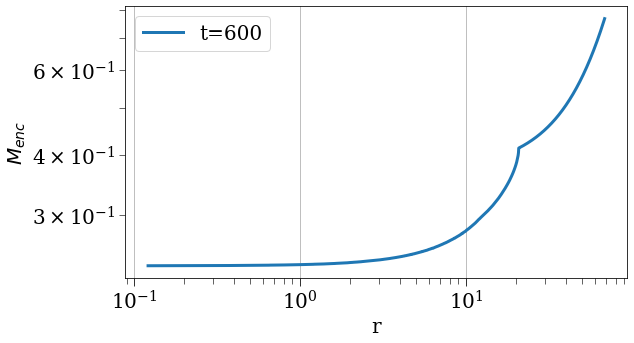

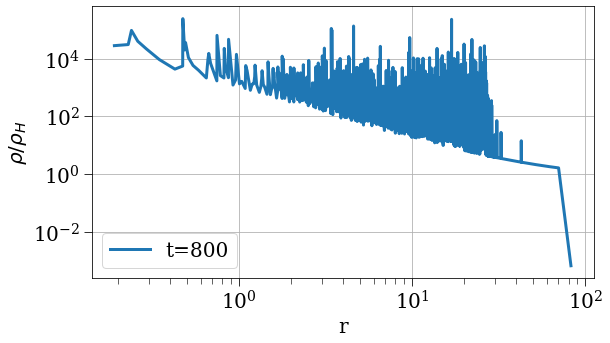

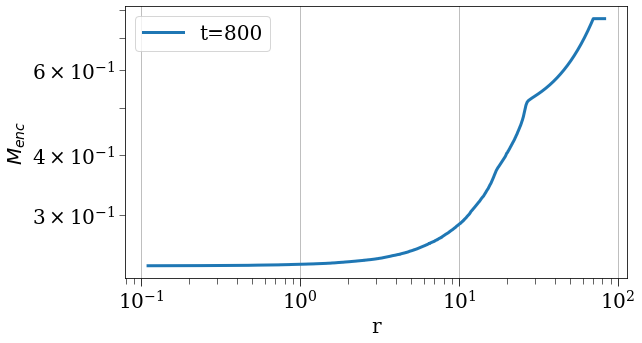

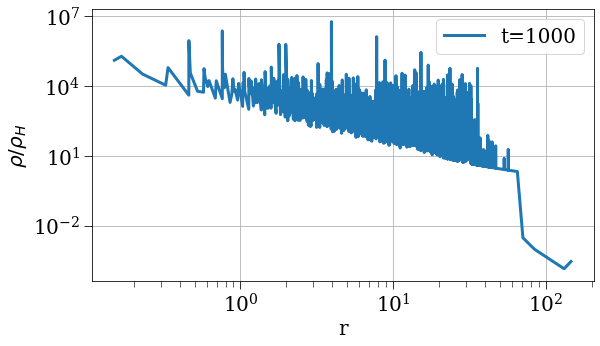

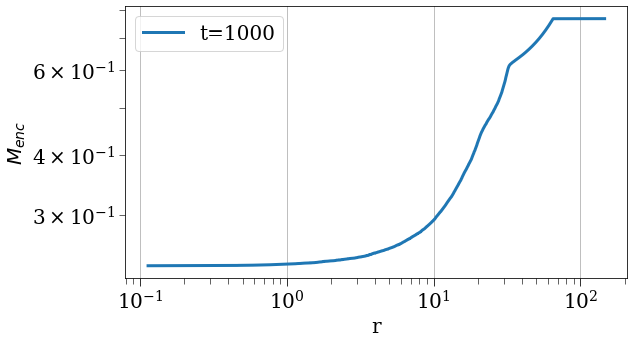

In [10]:
filename = f'runs/10k1k.h5'
params, results = load_simulation_data(filename)
pprint(params)
plot_results(results, sc=None, params=params)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.001,
 'save_dt': 10,
 'save_filename': '/home/jsipple/one_d_spherical_collapse

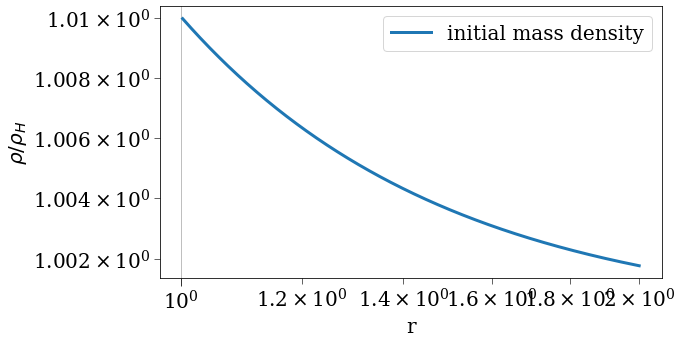

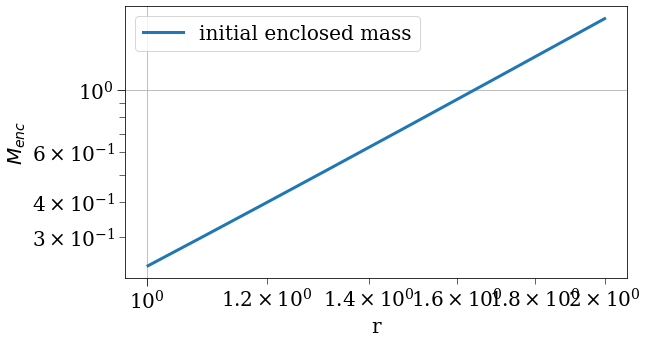

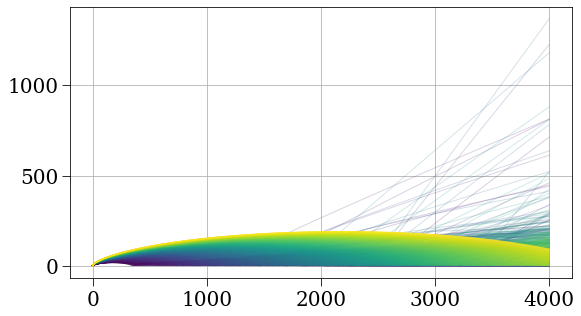

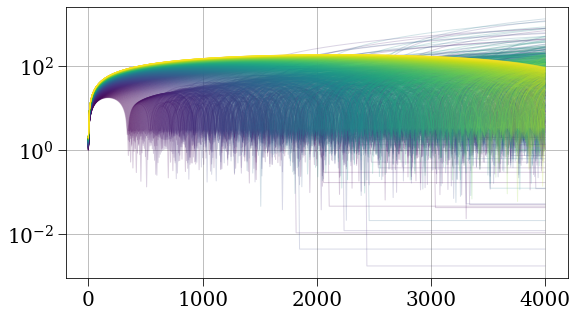

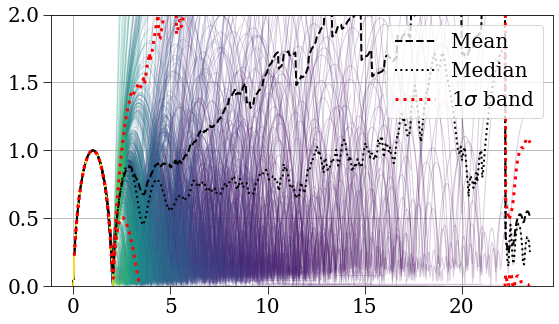

...

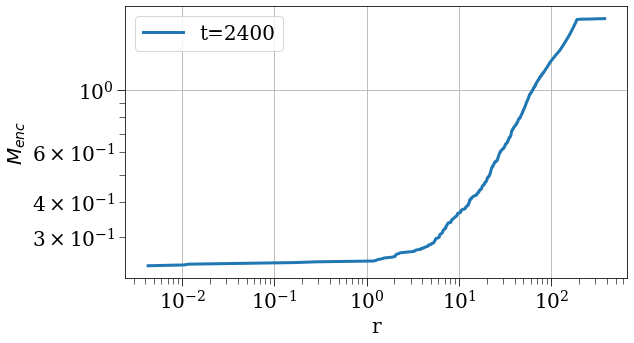

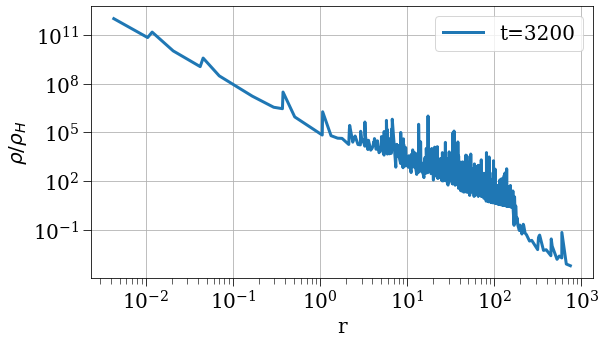

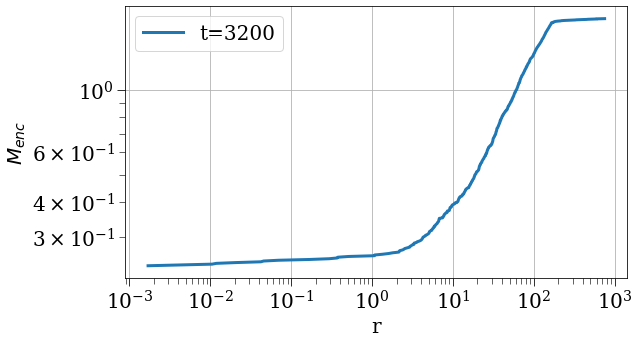

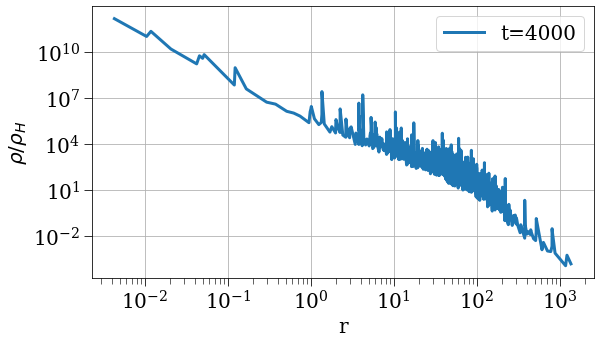

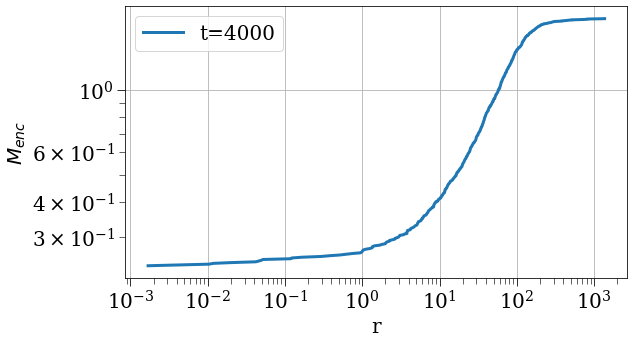

In [11]:
filename = f'runs/1k4ks3.h5'
params, results = load_simulation_data(filename)
pprint(params)
plot_results(results, sc=None, params=params)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 10000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.0001,
 'r_max': 2,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 10,
 'save_filename': '/home/jsipple/one_d_spherical_collaps

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/events.py:88: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


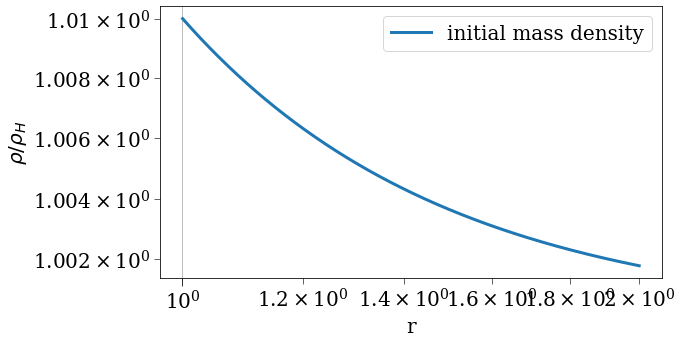

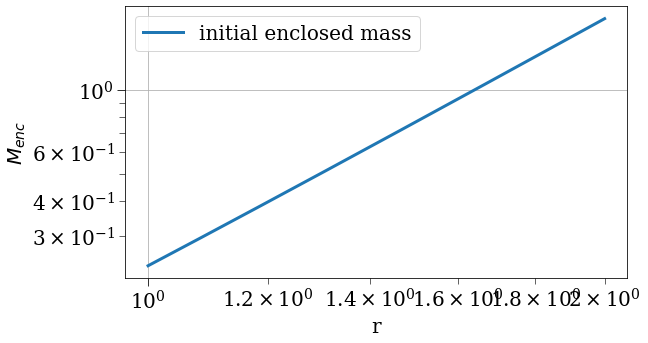

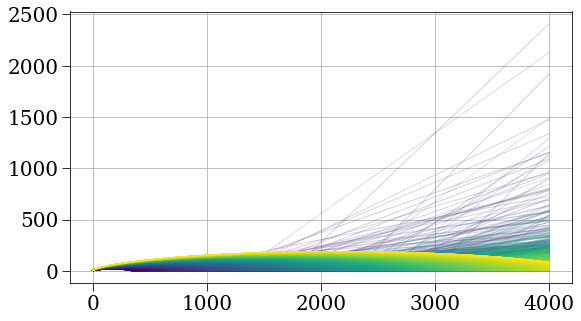

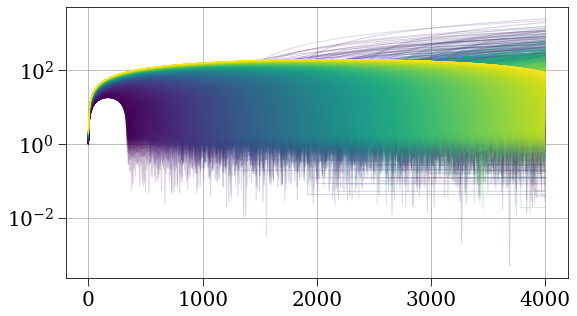

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


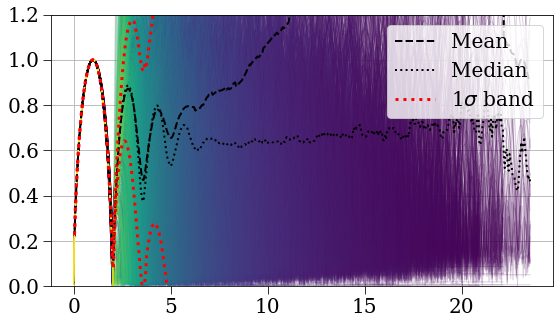

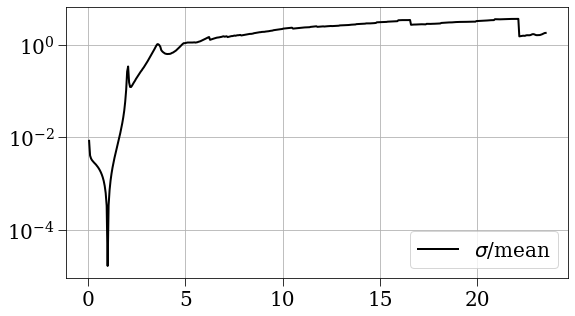

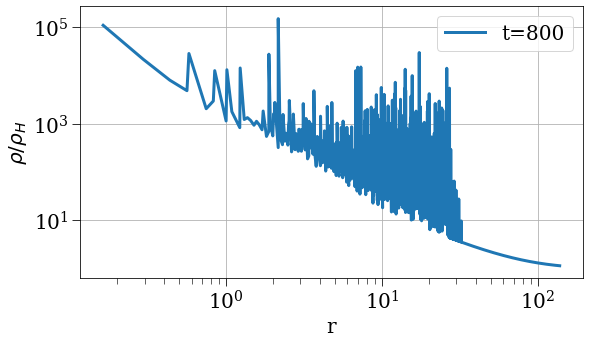

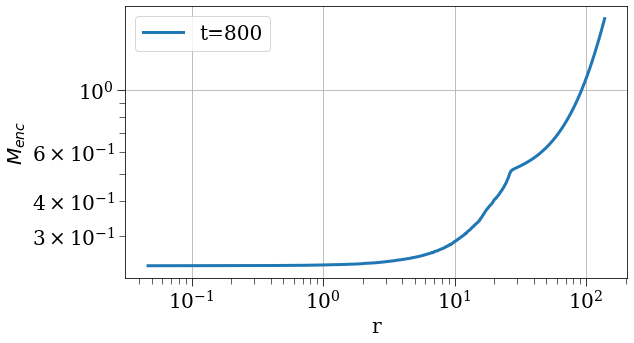

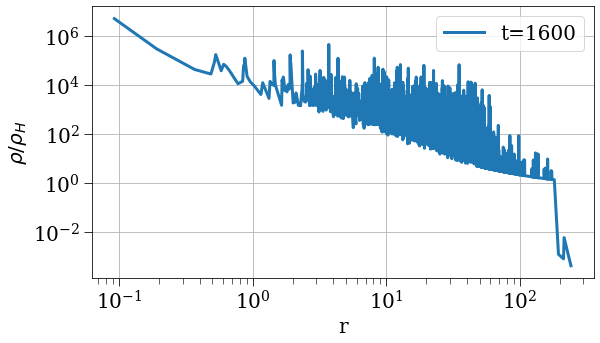

...

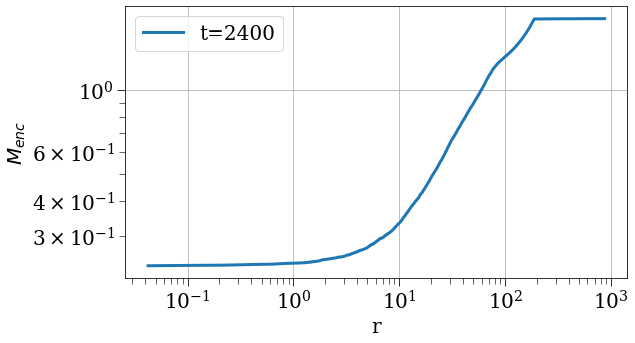

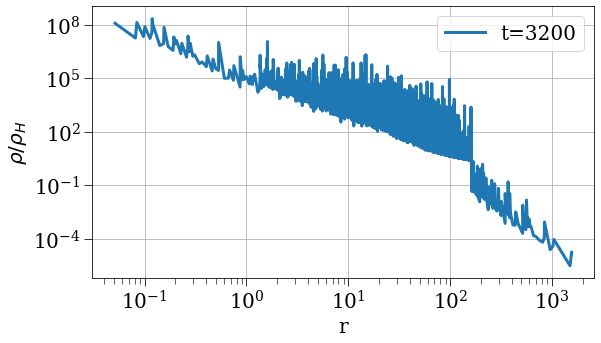

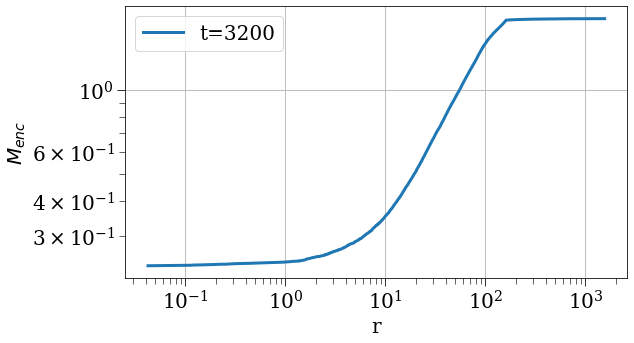

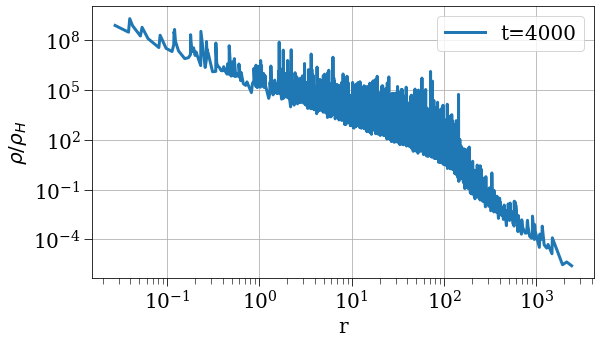

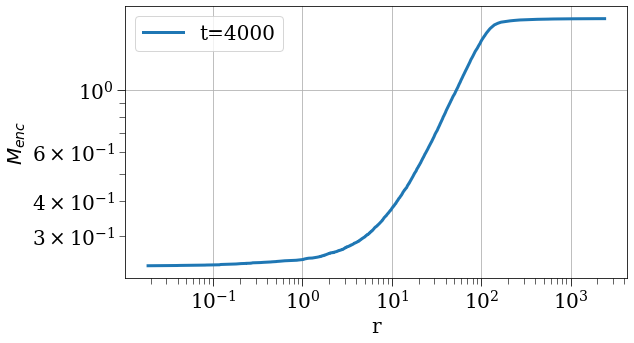

In [5]:
filename = f'runs/10k4k.h5'
params, results = load_simulation_data(filename)
pprint(params)
plot_results(results, sc=None, params=params)

{'G': 1,
 'H': 0.6666666666666666,
 'N': 1000,
 'accel_strategy': 'soft_grav',
 'ang_mom_strategy': 'const',
 'delta': 0.01,
 'density_strategy': 'background_plus_power_law',
 'deque_size': 0,
 'drhodr_strategy': 'finite_diff',
 'dt': 1e-05,
 'dt_min': 0,
 'energy_strategy': 'kin_grav_rot_absorbed',
 'gamma': -2.5,
 'hbar2_over_m2': 0,
 'initial_mass_strategy': 'integrated_mass',
 'initial_radius_strategy': 'equal_mass',
 'initial_v_strategy': 'hubble',
 'j_coef': 0.01,
 'm_enc_strategy': 'inclusive',
 'm_pert': 1,
 'next_save_time': 0,
 'num_crossing': 0,
 'point_mass': 0,
 'point_mass_strategy': 'rmin_rho_r',
 'polytropic_coef': 0,
 'polytropic_index': -1,
 'pressure_strategy': 'zero',
 'problematic_shell_strategy': 'energy',
 'r0_min': 1.0005,
 'r_max': 1.5,
 'r_min': 1,
 'r_min_strategy': 'nothing',
 'r_ta_strategy': 'r_ta_cycloid',
 'relaxation_time': 0,
 'rho_bar': 0.05305164769729845,
 'safety_factor': 0.01,
 'save_dt': 1,
 'save_filename': '/home/jsipple/one_d_spherical_collaps

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/events.py:88: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  func(*args, **kwargs)


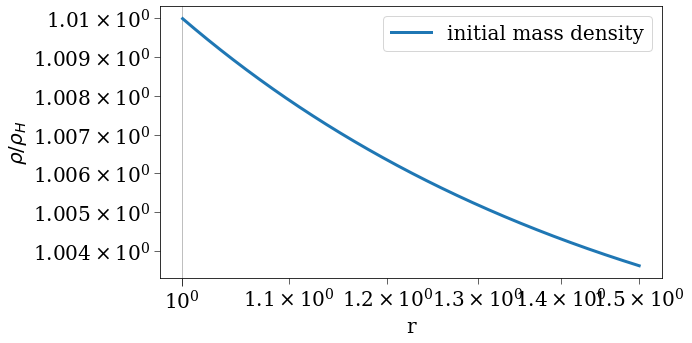

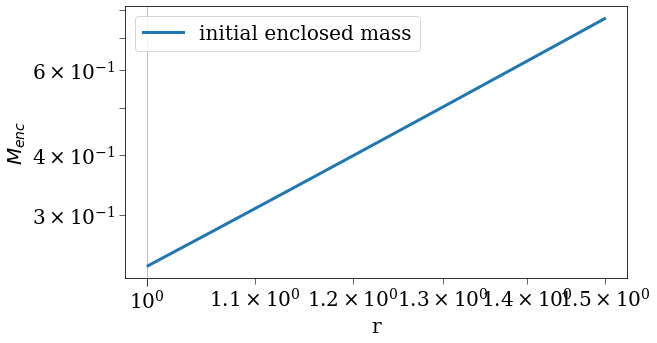

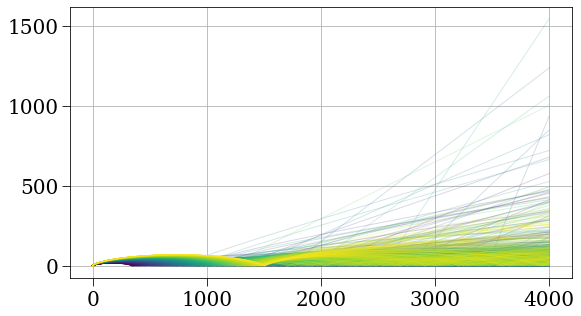

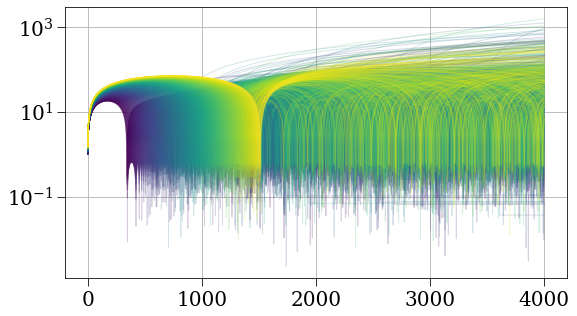

/home/jsipple/.conda/envs/jsipple/lib/python3.7/site-packages/IPython/core/pylabtools.py:128: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


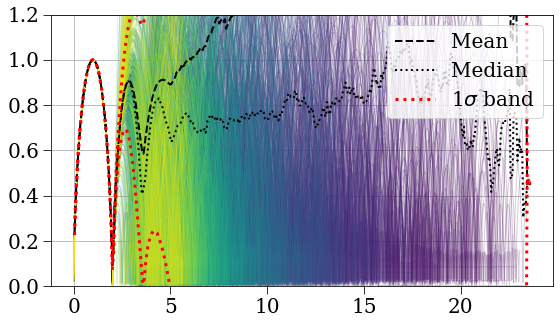

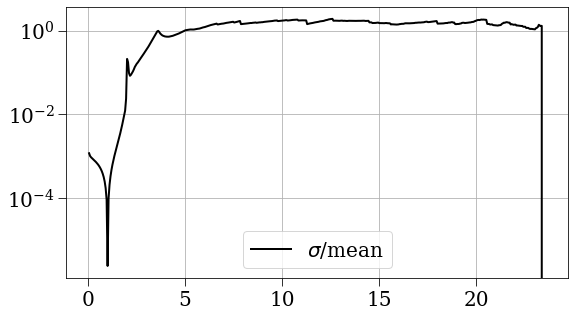

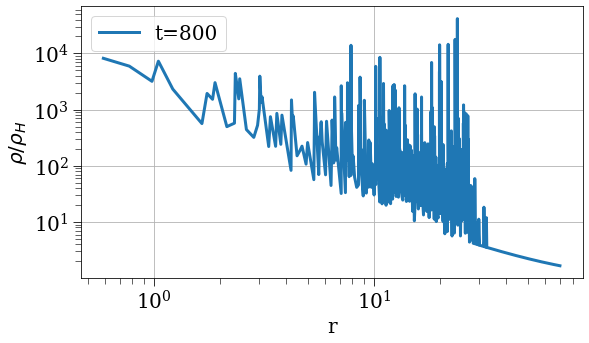

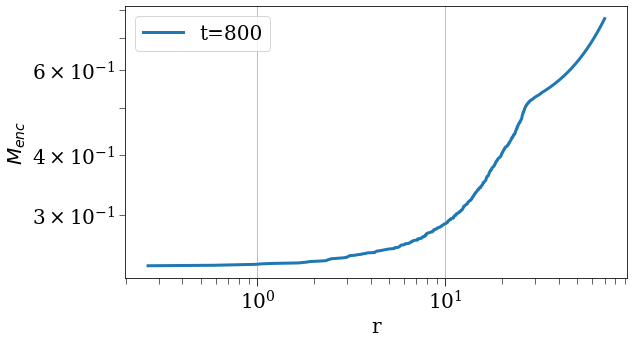

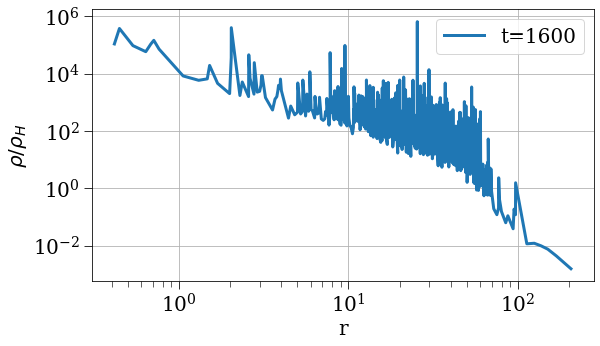

...

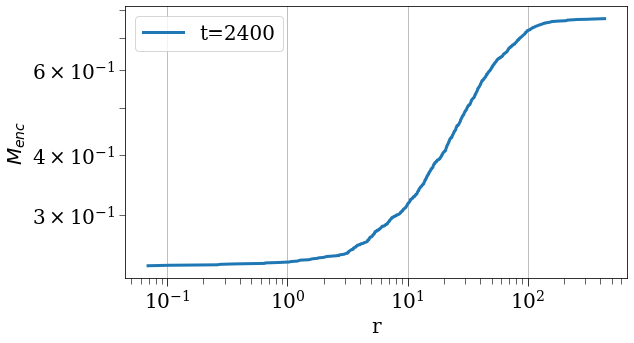

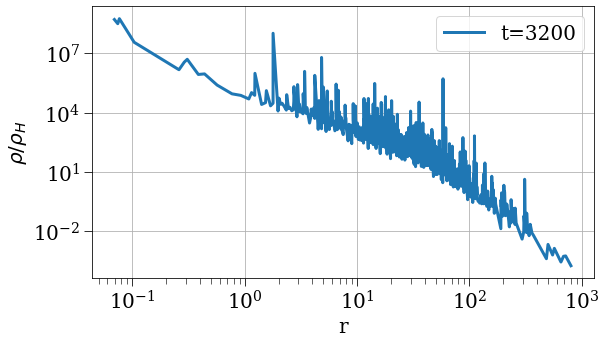

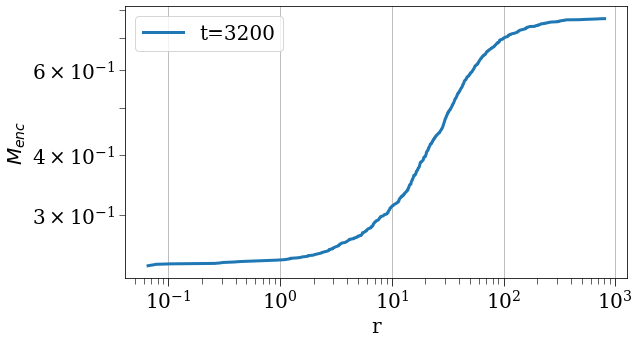

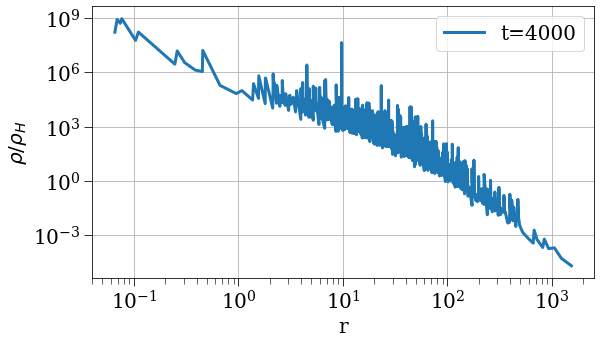

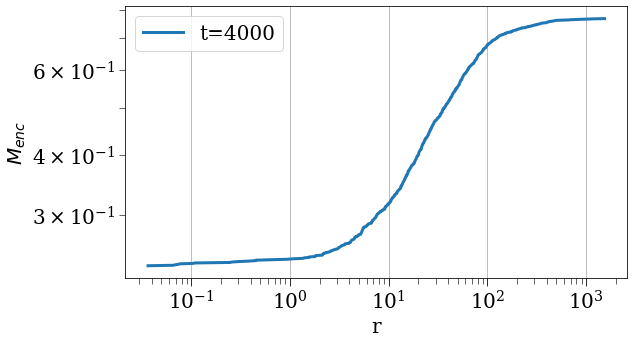

In [5]:
filename = f'runs/1k4kdc.h5'
params, results = load_simulation_data(filename)
pprint(params)
plot_results(results, sc=None, params=params)